# HR Analytics Project- Understanding the Attrition in HR

# 1. Introduction

# Project Description
Every year a lot of companies hire a number of employees. The companies invest time and money in training those employees, not just this but there are training programs within the companies for their existing employees as well. The aim of these programs is to increase the effectiveness of their employees. But where HR Analytics fit in this? and is it just about improving the performance of employees?


# HR Analytics
Human resource analytics (HR analytics) is an area in the field of analytics that refers to applying analytic processes to the human resource department of an organization in the hope of improving employee performance and therefore getting a better return on investment. HR analytics does not just deal with gathering data on employee efficiency. Instead, it aims to provide insight into each process by gathering data and then using it to make relevant decisions about how to improve these processes.


# Attrition in HR
Attrition in human resources refers to the gradual loss of employees overtime. In general, relatively high attrition is problematic for companies. HR professionals often assume a leadership role in designing company compensation programs, work culture, and motivation systems that help the organization retain top employees.
How does Attrition affect companies? and how does HR Analytics help in analyzing attrition? We will discuss the first question here and for the second question, we will write the code and try to understand the process step by step.


# Attrition affecting Companies
A major problem in high employee attrition is its cost to an organization. Job postings, hiring processes, paperwork, and new hire training are some of the common expenses of losing employees and replacing them. Additionally, regular employee turnover prohibits your organization from increasing its collective knowledge base and experience over time. This is especially concerning if your business is customer-facing, as customers often prefer to interact with familiar people. Errors and issues are more likely if you constantly have new workers.



# Objective:-
The objective of this project is to utilize HR analytics techniques to gain insights into employee attrition within organizations. By analyzing historical data and relevant predictors, the project aims to identify patterns, root causes, and potential predictors of attrition. Additionally, the project seeks to develop predictive models to forecast future attrition and evaluate the effectiveness of retention strategies.

# Project Summary:
Employee attrition poses significant challenges and costs to organizations, impacting productivity, morale, and customer satisfaction. This project focuses on leveraging HR analytics to address this issue comprehensively.

1. **Data Collection and Preprocessing:** Gather relevant data sources, including employee demographics, performance metrics, engagement surveys, exit interviews, and historical turnover rates. Clean and preprocess the data to ensure quality and consistency.

2. **Exploratory Data Analysis (EDA):** Conduct exploratory data analysis to gain initial insights into the dataset. Explore correlations, trends, and distributions related to attrition and potential predictors such as job satisfaction, compensation, career growth opportunities, and work-life balance.

3. **Feature Engineering:** Extract and engineer relevant features from the dataset to enhance predictive modeling. This may involve creating new variables, encoding categorical variables, and scaling numerical features.

4. **Model Development:** Develop predictive models using machine learning algorithms such as logistic regression, random forests, or gradient boosting. Train the models on historical data to predict employee attrition.

5. **Model Evaluation:** Evaluate the performance of the predictive models using appropriate evaluation metrics such as accuracy, precision, recall, and F1-score. Validate the models using techniques such as cross-validation to ensure generalizability.

6. **Predictive Modeling and Interpretation:** Utilize the trained models to forecast future attrition rates and identify at-risk employees. Interpret model predictions and feature importance to understand the drivers of attrition within the organization.

7. **Retention Strategy Evaluation:** Assess the effectiveness of retention strategies and interventions implemented based on HR analytics insights. Monitor key metrics over time to track changes in attrition rates and employee engagement.

8. **Recommendations and Reporting:** Provide actionable recommendations to HR professionals and organizational leaders based on the findings of the HR analytics analysis. Summarize the project findings in a comprehensive report, including visualizations, insights, and recommendations for mitigating employee attrition.

# Output:-
Attrition prediction serves as the target variable in this project. The machine learning model aims to predict employee attrition within organizations based on various factors such as demographics, performance metrics, engagement surveys, and historical turnover rates. This predicted attrition rate serves as the primary outcome of the predictive model, providing valuable insights into potential turnover risks and enabling proactive measures to retain top talent within the organization.

# 2. Data Cleaning

# Import important library :

In [1]:
import warnings
warnings.simplefilter("ignore")
import joblib

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import scipy.stats as stats
from scipy.stats import zscore

from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb

from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV 

In [2]:
df= pd.read_csv(r"C:\Users\JAVED\Saved Games\WA_Fn-UseC_-HR-Employee-Attrition.csv")

In [3]:
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


In [4]:
df.head()#first 5 rows

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [5]:
df.tail()#last 5 rows

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8
1469,34,No,Travel_Rarely,628,Research & Development,8,3,Medical,1,2068,...,1,80,0,6,3,4,4,3,1,2


# Exploratory Data Analysis (EDA)

In [6]:
df.shape

(1470, 35)

The dataset consists of 1470 rows and 35 columns, which include both features and labels.

In [7]:
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

No Missing values were detected in the columns.

In [8]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

In [9]:
df.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

The dataset comprises integers and object data types.

In [10]:
obj_col=[]

for i in df.columns:
    if df[i].dtype=='object':
        obj_col.append(i)

In [11]:
obj_col

['Attrition',
 'BusinessTravel',
 'Department',
 'EducationField',
 'Gender',
 'JobRole',
 'MaritalStatus',
 'Over18',
 'OverTime']

In [12]:
num_col=[]

for i in df.columns:
    if df[i].dtype=='int64':
        num_col.append(i)

In [13]:
num_col

['Age',
 'DailyRate',
 'DistanceFromHome',
 'Education',
 'EmployeeCount',
 'EmployeeNumber',
 'EnvironmentSatisfaction',
 'HourlyRate',
 'JobInvolvement',
 'JobLevel',
 'JobSatisfaction',
 'MonthlyIncome',
 'MonthlyRate',
 'NumCompaniesWorked',
 'PercentSalaryHike',
 'PerformanceRating',
 'RelationshipSatisfaction',
 'StandardHours',
 'StockOptionLevel',
 'TotalWorkingYears',
 'TrainingTimesLastYear',
 'WorkLifeBalance',
 'YearsAtCompany',
 'YearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager']

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [15]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [16]:
df.duplicated().sum()

0

In the dataset, there are no duplicate values present.

In [17]:
# checking the number of unique values in each column
df.nunique().to_frame("no.of unique values")

,no.of unique values
Age,43
Attrition,2
BusinessTravel,3
DailyRate,886
Department,3
DistanceFromHome,29
Education,5
EducationField,6
EmployeeCount,1
EmployeeNumber,1470


In [18]:
# checking the value counts of each column
for i in df.columns:
    print(df[i].value_counts())
    print('/n')

Age
35    78
34    77
36    69
31    69
29    68
32    61
30    60
33    58
38    58
40    57
37    50
27    48
28    48
42    46
39    42
45    41
41    40
26    39
44    33
46    33
43    32
50    30
25    26
24    26
49    24
47    24
55    22
51    19
53    19
48    19
54    18
52    18
22    16
56    14
23    14
58    14
21    13
20    11
59    10
19     9
18     8
60     5
57     4
Name: count, dtype: int64
/n
Attrition
No     1233
Yes     237
Name: count, dtype: int64
/n
BusinessTravel
Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: count, dtype: int64
/n
DailyRate
691     6
408     5
530     5
1329    5
1082    5
       ..
650     1
279     1
316     1
314     1
628     1
Name: count, Length: 886, dtype: int64
/n
Department
Research & Development    961
Sales                     446
Human Resources            63
Name: count, dtype: int64
/n
DistanceFromHome
2     211
1     208
10     86
9      85
3      84
7      84
8      80
5      65
4     

From the above result, it's evident that there are no zero values or white spaces present in the dataset.

In [19]:
nul_val=df.isnull()

In [20]:
#returns counts of values where True if null
for column in nul_val.columns.values.tolist():
    print(column)
    print (nul_val[column].value_counts())
    print("")  

Age
Age
False    1470
Name: count, dtype: int64

Attrition
Attrition
False    1470
Name: count, dtype: int64

BusinessTravel
BusinessTravel
False    1470
Name: count, dtype: int64

DailyRate
DailyRate
False    1470
Name: count, dtype: int64

Department
Department
False    1470
Name: count, dtype: int64

DistanceFromHome
DistanceFromHome
False    1470
Name: count, dtype: int64

Education
Education
False    1470
Name: count, dtype: int64

EducationField
EducationField
False    1470
Name: count, dtype: int64

EmployeeCount
EmployeeCount
False    1470
Name: count, dtype: int64

EmployeeNumber
EmployeeNumber
False    1470
Name: count, dtype: int64

EnvironmentSatisfaction
EnvironmentSatisfaction
False    1470
Name: count, dtype: int64

Gender
Gender
False    1470
Name: count, dtype: int64

HourlyRate
HourlyRate
False    1470
Name: count, dtype: int64

JobInvolvement
JobInvolvement
False    1470
Name: count, dtype: int64

JobLevel
JobLevel
False    1470
Name: count, dtype: int64

JobRole
Job

In [21]:
#Checking null values-
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [22]:
df.isnull().sum().sum()

0

<Axes: >

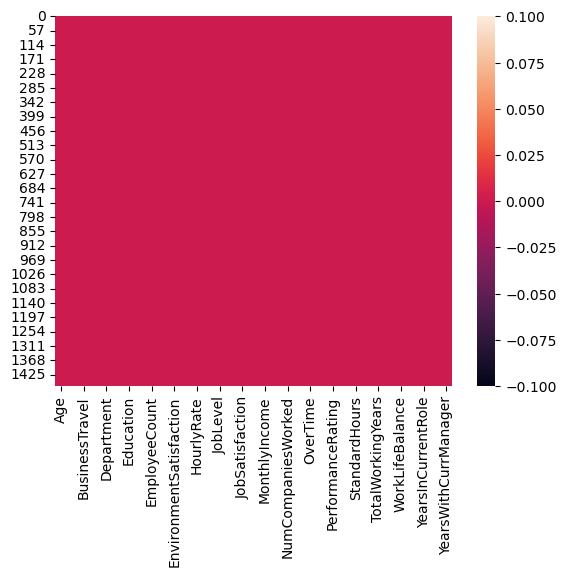

In [23]:
sns.heatmap(df.isnull())

In the dataset, there are no null values present.

# 3. Data Visualization

In [24]:
df.shape

(1470, 35)

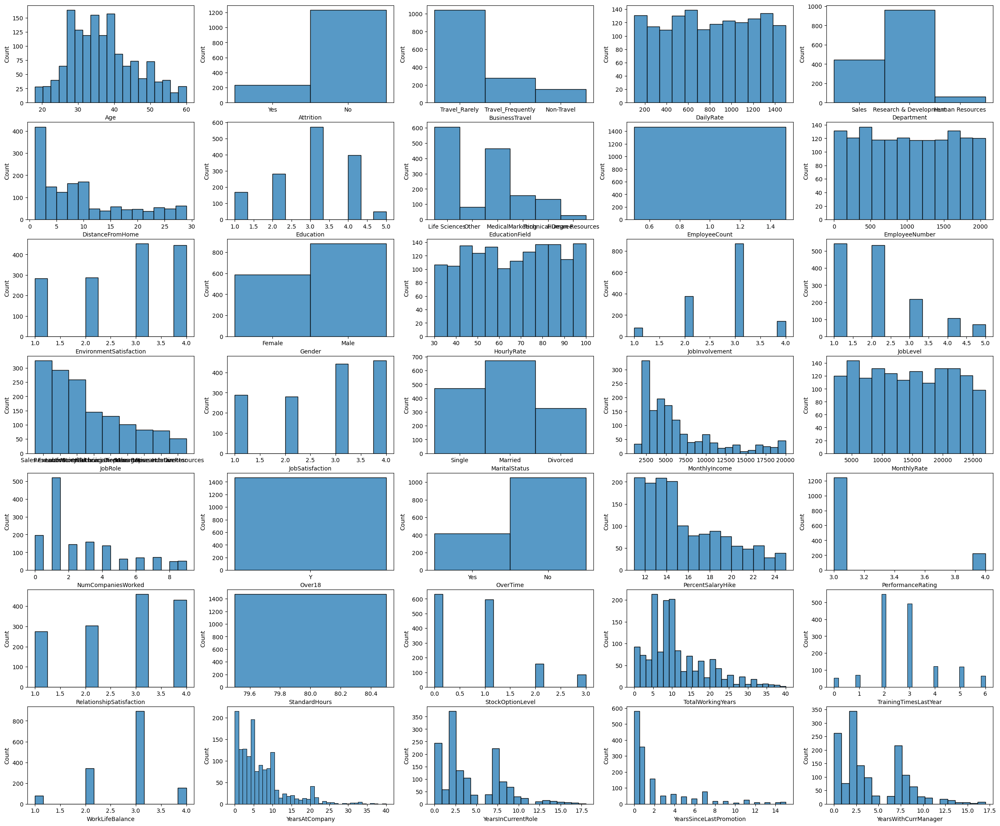

In [25]:
plt.figure(figsize=(30,25))
plotnumber=1

for i in df.columns:
    if plotnumber<=35:
        ax=plt.subplot(7,5,plotnumber)
        sns.histplot(df[i])
        plt.xlabel(i)
    plotnumber+=1
plt.show() 

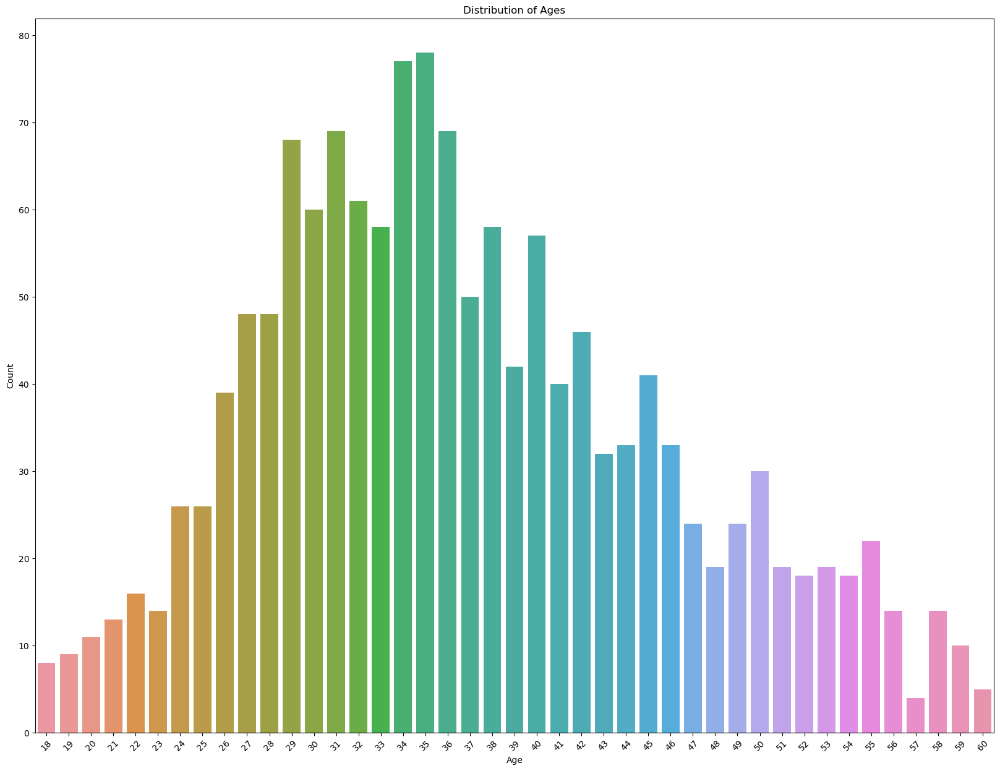

In [26]:
plt.figure(figsize=(20,15))
sns.countplot(x='Age', data=df)
plt.title('Distribution of Ages')
plt.xlabel('Age')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()



Most employees fall within the age range of 26 to 46 years.

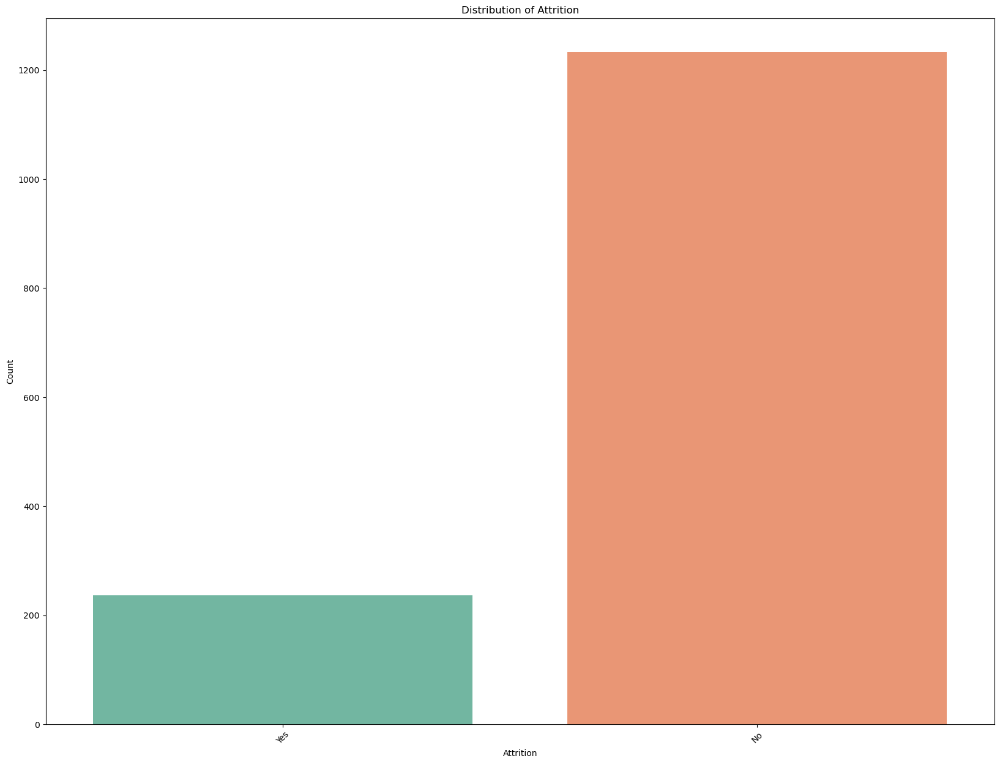

In [27]:
plt.figure(figsize=(20,15))
sns.countplot(x='Attrition', data=df, palette='Set2')
plt.title('Distribution of Attrition')
plt.xlabel('Attrition')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()


There's a significant class imbalance with the category "No attrition" showing a notably higher count.

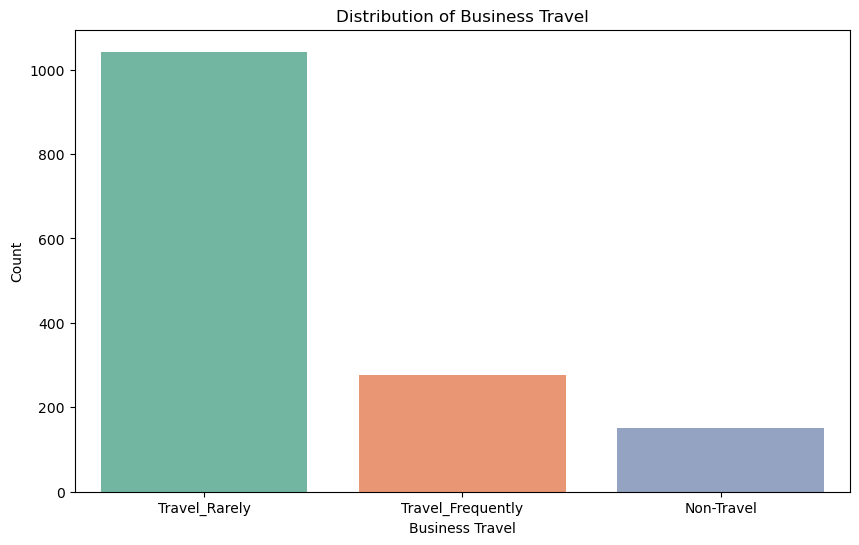

In [28]:
plt.figure(figsize=(10, 6))
sns.countplot(x='BusinessTravel', data=df, palette='Set2')
plt.title('Distribution of Business Travel')
plt.xlabel('Business Travel')
plt.ylabel('Count')
plt.show()



The count of employees is notably high in the "Travel_Rarely" category.

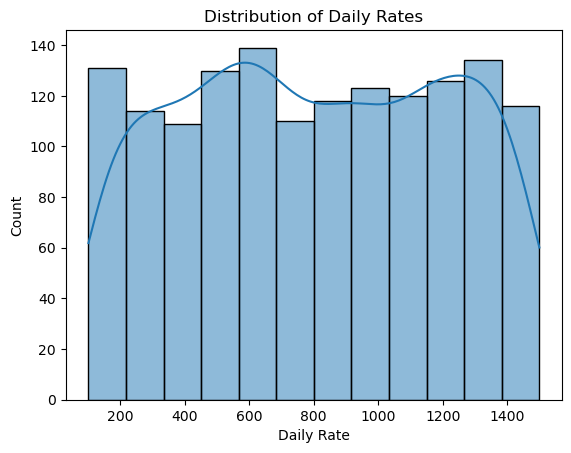

In [29]:
sns.histplot(df['DailyRate'], kde=True)
plt.title('Distribution of Daily Rates')
plt.xlabel('Daily Rate')
plt.ylabel('Count')
plt.show()


The highest count of employees falls within the 500-700 daily rate range. Conversely, employees with daily rates between 350-450 and 700-800 are the least common.

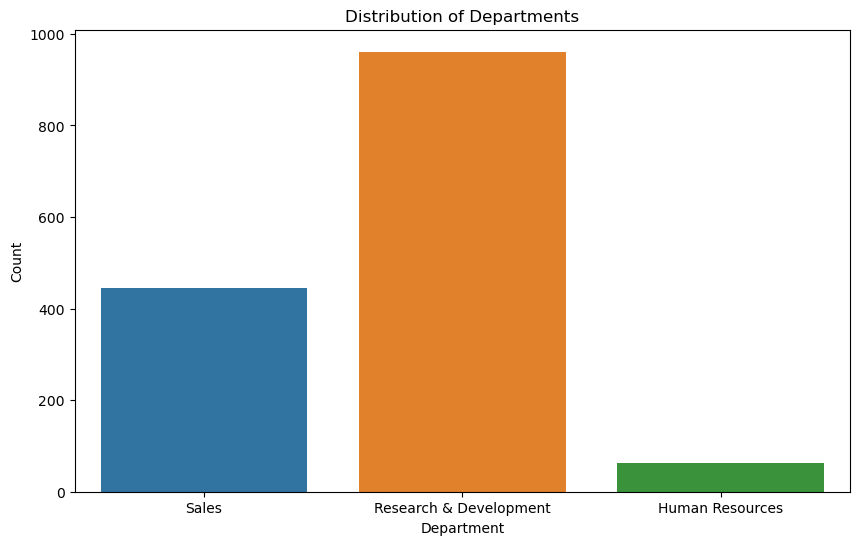

In [30]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Department', data=df)
plt.title('Distribution of Departments')
plt.xlabel('Department')
plt.ylabel('Count')
plt.show()


The count of employees in the Research & Development department is the highest, while the count is lowest in the Human Resources department.

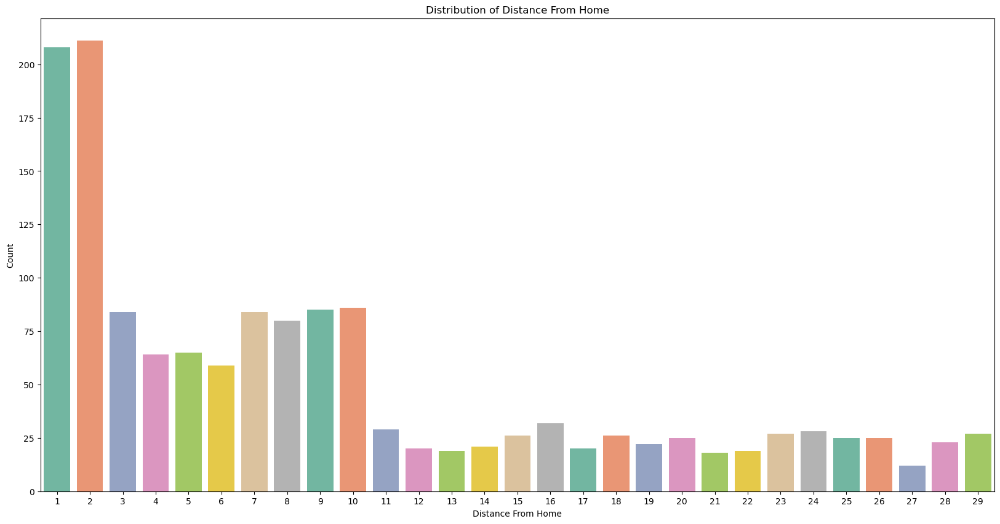

In [31]:
plt.figure(figsize=(20,10))
sns.countplot(x='DistanceFromHome', data=df, palette='Set2')
plt.title('Distribution of Distance From Home')
plt.xlabel('Distance From Home')
plt.ylabel('Count')
plt.show()



The highest count of employees is associated with a distance from home of 2 kilometers, while the lowest count is linked to a distance of 27 kilometers.

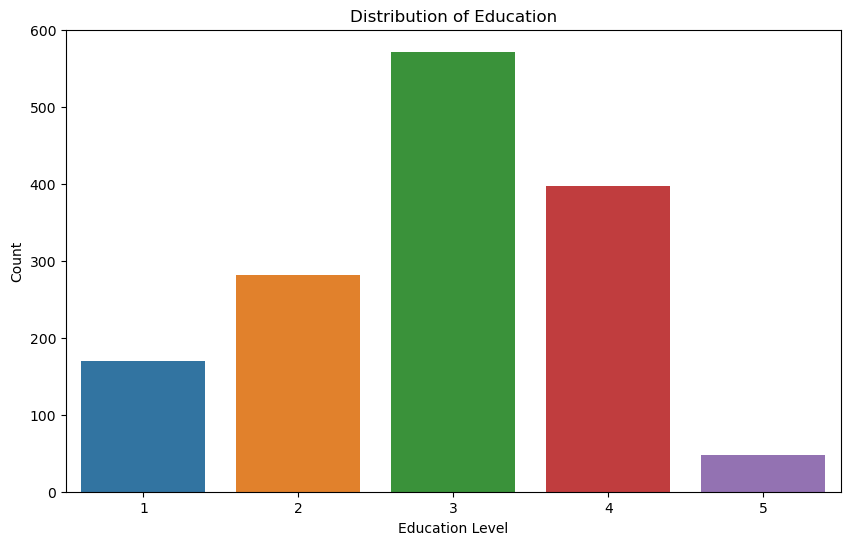

In [32]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Education', data=df)
plt.title('Distribution of Education')
plt.xlabel('Education Level')
plt.ylabel('Count')
plt.show()


The highest count of employees is associated with an education level of 3.

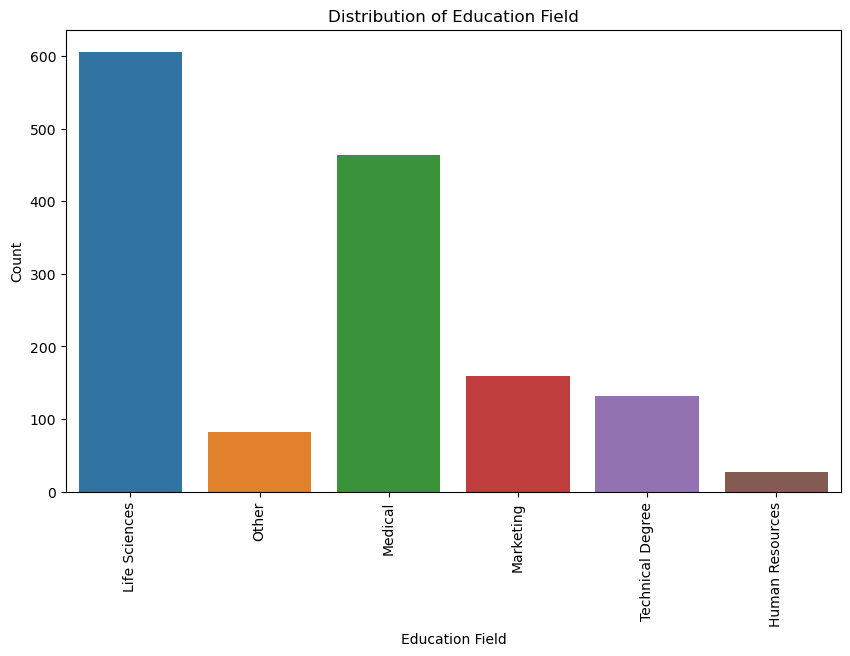

In [33]:
plt.figure(figsize=(10, 6))
sns.countplot(x='EducationField', data=df)
plt.title('Distribution of Education Field')
plt.xlabel('Education Field')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()


Employees with a background in the life sciences education field are the highest in count, while those with human resources as their education field are the lowest in count.

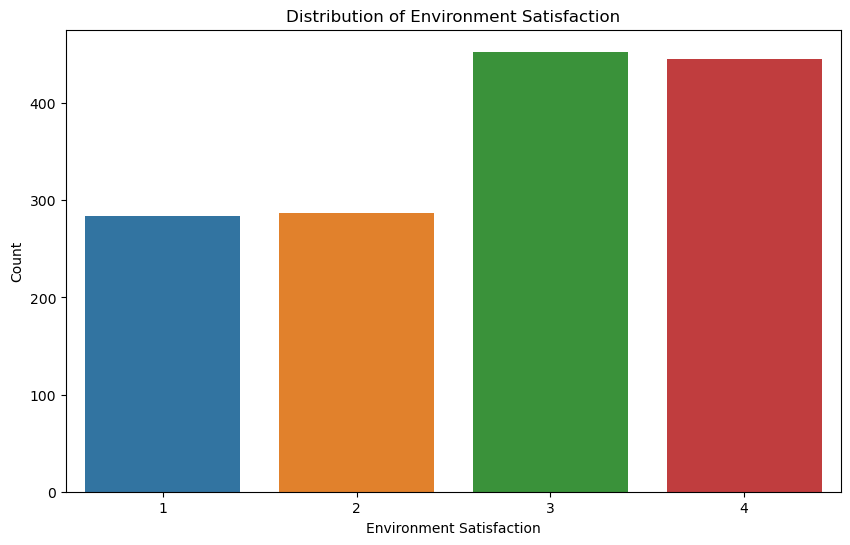

In [34]:
plt.figure(figsize=(10, 6))
sns.countplot(x='EnvironmentSatisfaction', data=df)
plt.title('Distribution of Environment Satisfaction')
plt.xlabel('Environment Satisfaction')
plt.ylabel('Count')
plt.show()


Employees with an environment satisfaction rating of 3 have a high count.

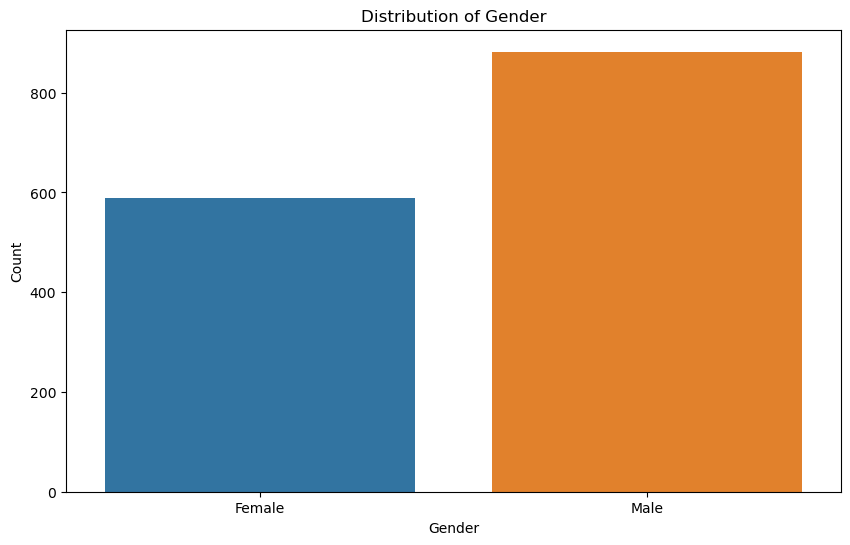

In [35]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Gender', data=df)
plt.title('Distribution of Gender')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.show()


Male employees have a higher count compared to female employees.

<Axes: ylabel='count'>

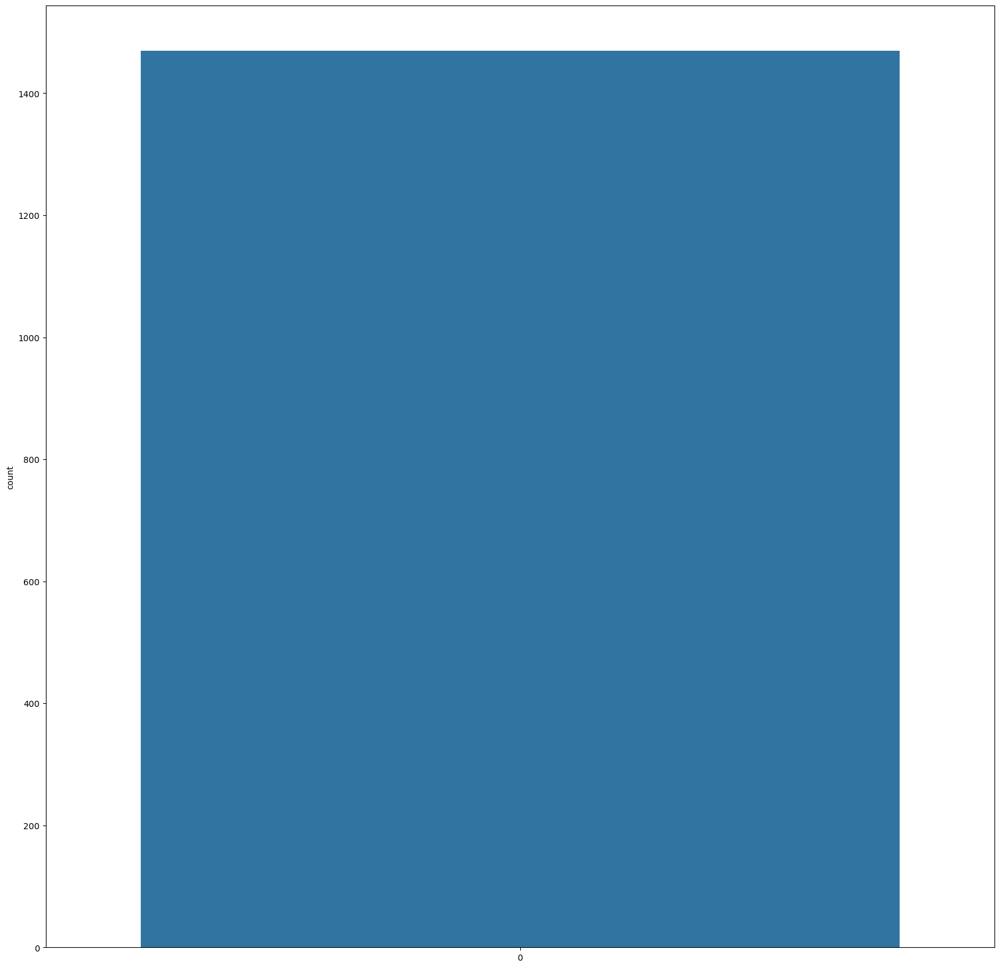

In [36]:
plt.figure(figsize=(20,20))
sns.countplot(df['HourlyRate'])

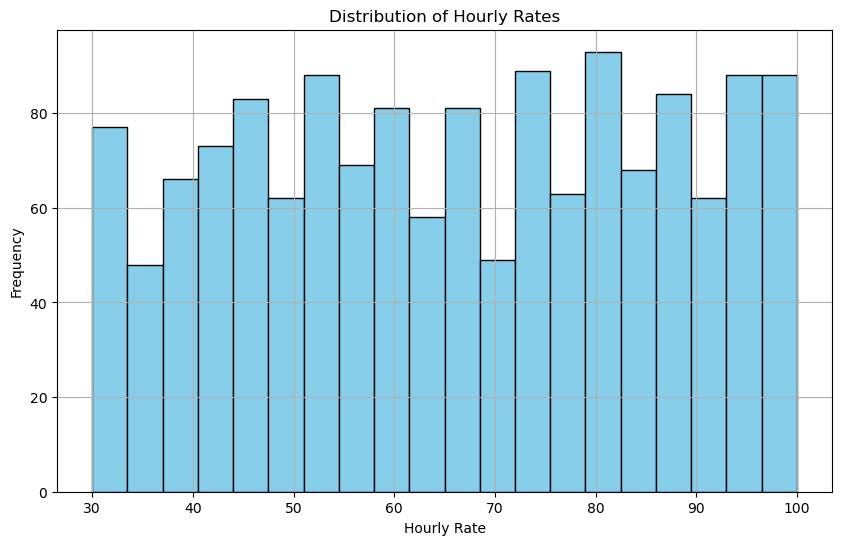

In [37]:
plt.figure(figsize=(10, 6))
plt.hist(df['HourlyRate'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Hourly Rates')
plt.xlabel('Hourly Rate')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


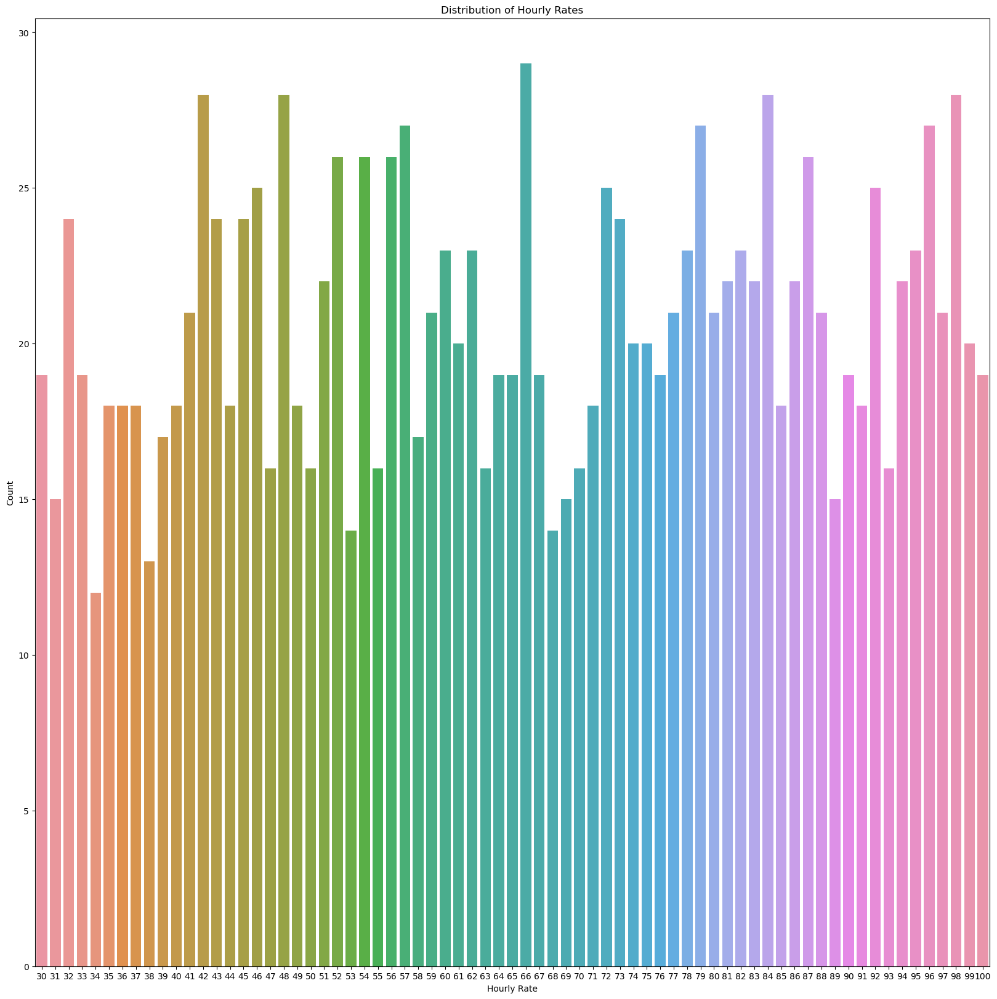

In [38]:
plt.figure(figsize=(20,20))
sns.countplot(x='HourlyRate', data=df)
plt.title('Distribution of Hourly Rates')
plt.xlabel('Hourly Rate')
plt.ylabel('Count')
plt.show()


Employees with an hourly rate of 66 have the highest count, while those with an hourly rate of 34 have the lowest count in the dataset.

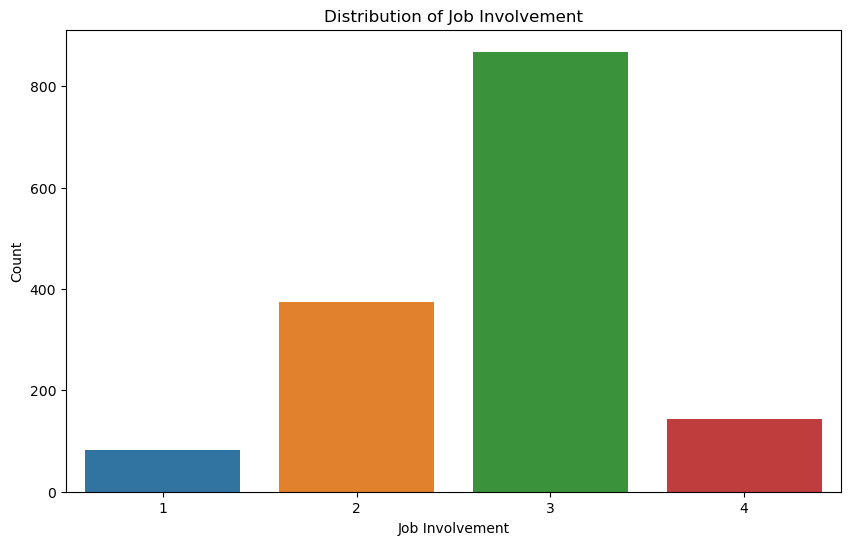

In [39]:
plt.figure(figsize=(10, 6))
sns.countplot(x='JobInvolvement', data=df)
plt.title('Distribution of Job Involvement')
plt.xlabel('Job Involvement')
plt.ylabel('Count')
plt.show()


Employees with a job involvement rating of 3 have the highest count.

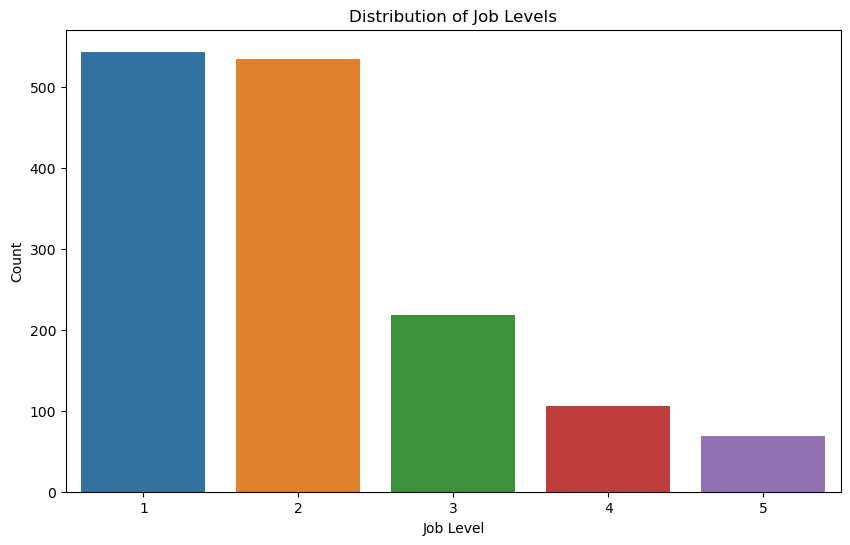

In [40]:
plt.figure(figsize=(10, 6))
sns.countplot(x='JobLevel', data=df)
plt.title('Distribution of Job Levels')
plt.xlabel('Job Level')
plt.ylabel('Count')
plt.show()


Employees with a job level rating of 1 have a high count.

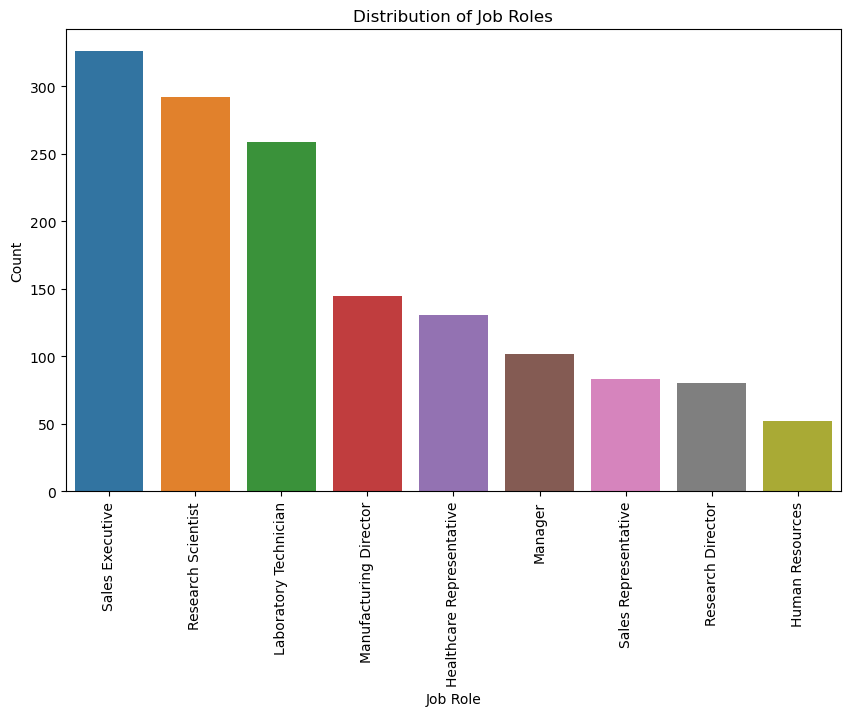

In [41]:
plt.figure(figsize=(10, 6))
sns.countplot(x='JobRole', data=df)
plt.title('Distribution of Job Roles')
plt.xlabel('Job Role')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()


The count of employees with the job role of "Sales Executive" is the highest, while the count of employees with the job role of "Human Resources" (HR) is the lowest.

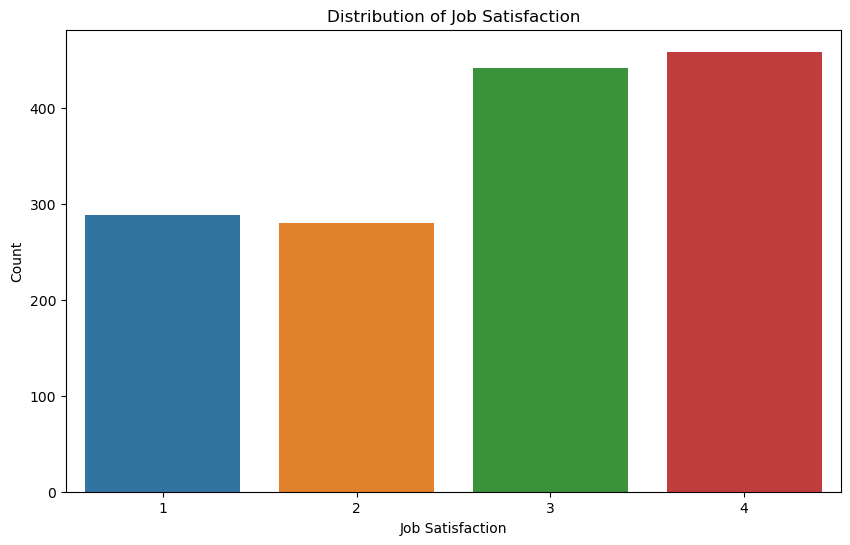

In [42]:
plt.figure(figsize=(10, 6))
sns.countplot(x='JobSatisfaction', data=df)
plt.title('Distribution of Job Satisfaction')
plt.xlabel('Job Satisfaction')
plt.ylabel('Count')
plt.show()


The highest count of job satisfaction falls within category 4 in the dataset.

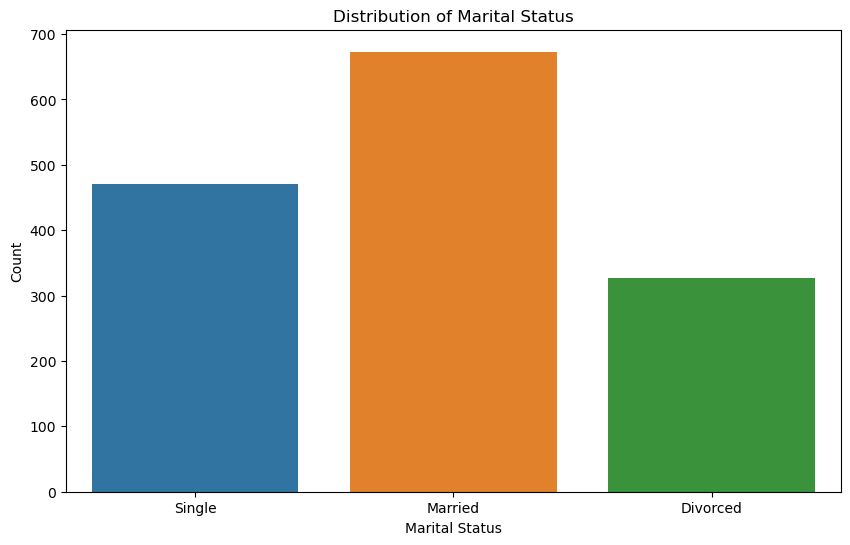

In [43]:
plt.figure(figsize=(10, 6))
sns.countplot(x='MaritalStatus', data=df)
plt.title('Distribution of Marital Status')
plt.xlabel('Marital Status')
plt.ylabel('Count')
plt.show()


Married employees have the highest count, while divorced employees have the lowest count.

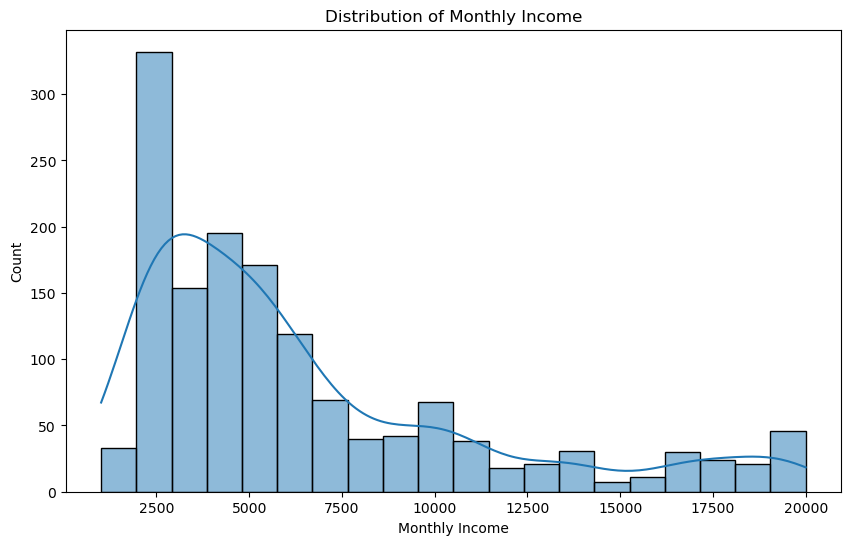

In [44]:
plt.figure(figsize=(10, 6))
sns.histplot(df['MonthlyIncome'], kde=True)
plt.title('Distribution of Monthly Income')
plt.xlabel('Monthly Income')
plt.ylabel('Count')
plt.show()


Employees with a monthly income of 2500 have the highest count, while those with a monthly income of 15000 have the lowest count.

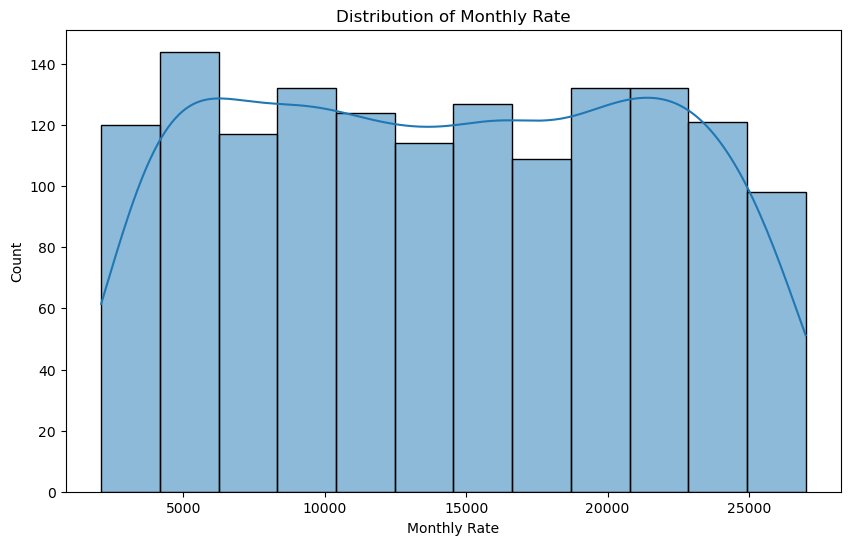

In [45]:
plt.figure(figsize=(10, 6))
sns.histplot(df['MonthlyRate'], kde=True)
plt.title('Distribution of Monthly Rate')
plt.xlabel('Monthly Rate')
plt.ylabel('Count')
plt.show()


The highest count of employees is associated with a monthly rate of 5000, while the lowest count is observed for monthly rates above 25000 in the dataset.

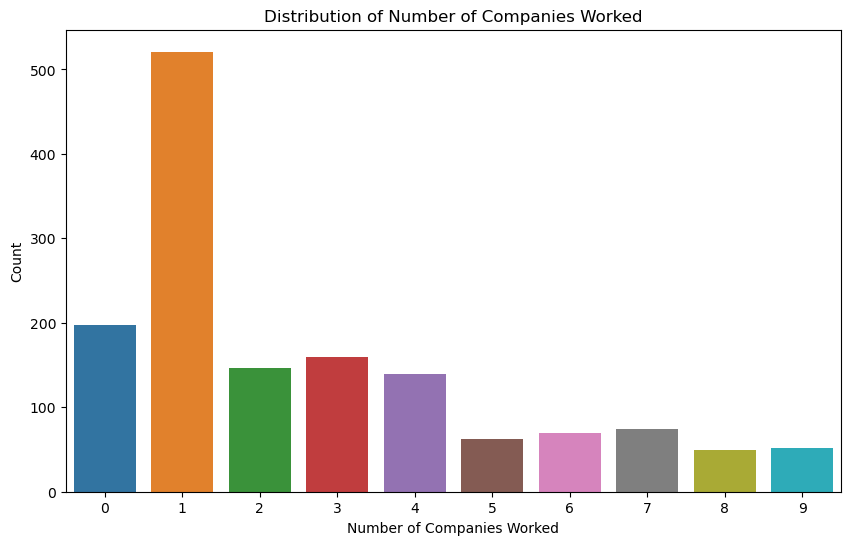

In [46]:
plt.figure(figsize=(10, 6))
sns.countplot(x='NumCompaniesWorked', data=df)
plt.title('Distribution of Number of Companies Worked')
plt.xlabel('Number of Companies Worked')
plt.ylabel('Count')
plt.show()


The highest count of employees corresponds to those who have worked for 1 company, while the lowest count is observed among employees who have worked for 8 companies in the dataset.

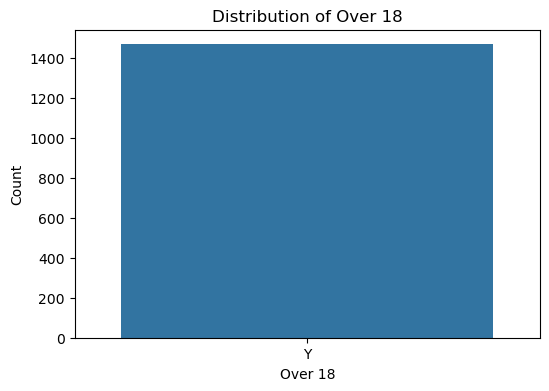

In [47]:
plt.figure(figsize=(6, 4))
sns.countplot(x='Over18', data=df)
plt.title('Distribution of Over 18')
plt.xlabel('Over 18')
plt.ylabel('Count')
plt.show()


The "Over18" column exclusively contains the "yes" category.

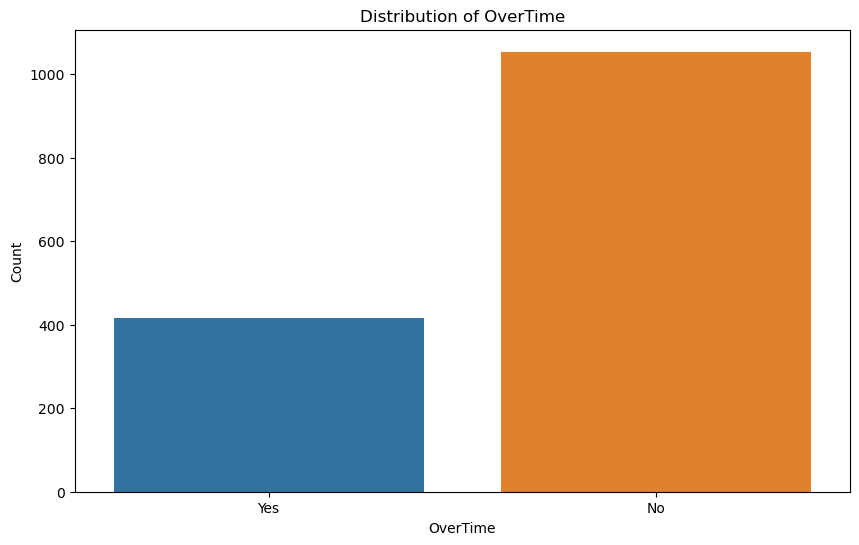

In [48]:
plt.figure(figsize=(10, 6))
sns.countplot(x='OverTime', data=df)
plt.title('Distribution of OverTime')
plt.xlabel('OverTime')
plt.ylabel('Count')
plt.show()


In the dataset, there is a high count of employees who do not work overtime.

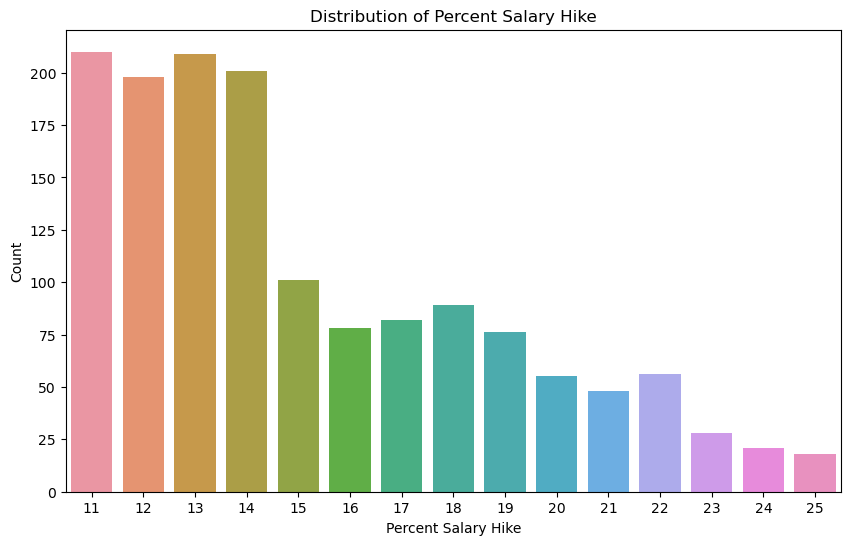

In [49]:
plt.figure(figsize=(10, 6))
sns.countplot(x='PercentSalaryHike', data=df)
plt.title('Distribution of Percent Salary Hike')
plt.xlabel('Percent Salary Hike')
plt.ylabel('Count')
plt.show()


The highest counts of employees are observed with salary hikes of 11% and 13%, while a hike of 25% has the lowest count in the dataset.

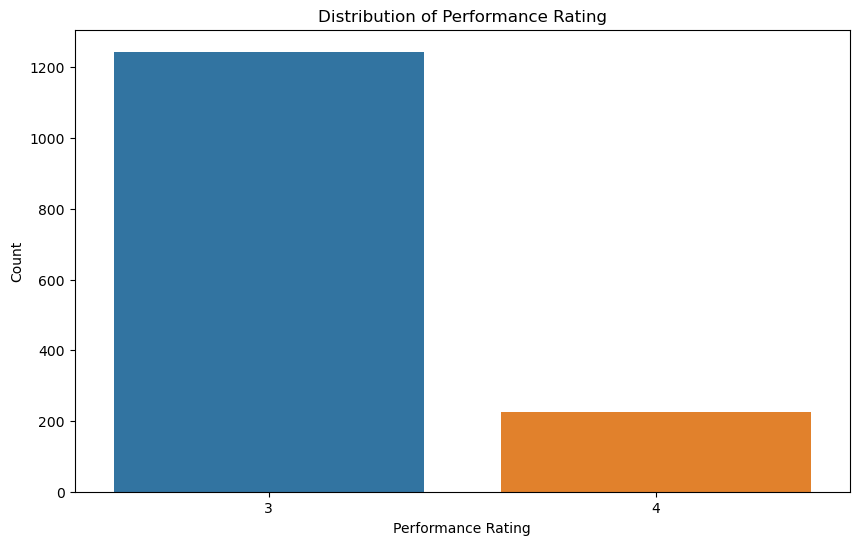

In [50]:
plt.figure(figsize=(10, 6))
sns.countplot(x='PerformanceRating', data=df)
plt.title('Distribution of Performance Rating')
plt.xlabel('Performance Rating')
plt.ylabel('Count')
plt.show()


The count of employees with a performance rating of 3 is the highest.

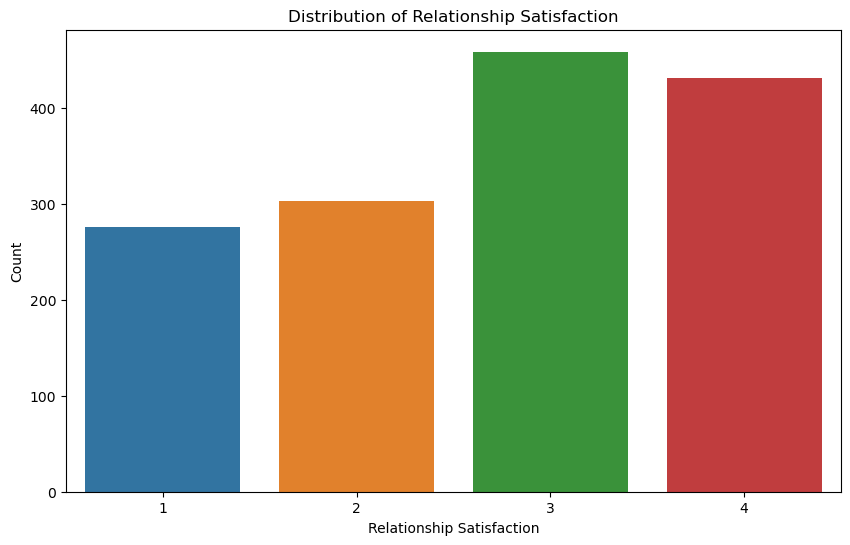

In [51]:
plt.figure(figsize=(10, 6))
sns.countplot(x='RelationshipSatisfaction', data=df)
plt.title('Distribution of Relationship Satisfaction')
plt.xlabel('Relationship Satisfaction')
plt.ylabel('Count')
plt.show()


Employees with a relationship satisfaction rating of 3 have a high count.

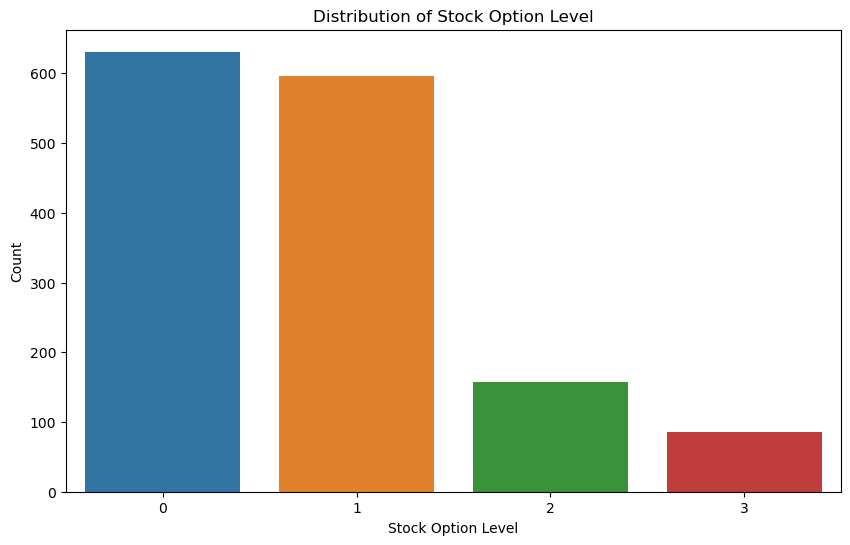

In [52]:
plt.figure(figsize=(10, 6))
sns.countplot(x='StockOptionLevel', data=df)
plt.title('Distribution of Stock Option Level')
plt.xlabel('Stock Option Level')
plt.ylabel('Count')
plt.show()


The count of employees with a stock option level category of 0 is high.

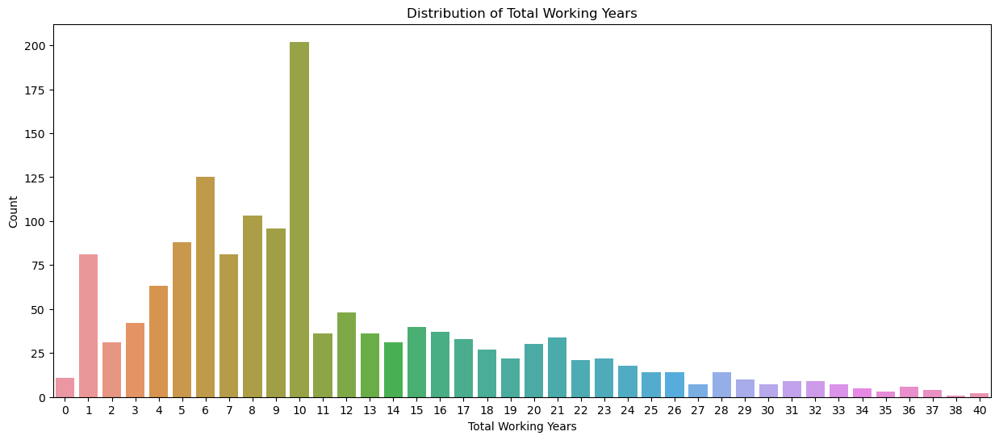

In [53]:
plt.figure(figsize=(15, 6))
sns.countplot(x='TotalWorkingYears', data=df)
plt.title('Distribution of Total Working Years')
plt.xlabel('Total Working Years')
plt.ylabel('Count')
plt.show()


The highest count of employees is observed for those with 10 years of total working years, while the lowest count is for employees with 38 years of total working years.

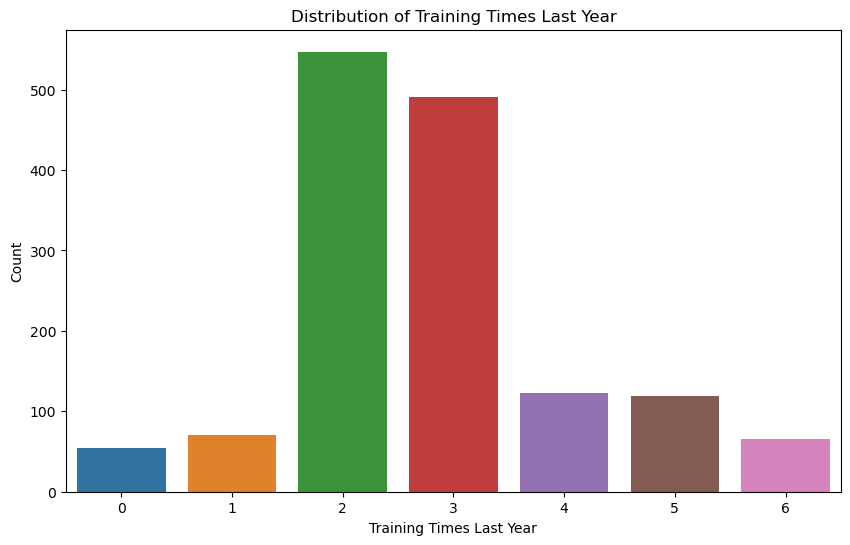

In [54]:
plt.figure(figsize=(10, 6))
sns.countplot(x='TrainingTimesLastYear', data=df)
plt.title('Distribution of Training Times Last Year')
plt.xlabel('Training Times Last Year')
plt.ylabel('Count')
plt.show()


The highest count of employees in the training times last year is observed for category 2.

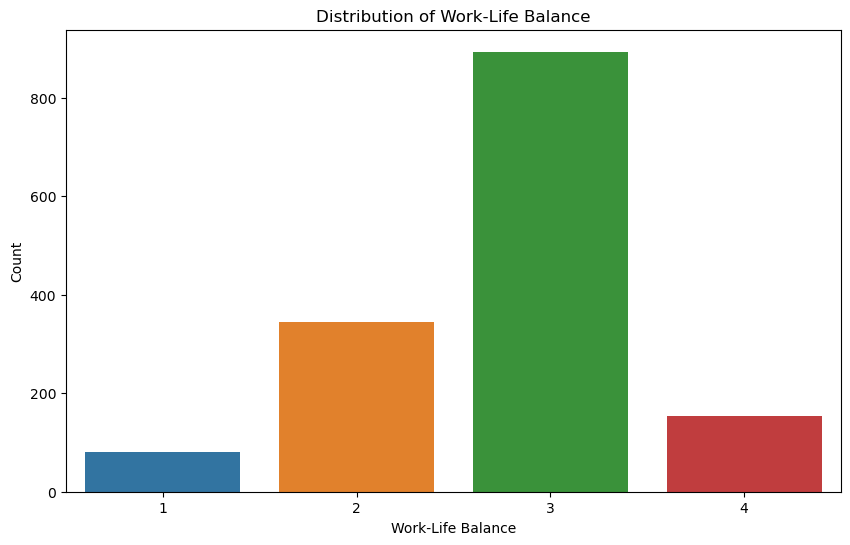

In [55]:
plt.figure(figsize=(10, 6))
sns.countplot(x='WorkLifeBalance', data=df)
plt.title('Distribution of Work-Life Balance')
plt.xlabel('Work-Life Balance')
plt.ylabel('Count')
plt.show()


The highest count of employees in the work-life balance is observed in the 3rd category.

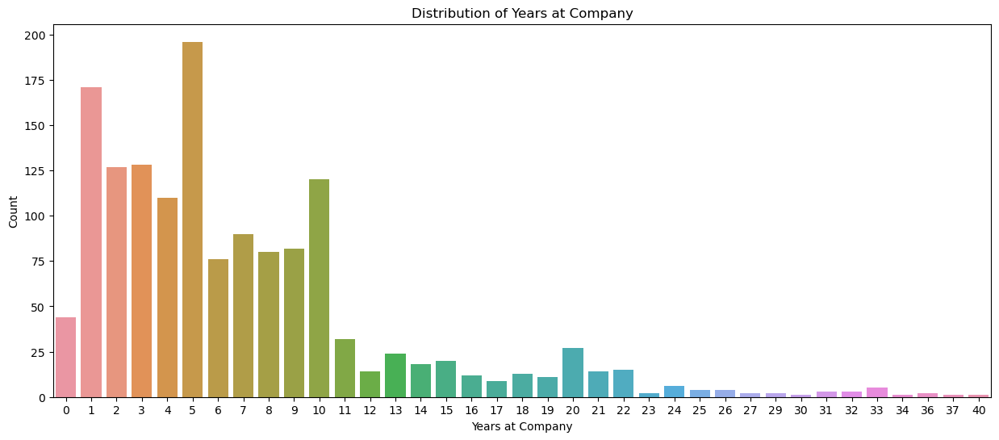

In [56]:
plt.figure(figsize=(15, 6))
sns.countplot(x='YearsAtCompany', data=df)
plt.title('Distribution of Years at Company')
plt.xlabel('Years at Company')
plt.ylabel('Count')
plt.show()


The highest count of employees is observed for those with 5 years at the company, while the lowest count is for employees with 30 years at the company.

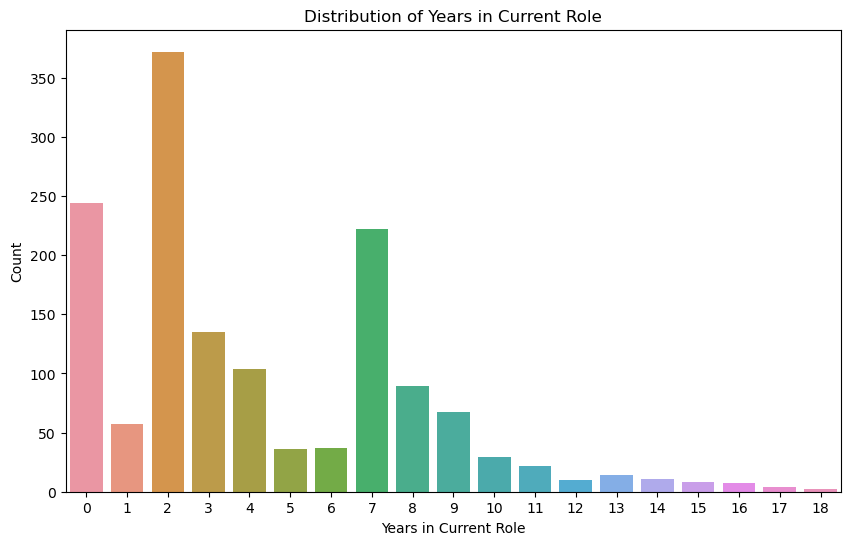

In [57]:
plt.figure(figsize=(10, 6))
sns.countplot(x='YearsInCurrentRole', data=df)
plt.title('Distribution of Years in Current Role')
plt.xlabel('Years in Current Role')
plt.ylabel('Count')
plt.show()


The highest count of employees is observed for those with 2 years in the current role, while the lowest count is for employees with 18 years in the current role.

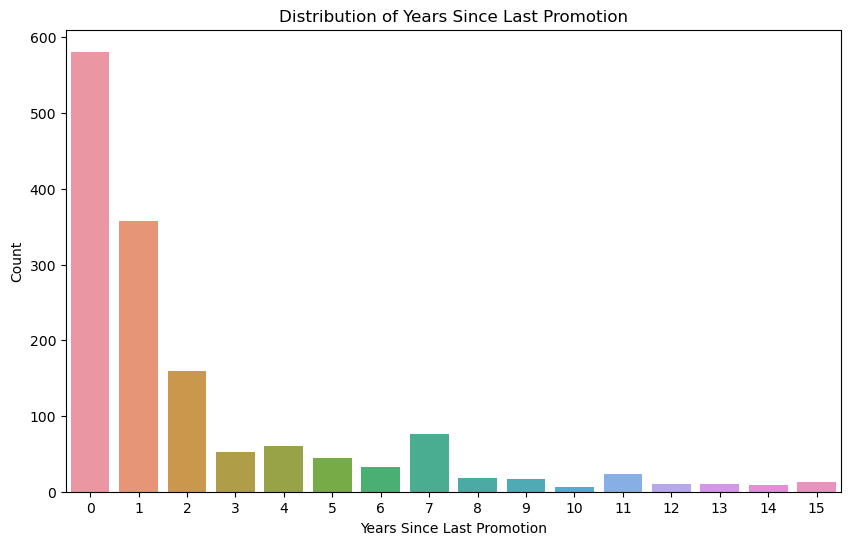

In [58]:
plt.figure(figsize=(10, 6))
sns.countplot(x='YearsSinceLastPromotion', data=df)
plt.title('Distribution of Years Since Last Promotion')
plt.xlabel('Years Since Last Promotion')
plt.ylabel('Count')
plt.show()


The highest count of employees is observed for those with 0 years since the last promotion, while the lowest count is for employees with 10 years since the last promotion.

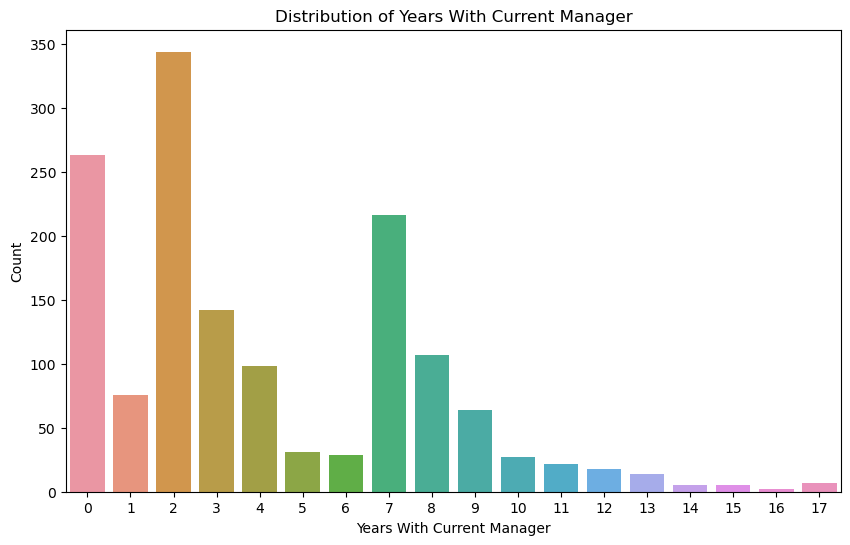

In [59]:
plt.figure(figsize=(10, 6))
sns.countplot(x='YearsWithCurrManager', data=df)
plt.title('Distribution of Years With Current Manager')
plt.xlabel('Years With Current Manager')
plt.ylabel('Count')
plt.show()


The highest count of employees is observed for those with 2 years with the current manager, while the lowest count is for employees with 16 years with the current manager.

# 2.Bivariate analysis

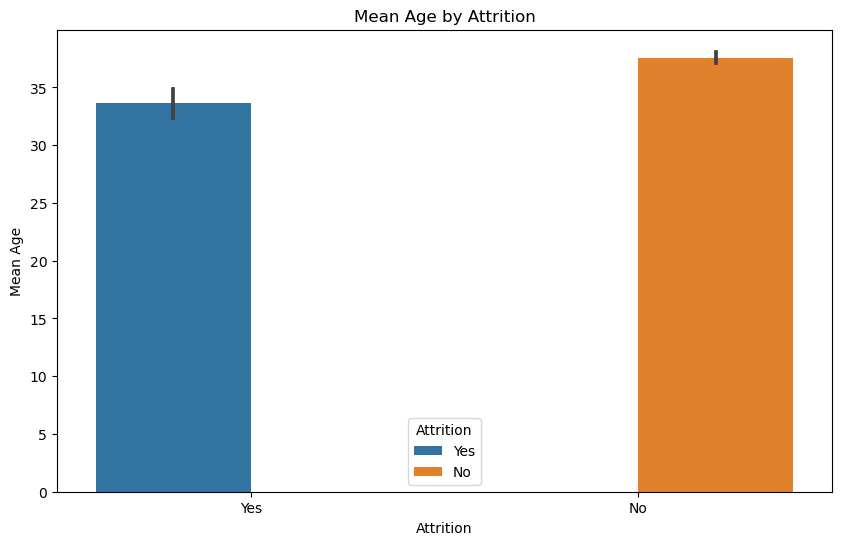

In [60]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Attrition', y='Age', data=df, hue='Attrition')
plt.title('Mean Age by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Mean Age')
plt.show()


Employees with higher age are more prone to attrition.

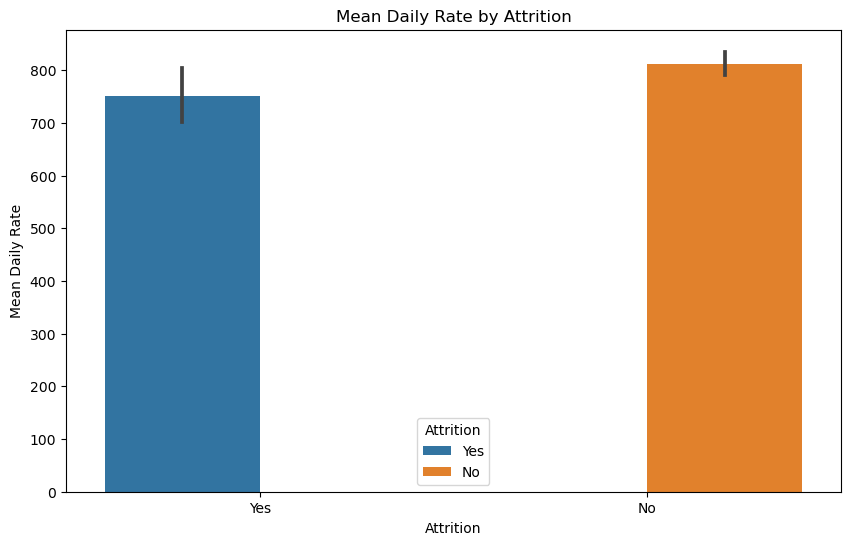

In [61]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Attrition', y='DailyRate', data=df, hue='Attrition')
plt.title('Mean Daily Rate by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Mean Daily Rate')
plt.show()



Employees with lower daily rates are more prone to attrition.

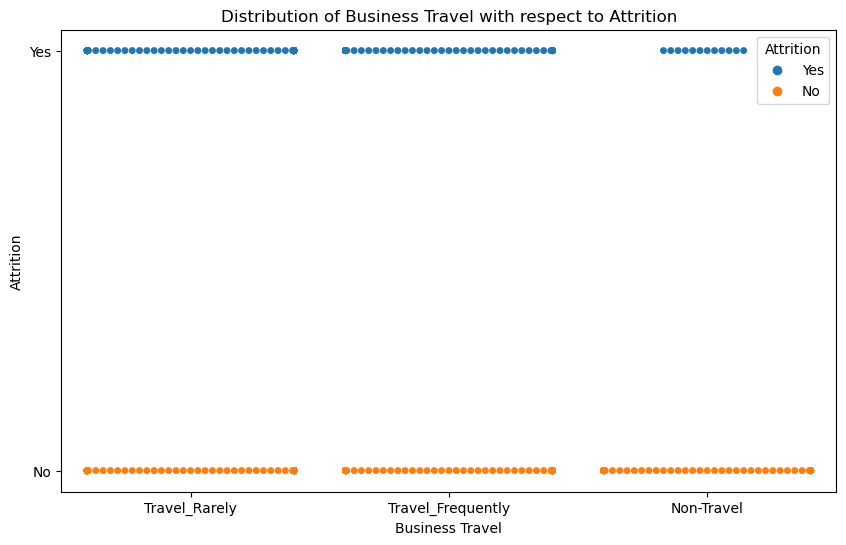

In [62]:
plt.figure(figsize=(10, 6))
sns.swarmplot(x='BusinessTravel', y='Attrition', data=df, hue='Attrition')
plt.title('Distribution of Business Travel with respect to Attrition')
plt.xlabel('Business Travel')
plt.ylabel('Attrition')
plt.show()


Employees who do not travel are less prone to attrition compared to employees who travel.

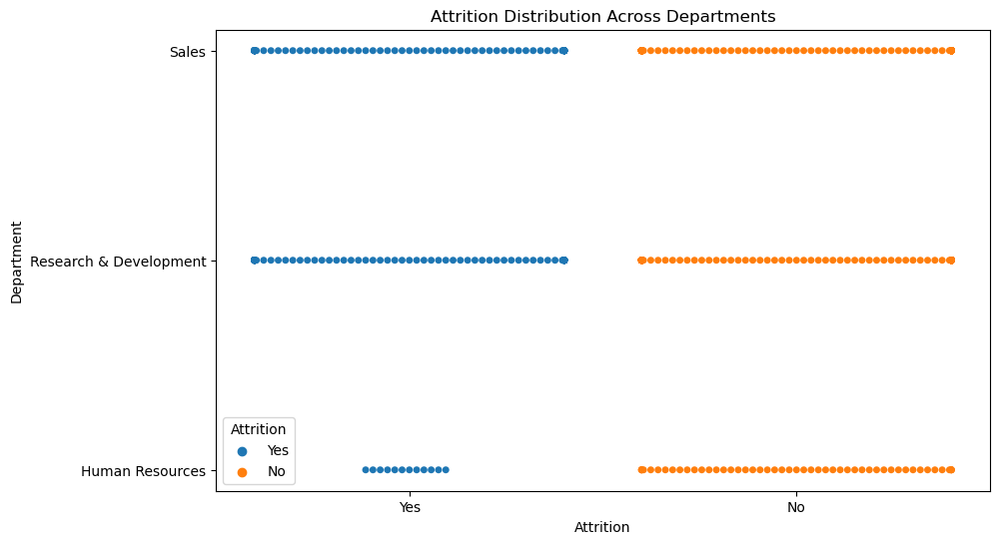

In [63]:
plt.figure(figsize=(10, 6))
sns.swarmplot(x='Attrition', y='Department', data=df, hue='Attrition')
plt.title('Attrition Distribution Across Departments')
plt.xlabel('Attrition')
plt.ylabel('Department')
plt.show()


Employees working in the Human Resources department are less prone to attrition compared to employees in other departments.

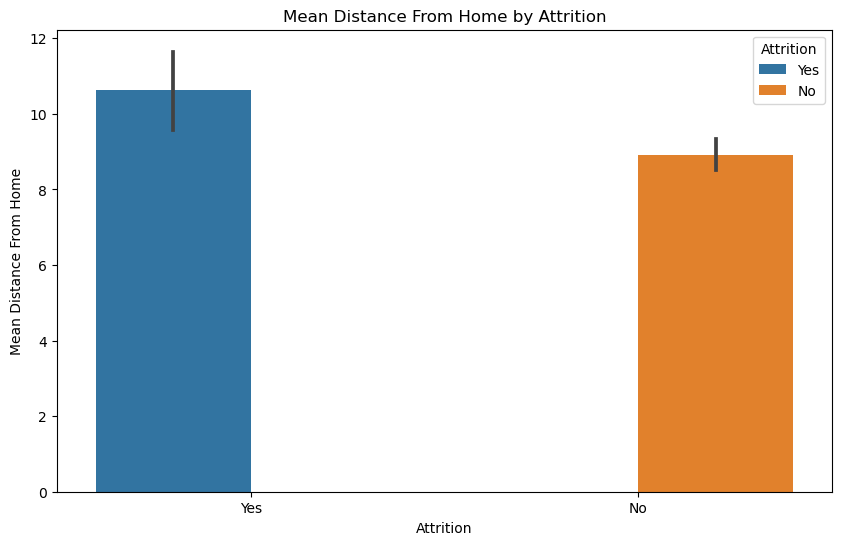

In [64]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Attrition', y='DistanceFromHome', data=df, hue='Attrition')
plt.title('Mean Distance From Home by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Mean Distance From Home')
plt.show()


Employees with longer distances from home are more prone to attrition.

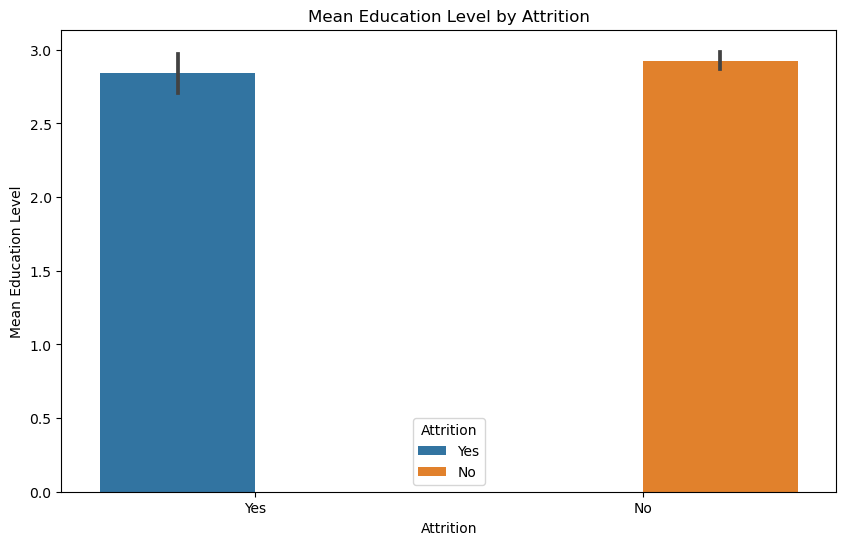

In [65]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Attrition', y='Education', data=df, hue='Attrition')
plt.title('Mean Education Level by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Mean Education Level')
plt.show()


It appears that age is a more significant factor in predicting attrition compared to education level.

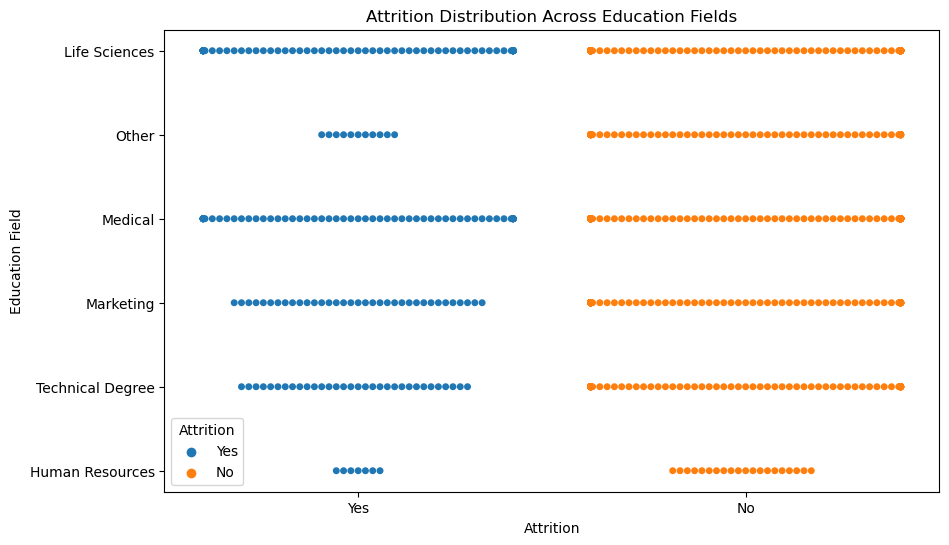

In [66]:
plt.figure(figsize=(10, 6))
sns.swarmplot(x='Attrition', y='EducationField', data=df, hue='Attrition')
plt.title('Attrition Distribution Across Education Fields')
plt.xlabel('Attrition')
plt.ylabel('Education Field')
plt.show()


Employees with an education field in Human Resources are less prone to attrition compared to employees with education fields in Technical, Medical, Marketing, and Life Sciences.

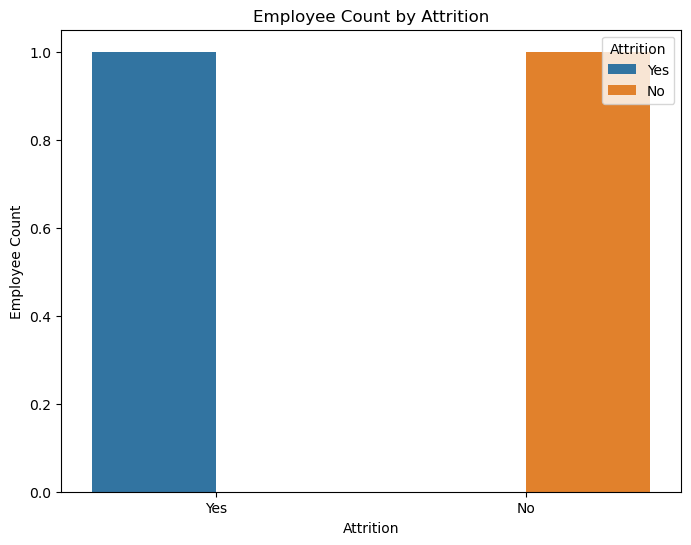

In [67]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='EmployeeCount', data=df, hue='Attrition')
plt.title('Employee Count by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Employee Count')
plt.show()


 The employee count typically remains constant across both attrition and non-attrition groups, so it's expected not to observe any distinct pattern between attrition rate and employee count.

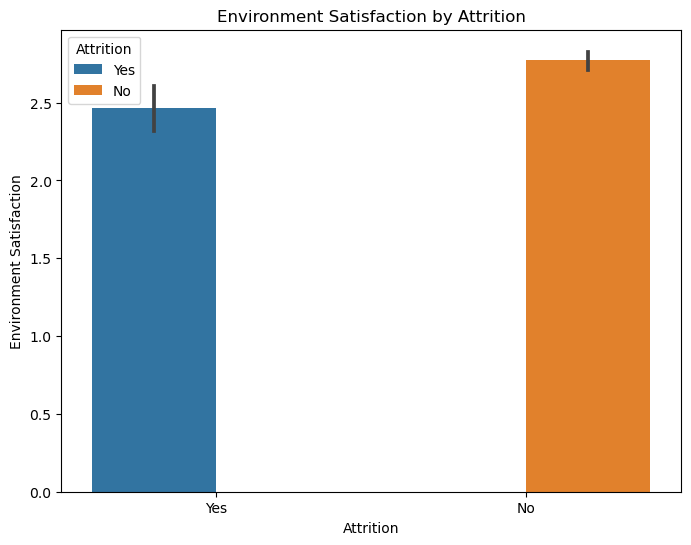

In [68]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='EnvironmentSatisfaction', data=df, hue='Attrition')
plt.title('Environment Satisfaction by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Environment Satisfaction')
plt.show()


Employees who exhibit higher levels of environmental satisfaction are generally less likely to experience attrition compared to those with lower levels of environmental satisfaction.

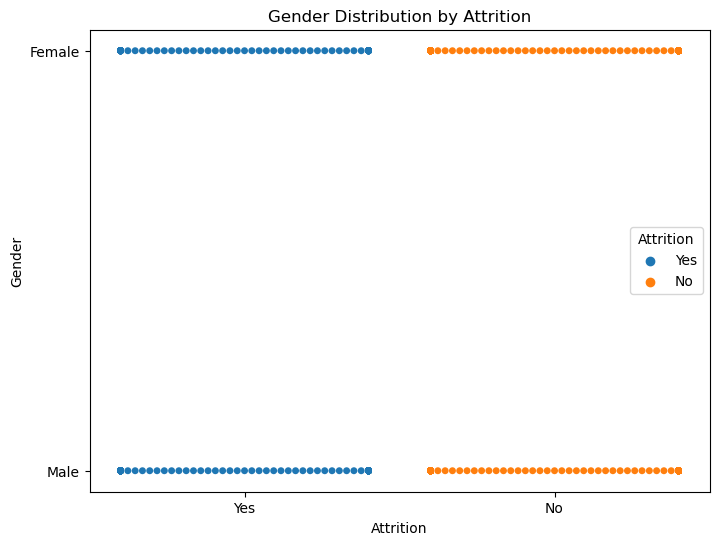

In [69]:
plt.figure(figsize=(8, 6))
sns.swarmplot(x='Attrition', y='Gender', data=df, hue='Attrition')
plt.title('Gender Distribution by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Gender')
plt.show()


The attrition and non-attrition rates are nearly equal for both male and female genders.

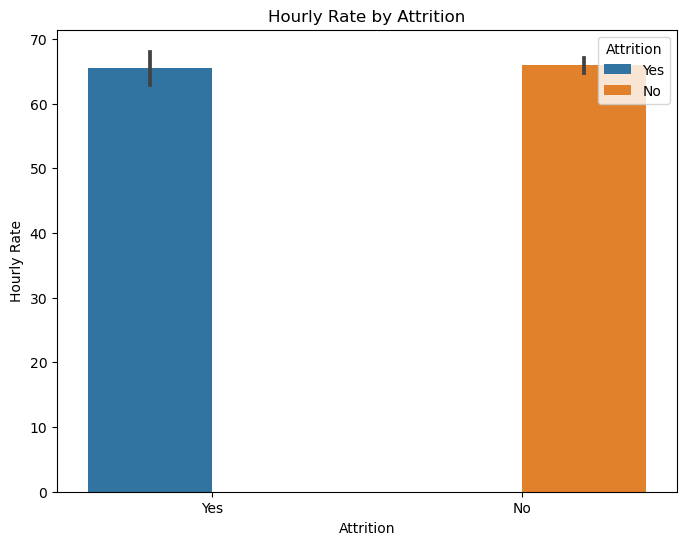

In [70]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='HourlyRate', data=df, hue='Attrition')
plt.title('Hourly Rate by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Hourly Rate')
plt.show()


No discernible pattern appears to exist between hourly rate and attrition rate.

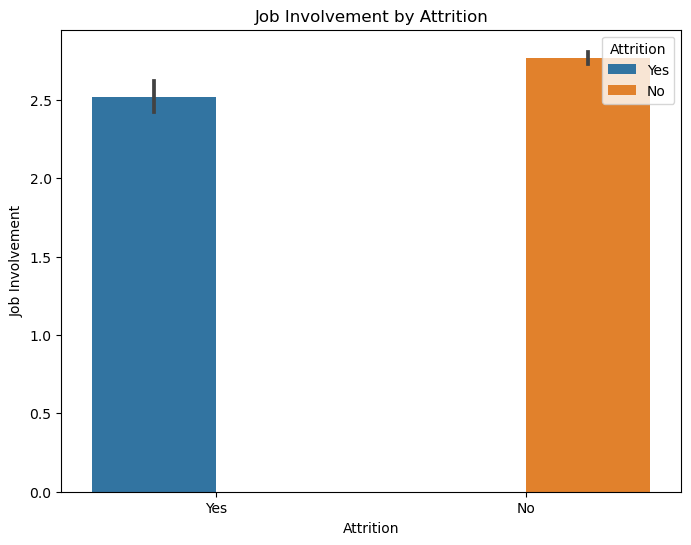

In [71]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='JobInvolvement', data=df, hue='Attrition')
plt.title('Job Involvement by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Job Involvement')
plt.show()


Employees with lower job involvement are more likely to leave or experience attrition.

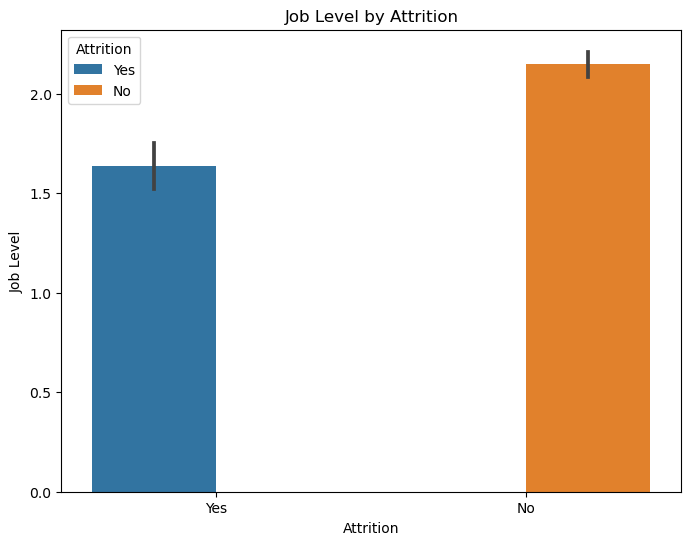

In [72]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='JobLevel', data=df, hue='Attrition')
plt.title('Job Level by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Job Level')
plt.show()

Employees with higher job levels are less likely to experience attrition.

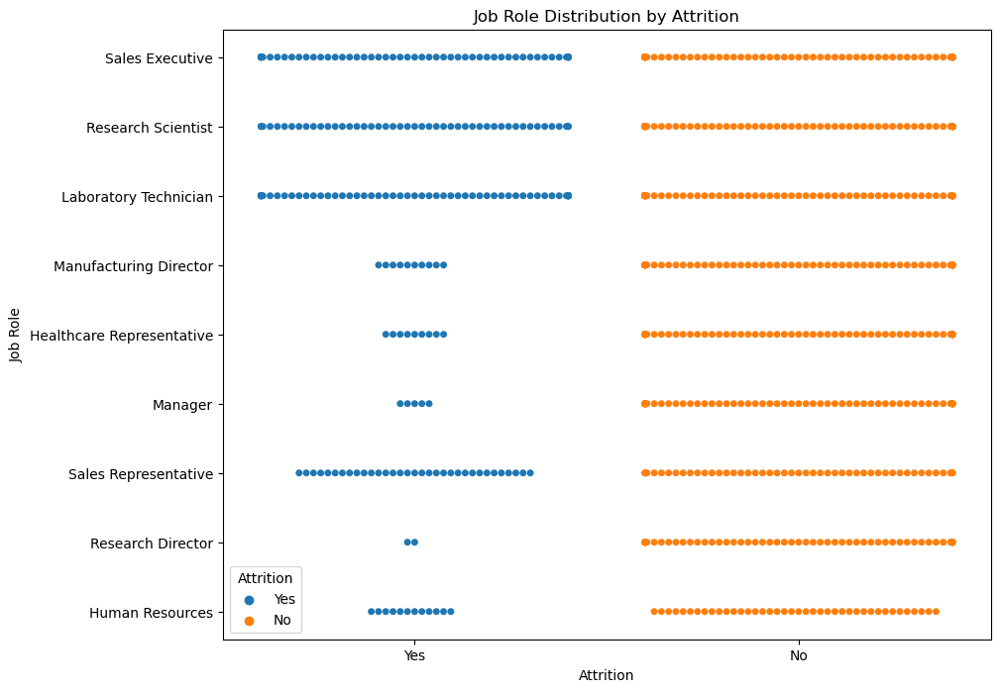

In [73]:
plt.figure(figsize=(10, 8))
sns.swarmplot(x='Attrition', y='JobRole', data=df, hue='Attrition')
plt.title('Job Role Distribution by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Job Role')
plt.show()


Employees in the Research Director job role exhibit notably lower attrition rates compared to other job roles.

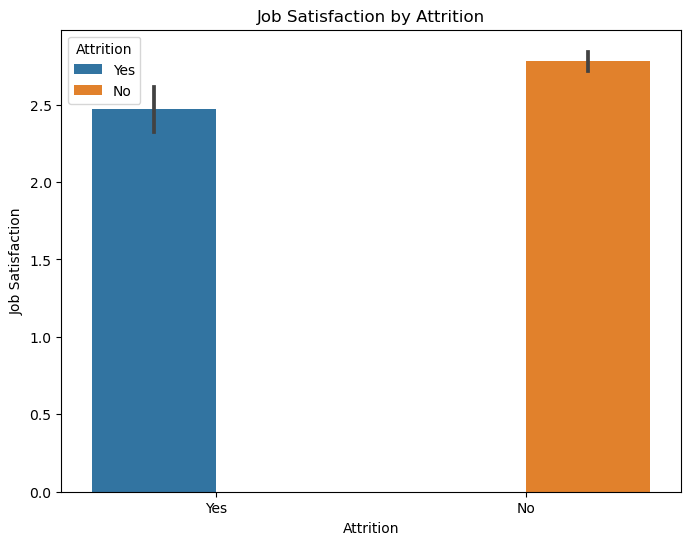

In [74]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='JobSatisfaction', data=df, hue='Attrition')
plt.title('Job Satisfaction by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Job Satisfaction')
plt.show()


Employees with lower levels of job satisfaction are more likely to experience attrition.

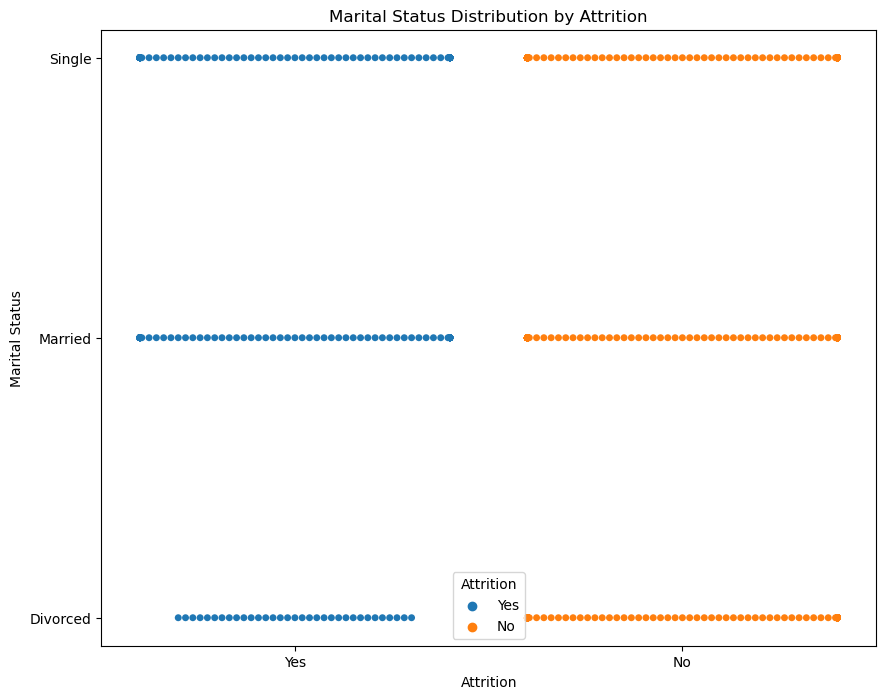

In [75]:
plt.figure(figsize=(10, 8))
sns.swarmplot(x='Attrition', y='MaritalStatus', data=df, hue='Attrition')
plt.title('Marital Status Distribution by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Marital Status')
plt.show()


The attrition rates among single, married, and divorced employees show minimal variation.

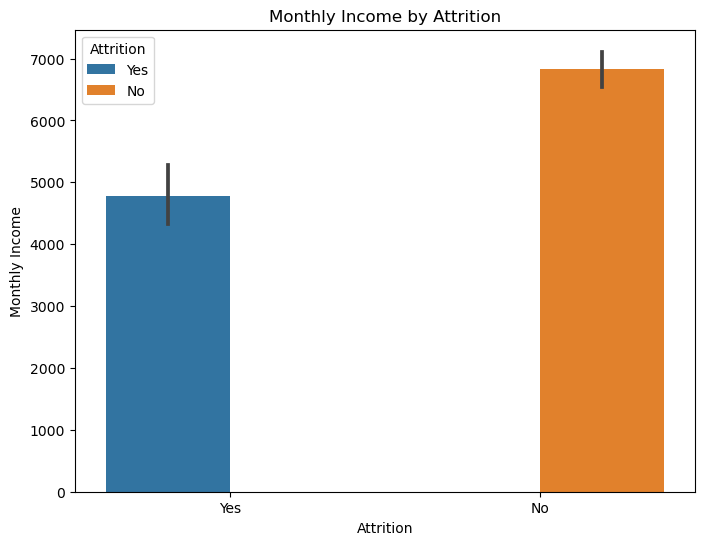

In [76]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='MonthlyIncome', data=df, hue='Attrition')
plt.title('Monthly Income by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Monthly Income')
plt.show()


Employees with lower monthly incomes are more likely to experience attrition.

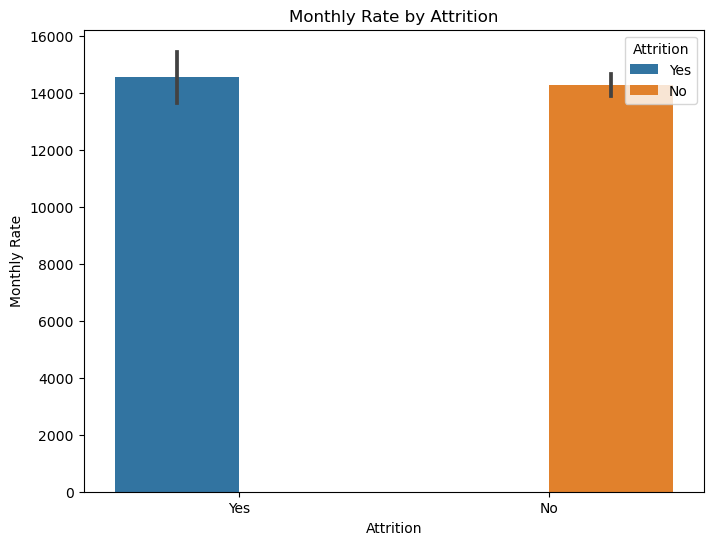

In [77]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='MonthlyRate', data=df, hue='Attrition')
plt.title('Monthly Rate by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Monthly Rate')
plt.show()


There doesn't appear to be a descriptive pattern between attrition rate and monthly rate.

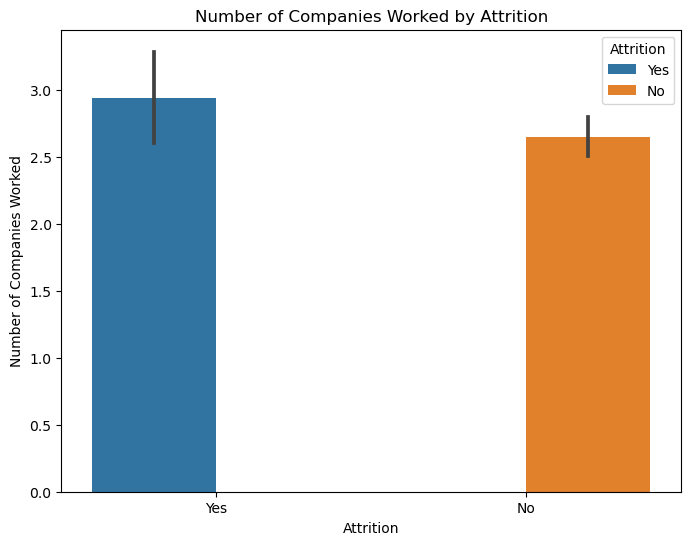

In [78]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='NumCompaniesWorked', data=df, hue='Attrition')
plt.title('Number of Companies Worked by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Number of Companies Worked')
plt.show()


Employees who have worked for a higher number of companies are more likely to experience attrition.

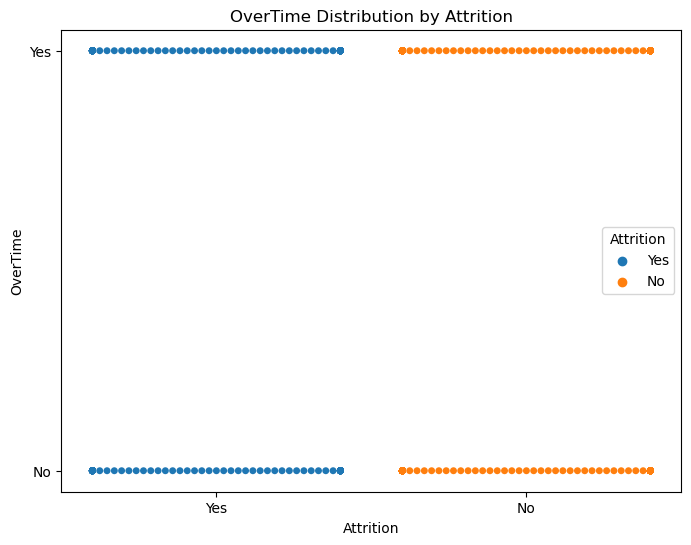

In [79]:
plt.figure(figsize=(8, 6))
sns.swarmplot(x='Attrition', y='OverTime', data=df, hue='Attrition')
plt.title('OverTime Distribution by Attrition')
plt.xlabel('Attrition')
plt.ylabel('OverTime')
plt.show()


There doesn't seem to be a clear pattern between attrition and overtime.

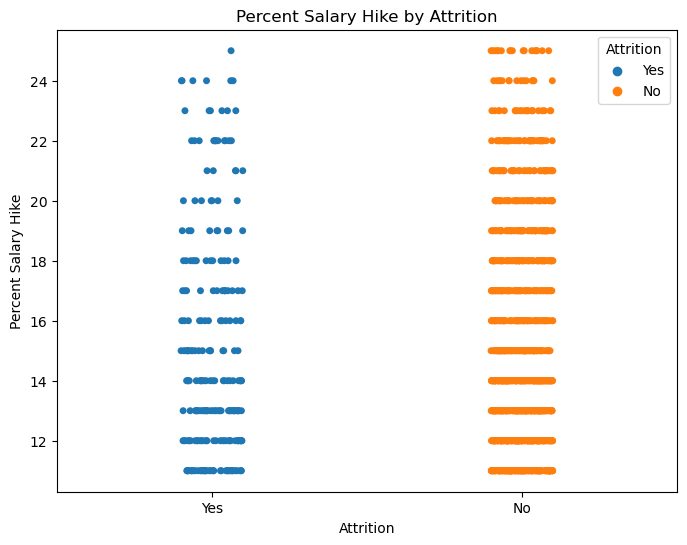

In [80]:
plt.figure(figsize=(8, 6))
sns.stripplot(x='Attrition', y='PercentSalaryHike', data=df, hue='Attrition')
plt.title('Percent Salary Hike by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Percent Salary Hike')
plt.show()


Employees who receive higher performance-based salary hikes are generally less prone to attrition compared to those receiving lower salary hikes.

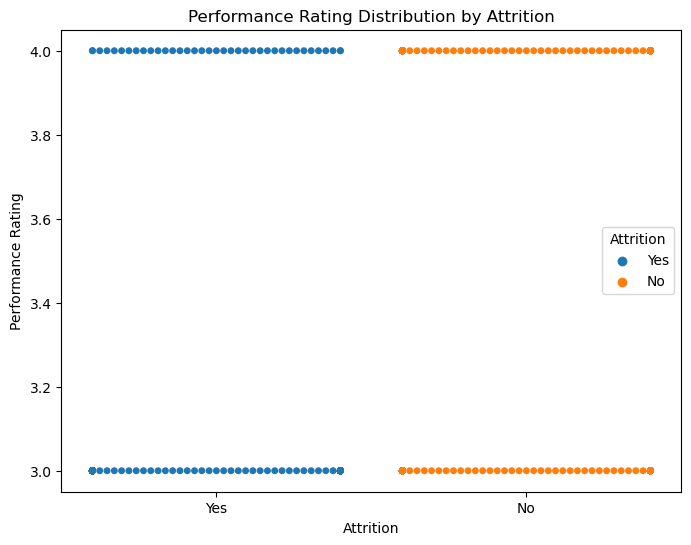

In [81]:
plt.figure(figsize=(8, 6))
sns.swarmplot(x='Attrition', y='PerformanceRating', data=df, hue='Attrition')
plt.title('Performance Rating Distribution by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Performance Rating')
plt.show()


There doesn't seem to be a discernible pattern between performance rating and attrition.

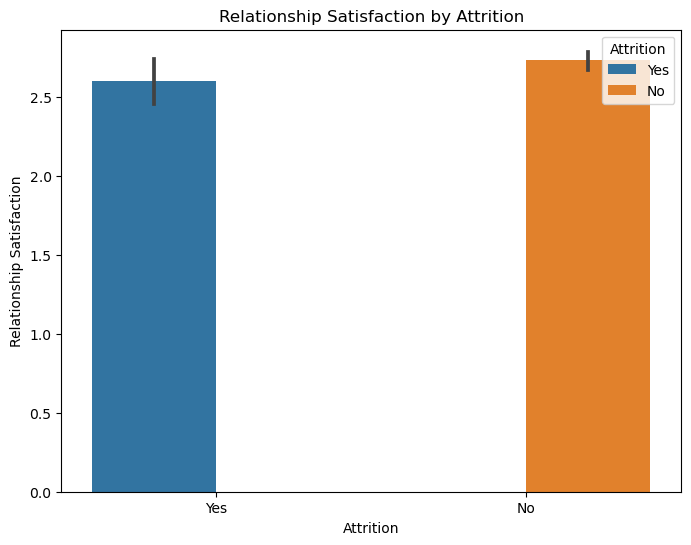

In [82]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='RelationshipSatisfaction', data=df, hue='Attrition')
plt.title('Relationship Satisfaction by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Relationship Satisfaction')
plt.show()


Employees who experience lower levels of relationship satisfaction are more likely to be affected by attrition compared to those who report higher levels of relationship satisfaction.

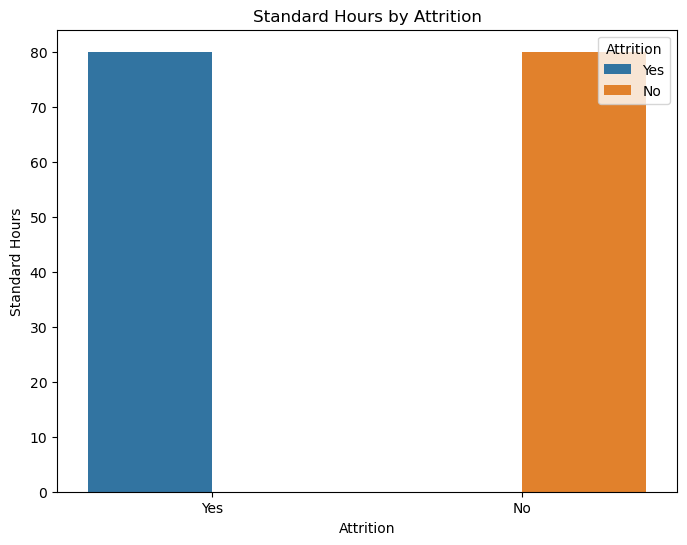

In [83]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='StandardHours', data=df, hue='Attrition')
plt.title('Standard Hours by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Standard Hours')
plt.show()


There appears to be no discernible correlation between standard working hours and the attrition rate among employees.

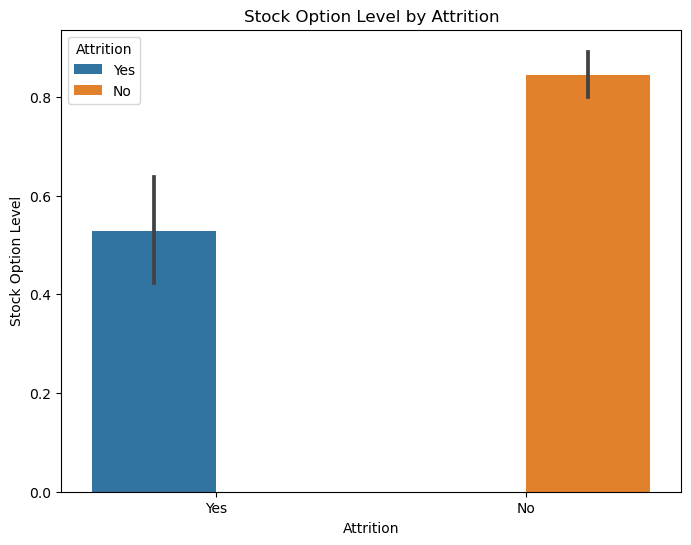

In [84]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='StockOptionLevel', data=df, hue='Attrition')
plt.title('Stock Option Level by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Stock Option Level')
plt.show()


Employees with lower stock option levels are more susceptible to attrition.

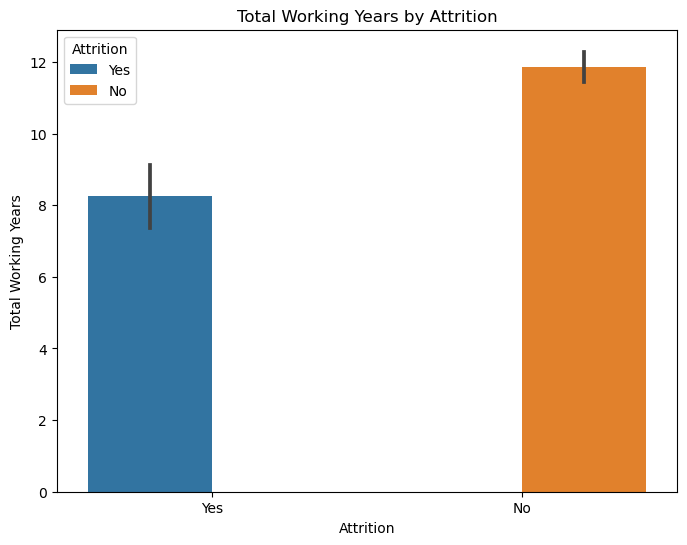

In [85]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='TotalWorkingYears', data=df, hue='Attrition')
plt.title('Total Working Years by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Total Working Years')
plt.show()


Employees with fewer total working years are more susceptible to attrition.

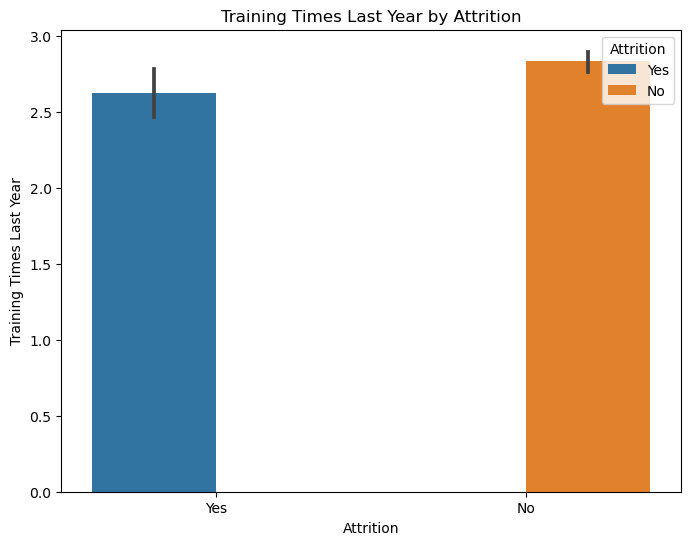

In [86]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='TrainingTimesLastYear', data=df, hue='Attrition')
plt.title('Training Times Last Year by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Training Times Last Year')
plt.show()


Employees who have undergone fewer training sessions in the last year are more likely to experience attrition.

<Axes: xlabel='Attrition', ylabel='WorkLifeBalance'>

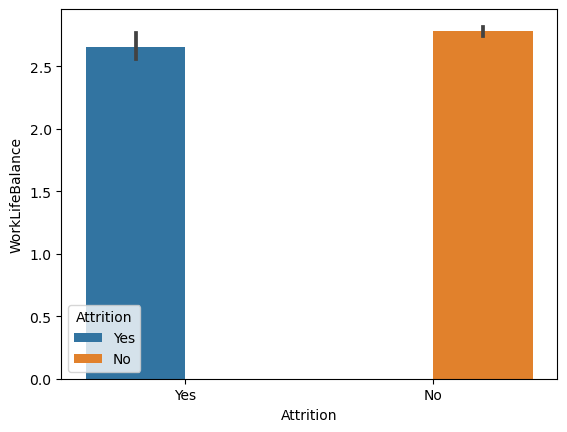

In [87]:
sns.barplot(x='Attrition',y='WorkLifeBalance',data=df,hue='Attrition')

Employees experiencing poorer work-life balance are more susceptible to attrition.

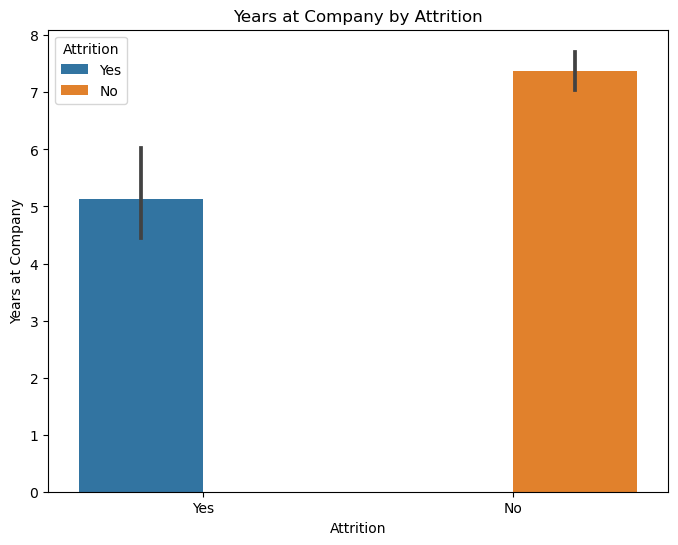

In [88]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='YearsAtCompany', data=df, hue='Attrition')
plt.title('Years at Company by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Years at Company')
plt.show()


Employees with fewer years at the company are more likely to experience attrition compared to those with longer tenures.

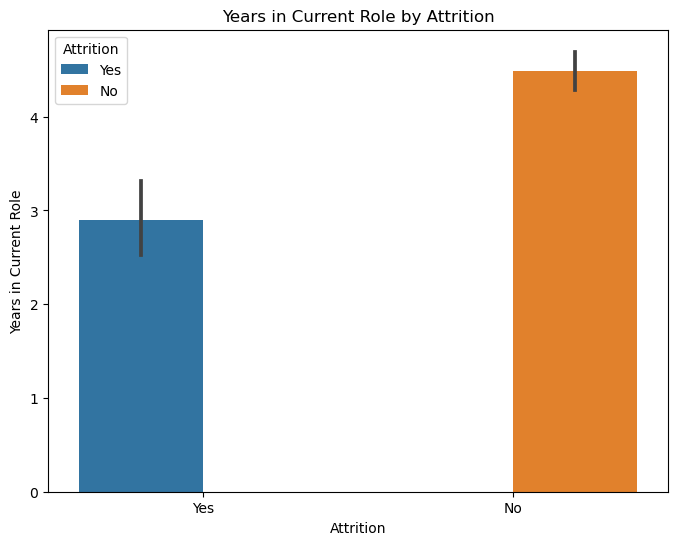

In [89]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='YearsInCurrentRole', data=df, hue='Attrition')
plt.title('Years in Current Role by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Years in Current Role')
plt.show()


Employees who have spent fewer years in their current role are more likely to experience attrition compared to those who have been in their current role for a longer duration.

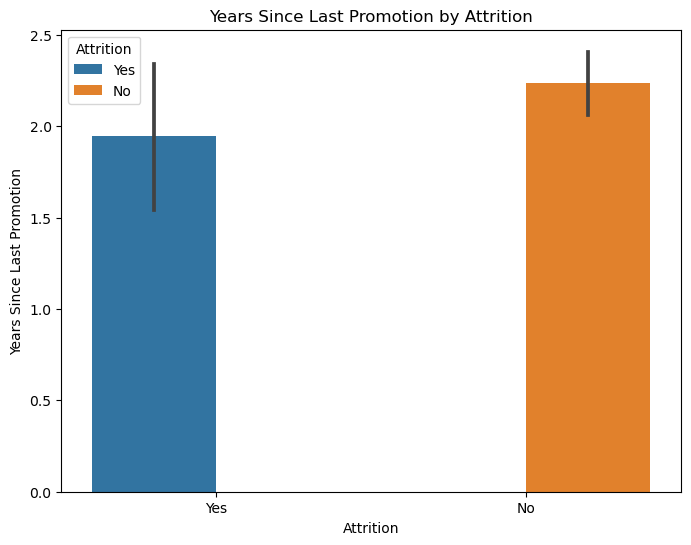

In [90]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='YearsSinceLastPromotion', data=df, hue='Attrition')
plt.title('Years Since Last Promotion by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Years Since Last Promotion')
plt.show()


Employees who have spent fewer years since their last promotion are more likely to be susceptible to attrition.

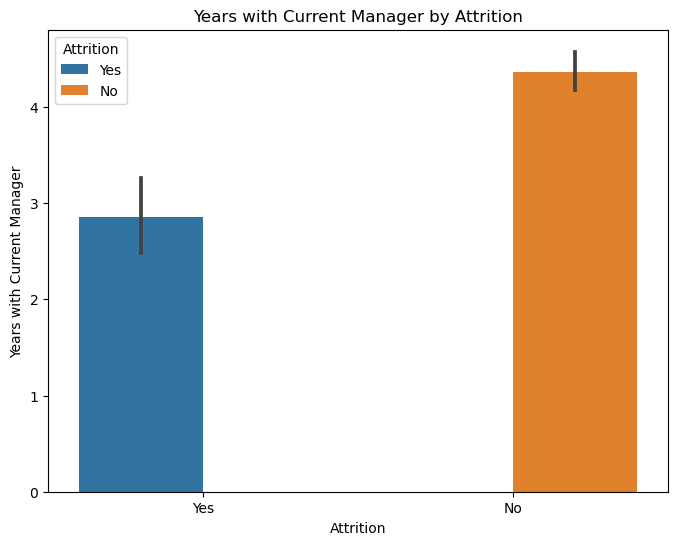

In [91]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Attrition', y='YearsWithCurrManager', data=df, hue='Attrition')
plt.title('Years with Current Manager by Attrition')
plt.xlabel('Attrition')
plt.ylabel('Years with Current Manager')
plt.show()


Employees who have spent fewer years with their current manager are more likely to be susceptible to attrition.

<Figure size 800x600 with 0 Axes>

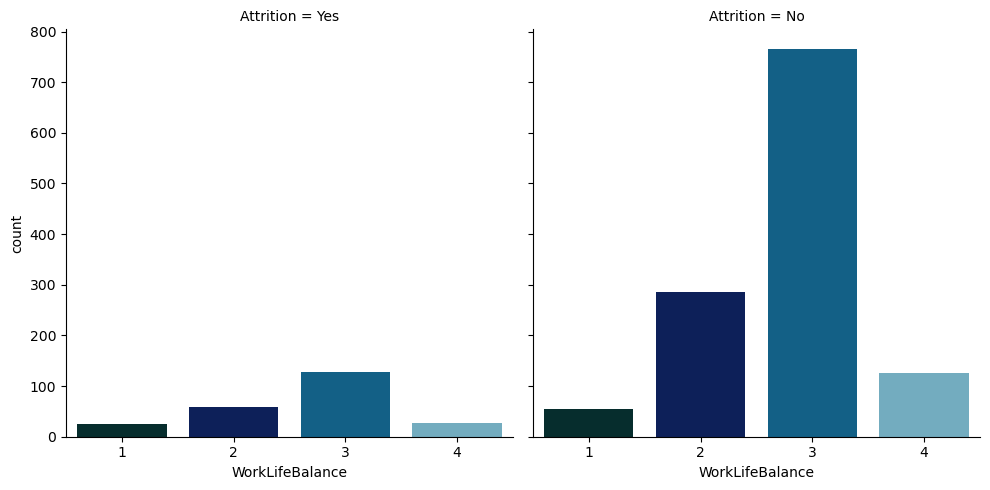

In [92]:
plt.figure(figsize=(8, 6))
sns.catplot(x='WorkLifeBalance', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Employees who have a lower work-life balance are more likely to be prone to attrition.

<Figure size 800x600 with 0 Axes>

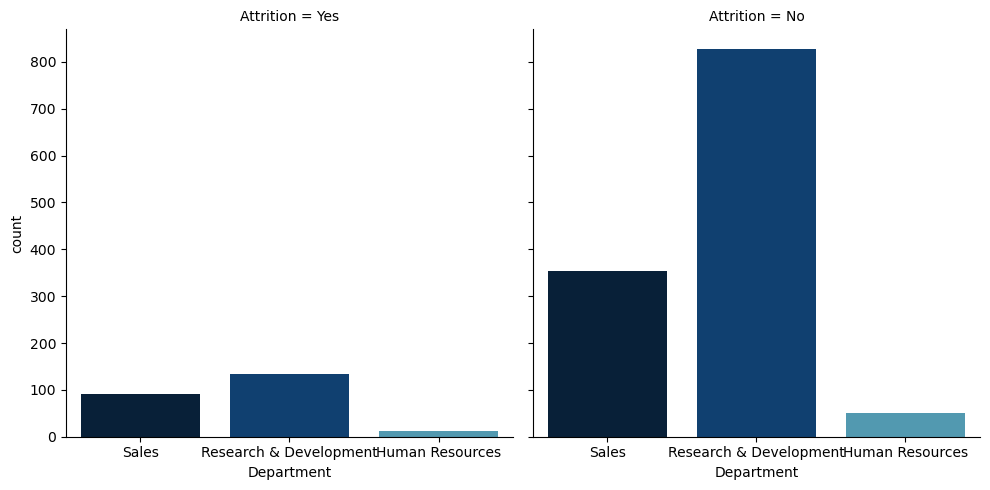

In [93]:
plt.figure(figsize=(8, 6))
sns.catplot(x='Department',col='Attrition',palette='ocean',kind='count',data=df)


Employees who are part of the HR department are less likely to experience attrition.

<Figure size 800x600 with 0 Axes>

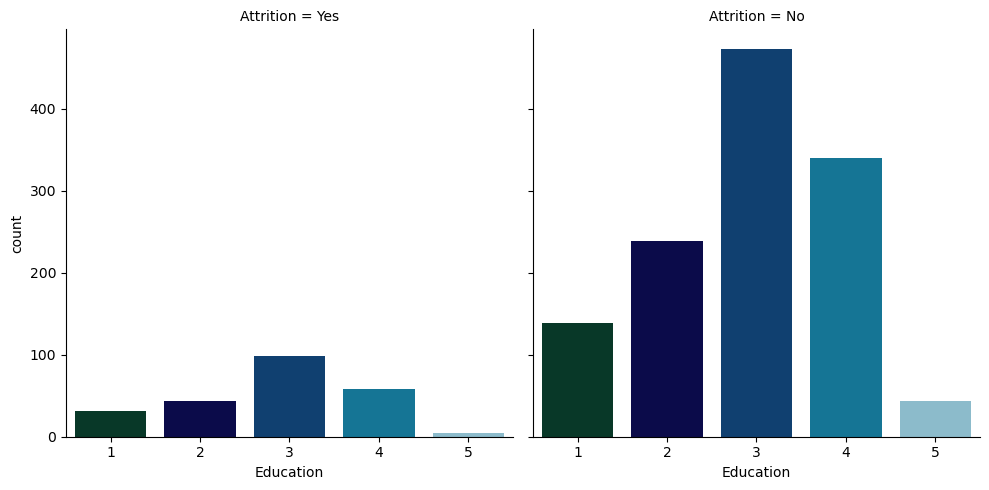

In [94]:
plt.figure(figsize=(8, 6))
sns.catplot(x='Education', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Employees with an education category of 5 are less likely to experience attrition.

<Figure size 800x600 with 0 Axes>

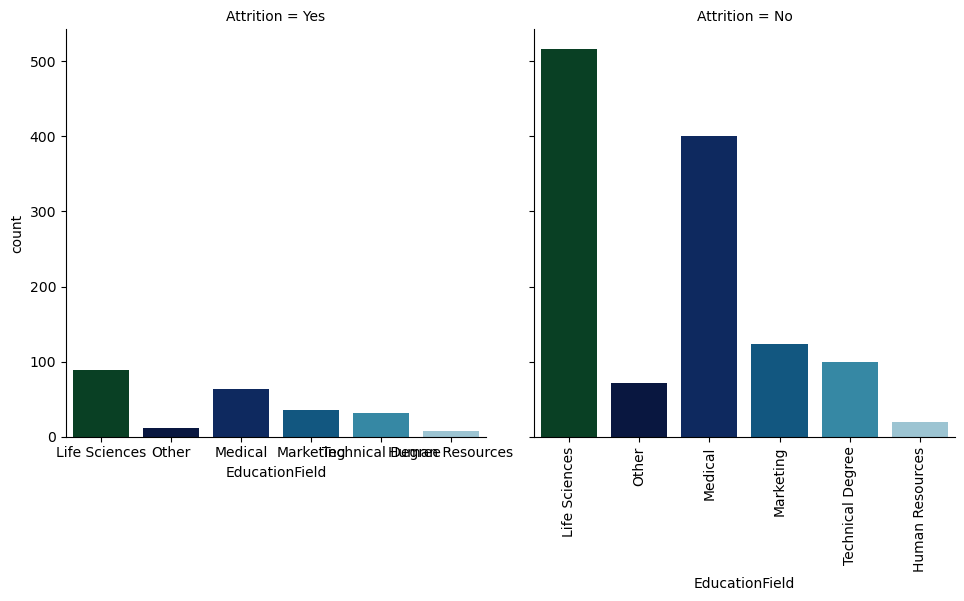

In [95]:
plt.figure(figsize=(8, 6))
sns.catplot(x='EducationField', col='Attrition', palette='ocean', kind='count', data=df)
plt.xticks(rotation=90)
plt.show()


Employees with a background in HR education field are less likely to experience attrition.

<Figure size 800x600 with 0 Axes>

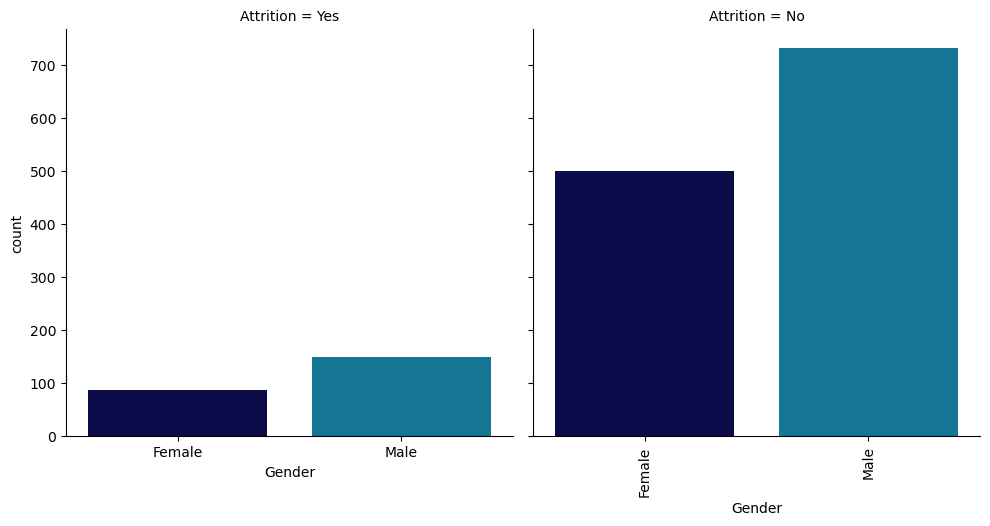

In [96]:
plt.figure(figsize=(8, 6))
sns.catplot(x='Gender', col='Attrition', palette='ocean', kind='count', data=df)
plt.xticks(rotation=90)
plt.show()


Female employees are less likely to experience attrition.

<Figure size 1000x800 with 0 Axes>

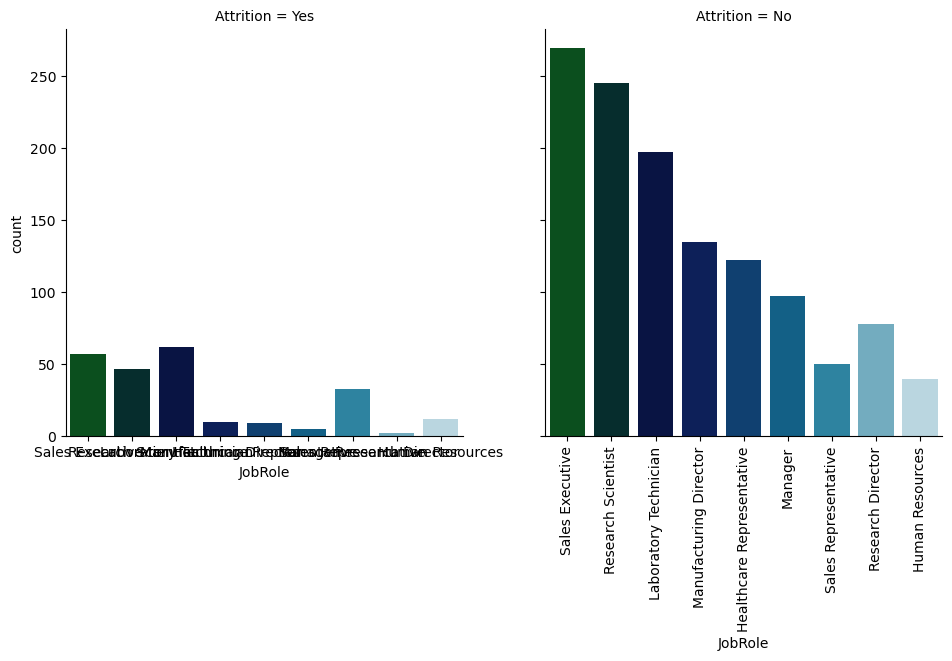

In [97]:
plt.figure(figsize=(10, 8))
sns.catplot(x='JobRole', col='Attrition', palette='ocean', kind='count', data=df)
plt.xticks(rotation=90)
plt.show()


Employees with a Research Director role are less likely to experience attrition.

<Figure size 800x600 with 0 Axes>

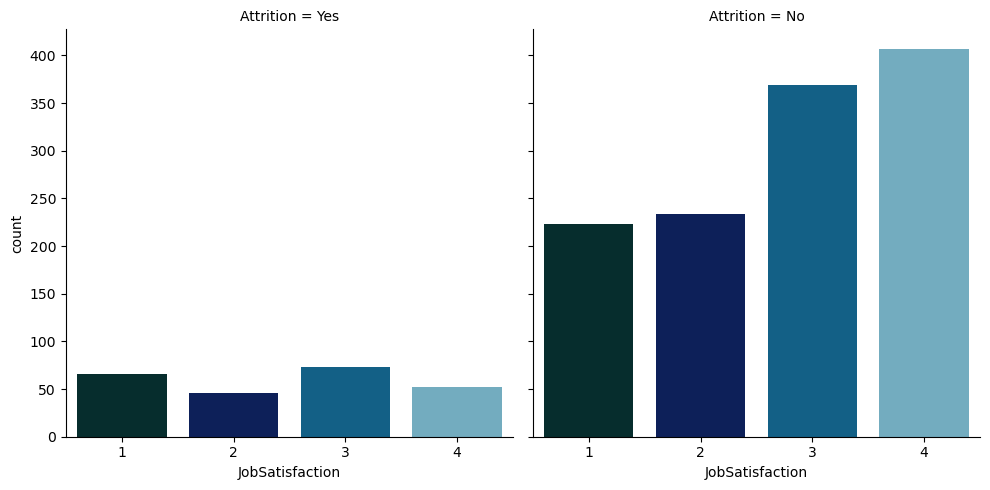

In [98]:
plt.figure(figsize=(8, 6))
sns.catplot(x='JobSatisfaction', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Employees with a job satisfaction category of 2 are less likely to experience attrition.

<Figure size 800x600 with 0 Axes>

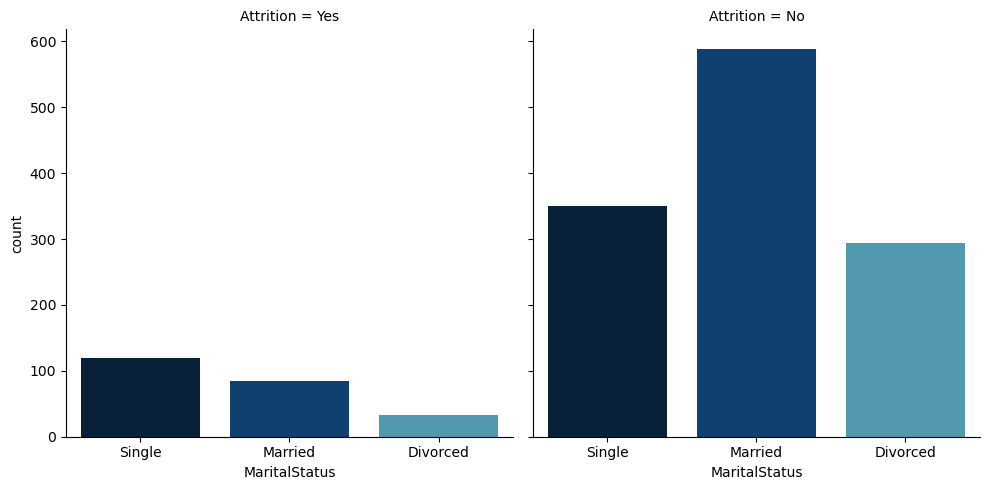

In [99]:
plt.figure(figsize=(8, 6))
sns.catplot(x='MaritalStatus', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Divorced employees are less prone to attrition compared to single employees. Single employees, on the other hand, are more susceptible to attrition.

<Figure size 800x600 with 0 Axes>

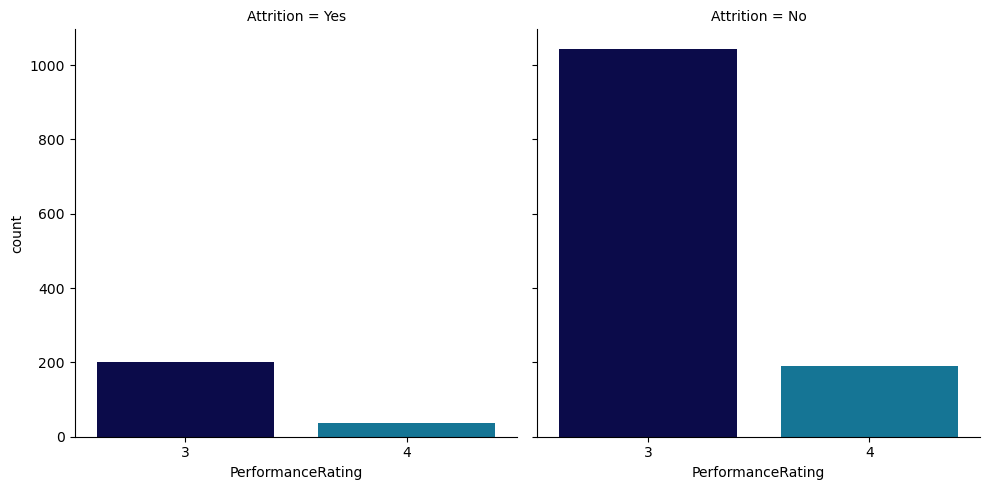

In [100]:
plt.figure(figsize=(8, 6))
sns.catplot(x='PerformanceRating', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Performance rating 3 seems to correlate with higher attrition rates among employees.

<Figure size 800x600 with 0 Axes>

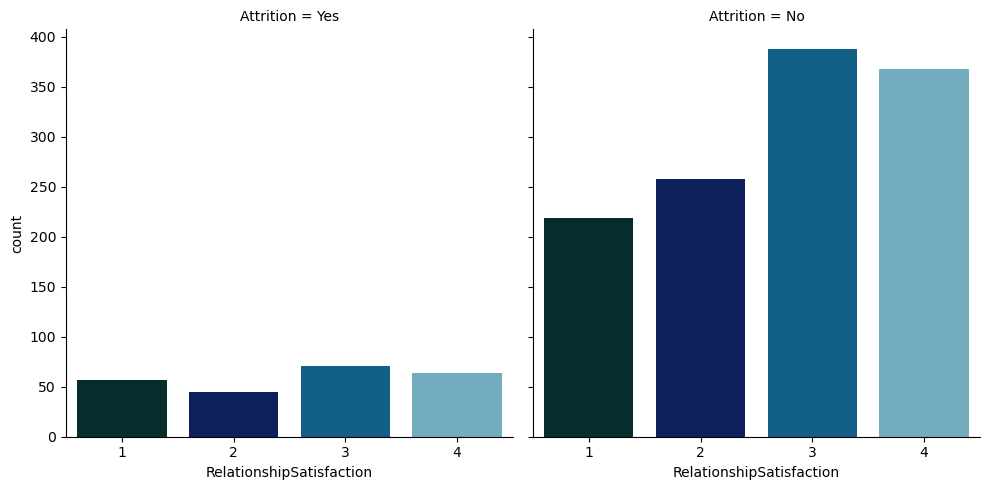

In [101]:
plt.figure(figsize=(8, 6))
sns.catplot(x='RelationshipSatisfaction', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Employees categorized with relationship satisfaction level 3 appear to be more susceptible to attrition, while those in category 2 seem to exhibit lower propensity towards attrition.

<Figure size 800x600 with 0 Axes>

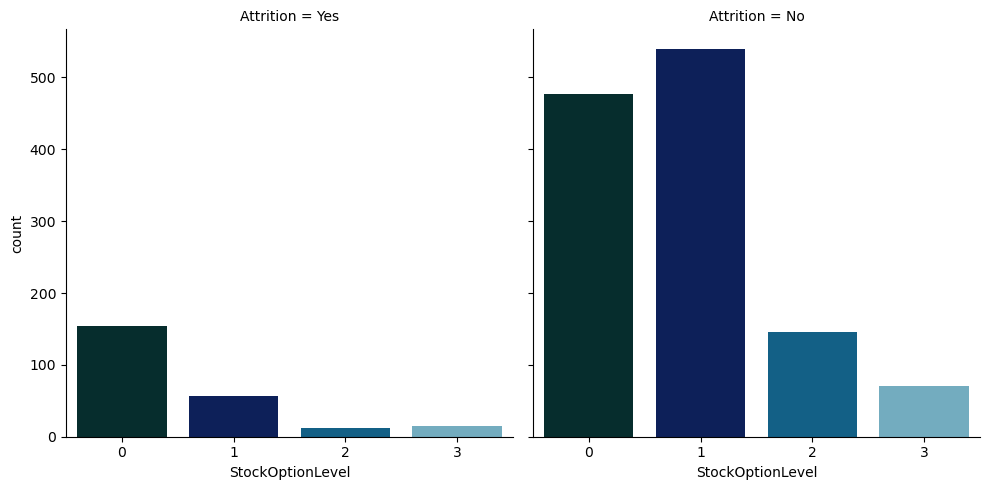

In [102]:
plt.figure(figsize=(8, 6))
sns.catplot(x='StockOptionLevel', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Employees assigned to stock option level category 0 appear to demonstrate a higher tendency towards attrition.

<Figure size 800x600 with 0 Axes>

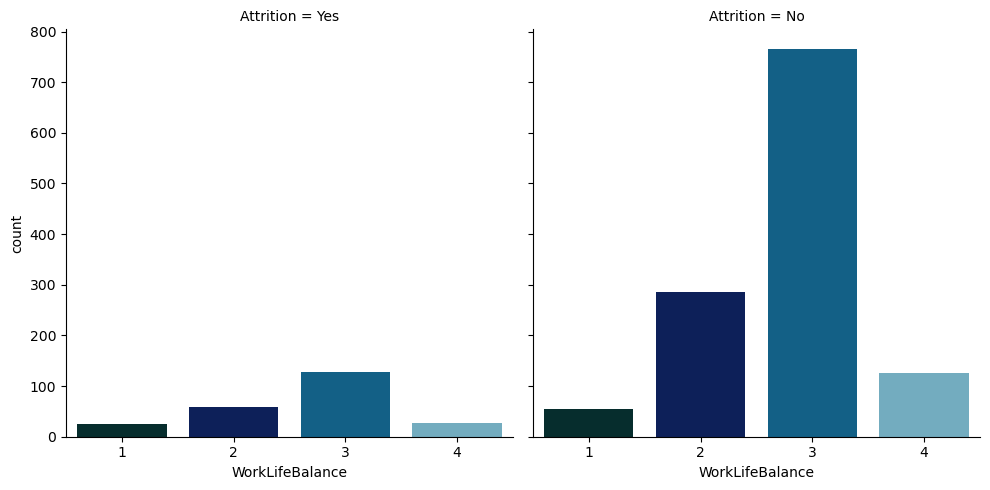

In [103]:
plt.figure(figsize=(8, 6))
sns.catplot(x='WorkLifeBalance', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Employees categorized with work-life balance level 3 seem to exhibit a higher likelihood of experiencing attrition.

<Figure size 800x600 with 0 Axes>

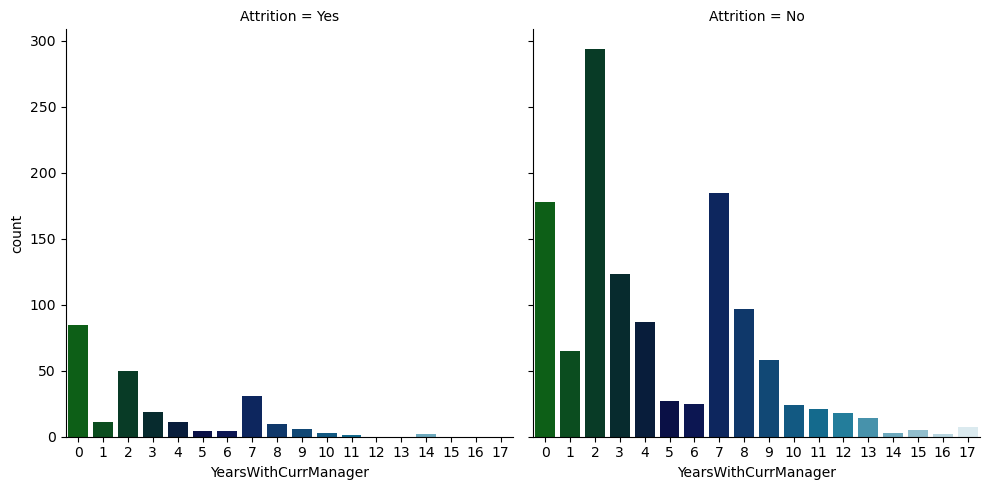

In [104]:
plt.figure(figsize=(8, 6))
sns.catplot(x='YearsWithCurrManager', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Employees who have been with their current manager for 0 years appear to have a higher propensity for attrition. However, as the duration of years with the current manager increases, employees seem to become less prone to attrition.

<Figure size 800x600 with 0 Axes>

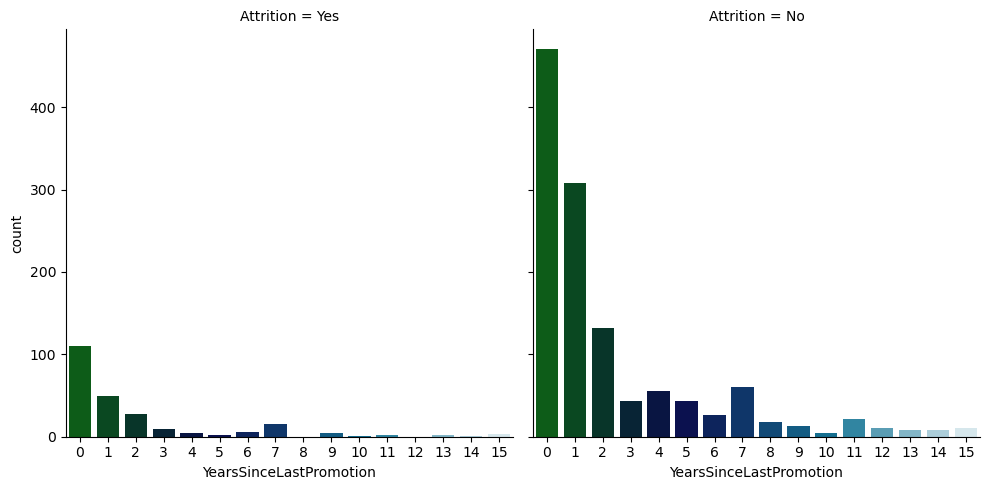

In [105]:
plt.figure(figsize=(8, 6))
sns.catplot(x='YearsSinceLastPromotion', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Among employees, those with 0 years since their last promotion appear to be more susceptible to attrition.

<Figure size 800x600 with 0 Axes>

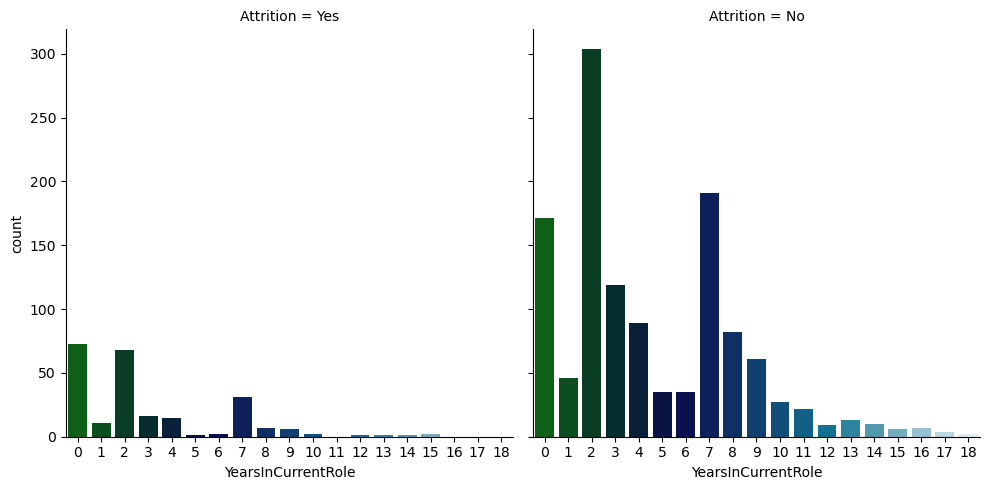

In [106]:
plt.figure(figsize=(8, 6))
sns.catplot(x='YearsInCurrentRole', col='Attrition', palette='ocean', kind='count', data=df)
plt.show()


Employees who have spent 2 years in their current role seem to be less susceptible to attrition, whereas those with 0 years in their current role appear to have a higher likelihood of experiencing attrition.

<Figure size 800x600 with 0 Axes>

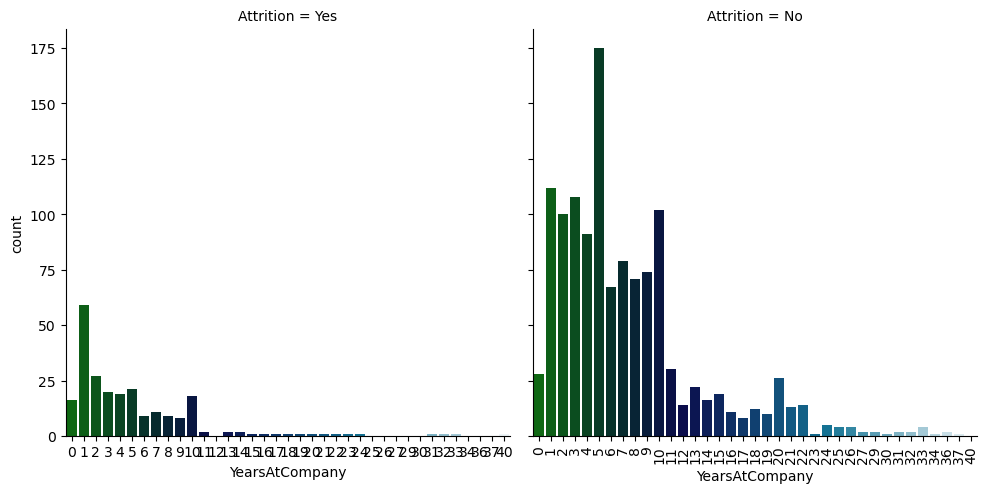

In [107]:
plt.figure(figsize=(8, 6))
sns.catplot(x='YearsAtCompany', col='Attrition', palette='ocean', kind='count', data=df)
plt.xticks(rotation=90)
plt.show()


Employees who have spent 5 years at the company appear to be less prone to attrition, whereas those with 1 year at the company seem to be more susceptible to attrition.

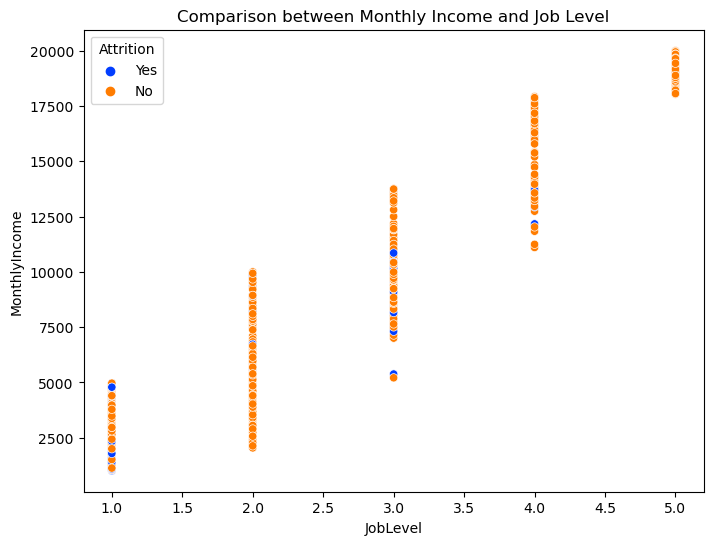

In [108]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='JobLevel', y='MonthlyIncome', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Monthly Income and Job Level')
plt.show()


There appears to be a strong positive correlation between monthly income and job level.

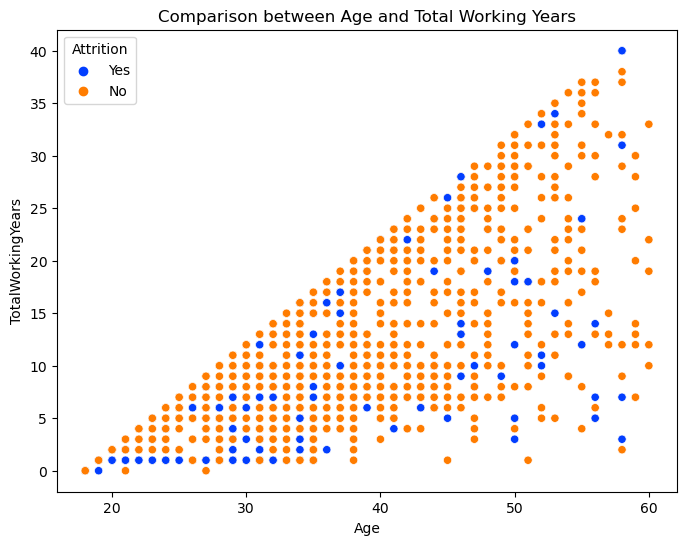

In [109]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='Age', y='TotalWorkingYears', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Age and Total Working Years')
plt.show()


The graph illustrates a noticeable positive relationship between age and total working years.

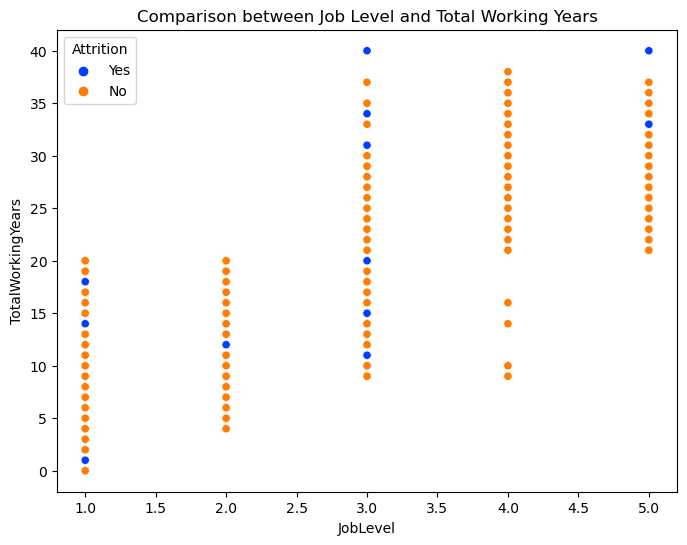

In [110]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='JobLevel', y='TotalWorkingYears', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Job Level and Total Working Years')
plt.show()


The graph indeed demonstrates a notable positive relationship between job level and total working years.

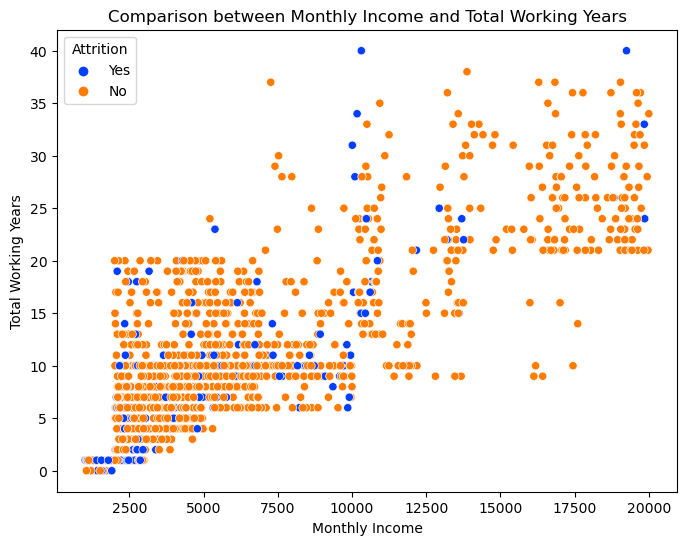

In [111]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='MonthlyIncome', y='TotalWorkingYears', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Monthly Income and Total Working Years')
plt.xlabel('Monthly Income')
plt.ylabel('Total Working Years')
plt.show()


The graph above illustrates a clear positive correlation between Monthly Income and Total Working Years.

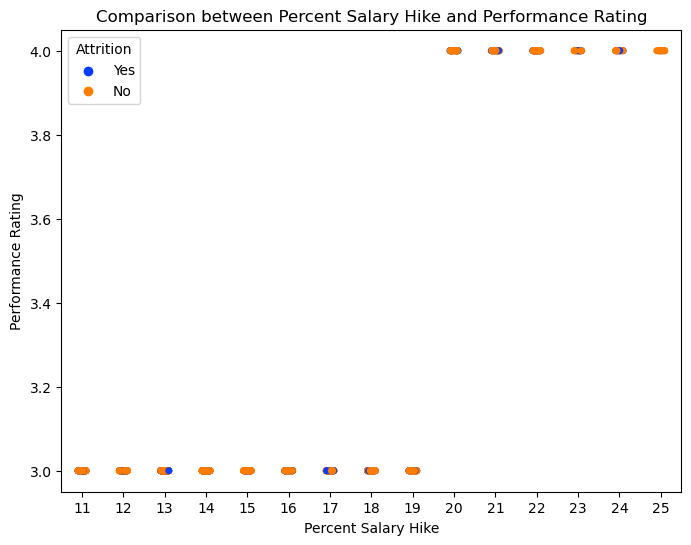

In [112]:
plt.figure(figsize=(8, 6))
sns.stripplot(x='PercentSalaryHike', y='PerformanceRating', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Percent Salary Hike and Performance Rating')
plt.xlabel('Percent Salary Hike')
plt.ylabel('Performance Rating')
plt.show()


The graph above illustrates a noticeable positive relationship between Performance Rating and Percent Salary Hike.

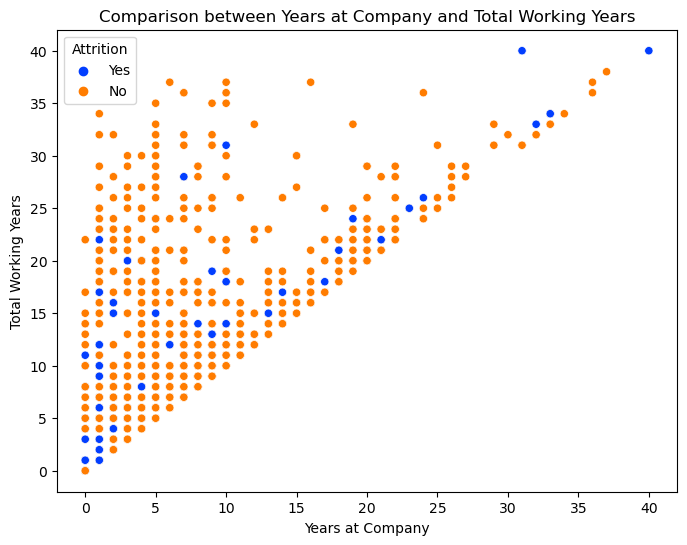

In [113]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='YearsAtCompany', y='TotalWorkingYears', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Years at Company and Total Working Years')
plt.xlabel('Years at Company')
plt.ylabel('Total Working Years')
plt.show()


The graph above depicts a clear positive relationship between Total Working Years and Years at Company.

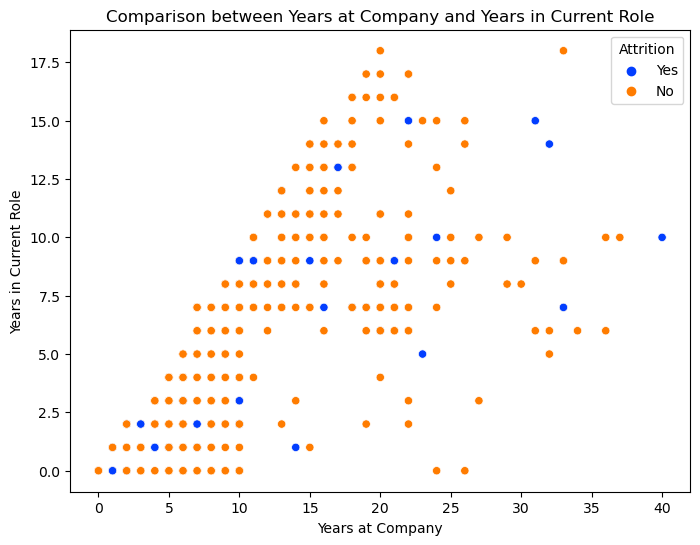

In [114]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='YearsAtCompany', y='YearsInCurrentRole', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Years at Company and Years in Current Role')
plt.xlabel('Years at Company')
plt.ylabel('Years in Current Role')
plt.show()


The graph above illustrates a notable positive correlation between Years at Company and Years in Current Role.

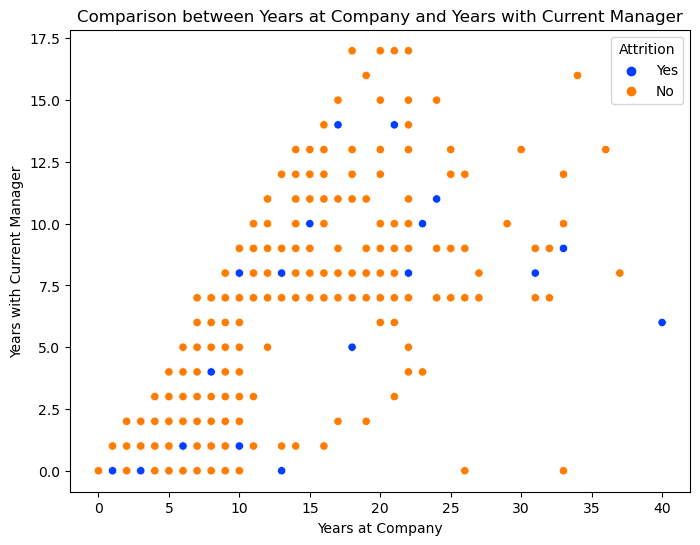

In [115]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='YearsAtCompany', y='YearsWithCurrManager', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Years at Company and Years with Current Manager')
plt.xlabel('Years at Company')
plt.ylabel('Years with Current Manager')
plt.show()


The graph above illustrates a strong positive correlation between Years at Company and Years with Current Manager.

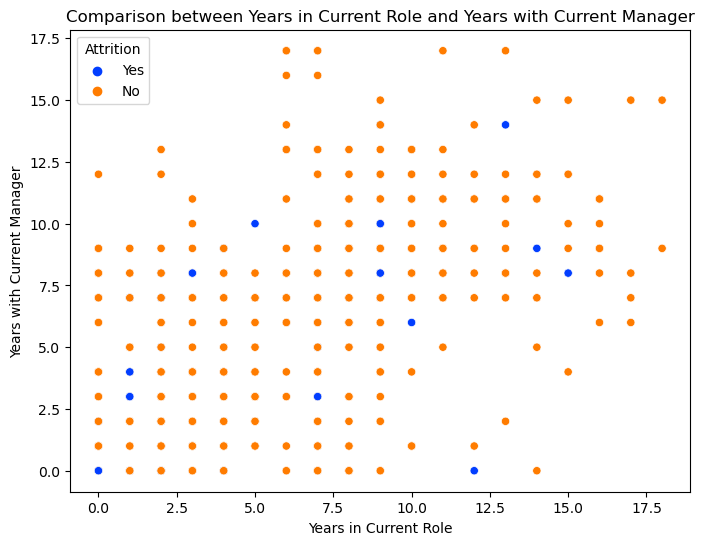

In [116]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='YearsInCurrentRole', y='YearsWithCurrManager', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Years in Current Role and Years with Current Manager')
plt.xlabel('Years in Current Role')
plt.ylabel('Years with Current Manager')
plt.show()


The graph above demonstrates a noticeable positive correlation between Years with Current Manager and Years in Current Role.

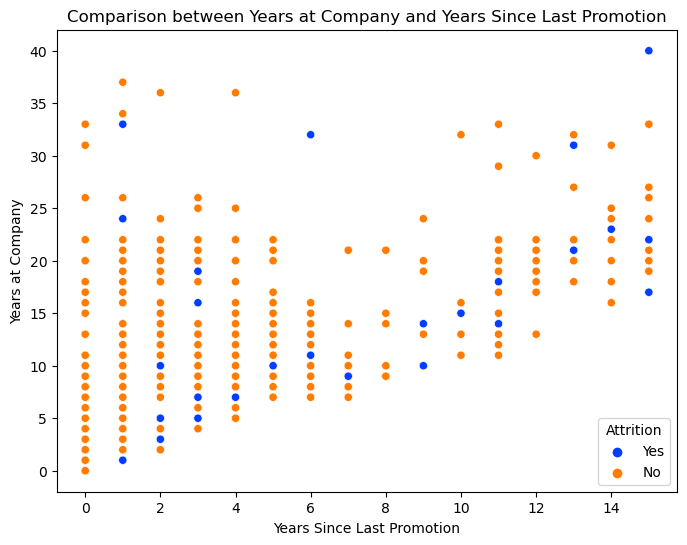

In [117]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='YearsSinceLastPromotion', y='YearsAtCompany', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Years at Company and Years Since Last Promotion')
plt.xlabel('Years Since Last Promotion')
plt.ylabel('Years at Company')
plt.show()


The graph above depicts a clear positive relationship between Years at Company and Years Since Last Promotion.

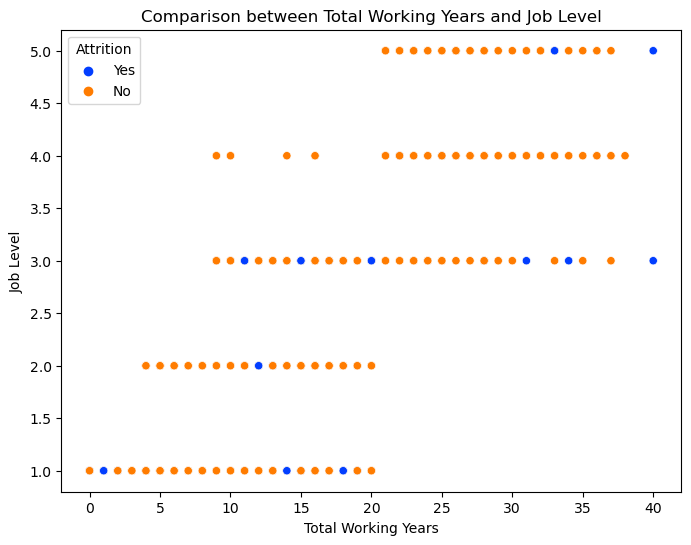

In [118]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='TotalWorkingYears', y='JobLevel', data=df, hue='Attrition', palette='bright')
plt.title('Comparison between Total Working Years and Job Level')
plt.xlabel('Total Working Years')
plt.ylabel('Job Level')
plt.show()


The graph above illustrates a clear positive relationship between Job Level and Total Working Years.

# 3.Mutivariate analysis

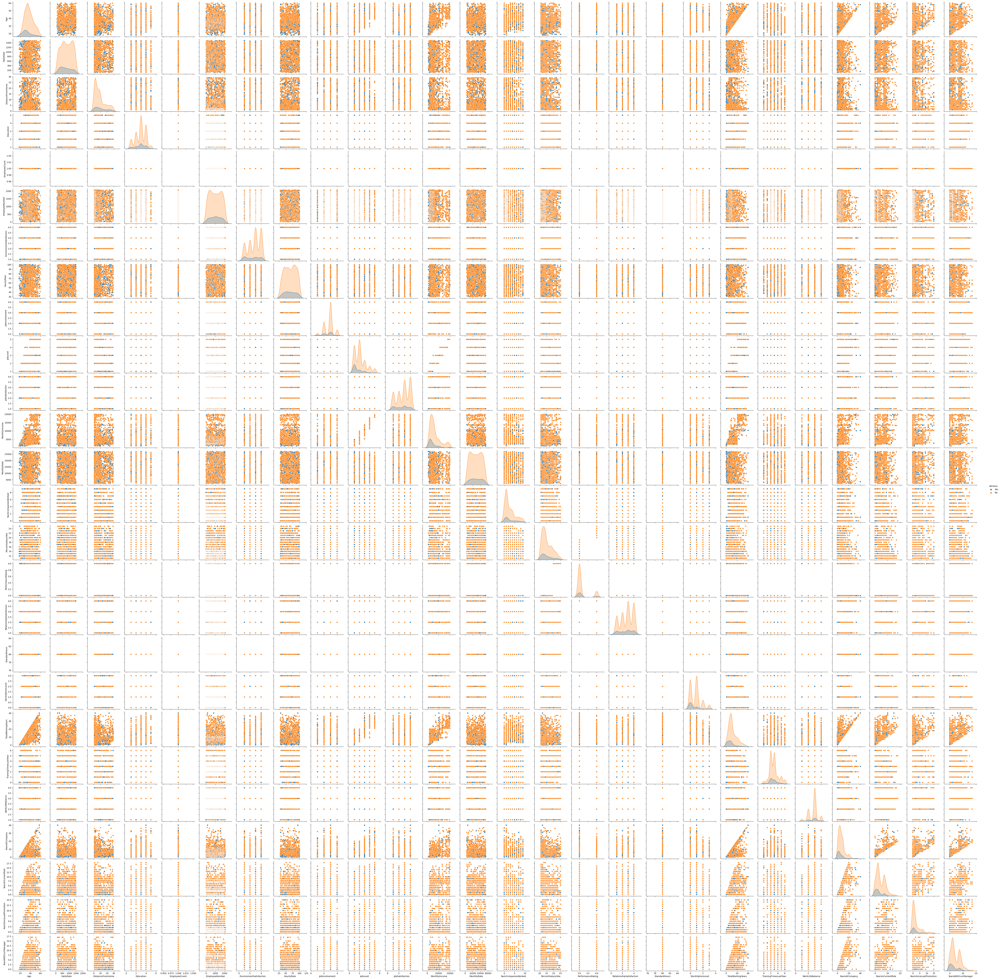

In [119]:
sns.pairplot(df, hue='Attrition')
plt.show()


In [4]:
x = df.drop(columns='Attrition', axis=1)


In [5]:
df.shape

(1470, 35)

In [6]:
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


In [7]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()

In [8]:
categorical_columns = ['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime']

In [9]:
for col in categorical_columns:
    df[col] = label_encoder.fit_transform(df[col])

In [10]:
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,2,1102,2,1,2,1,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,0,1,279,1,8,1,1,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,1,2,1373,1,2,2,4,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,0,1,1392,1,3,4,1,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,0,2,591,1,2,1,3,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,0,1,884,1,23,2,3,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,0,2,613,1,6,1,3,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,0,2,155,1,4,3,1,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,0,1,1023,2,2,3,3,1,2065,...,4,80,0,17,3,2,9,6,0,8


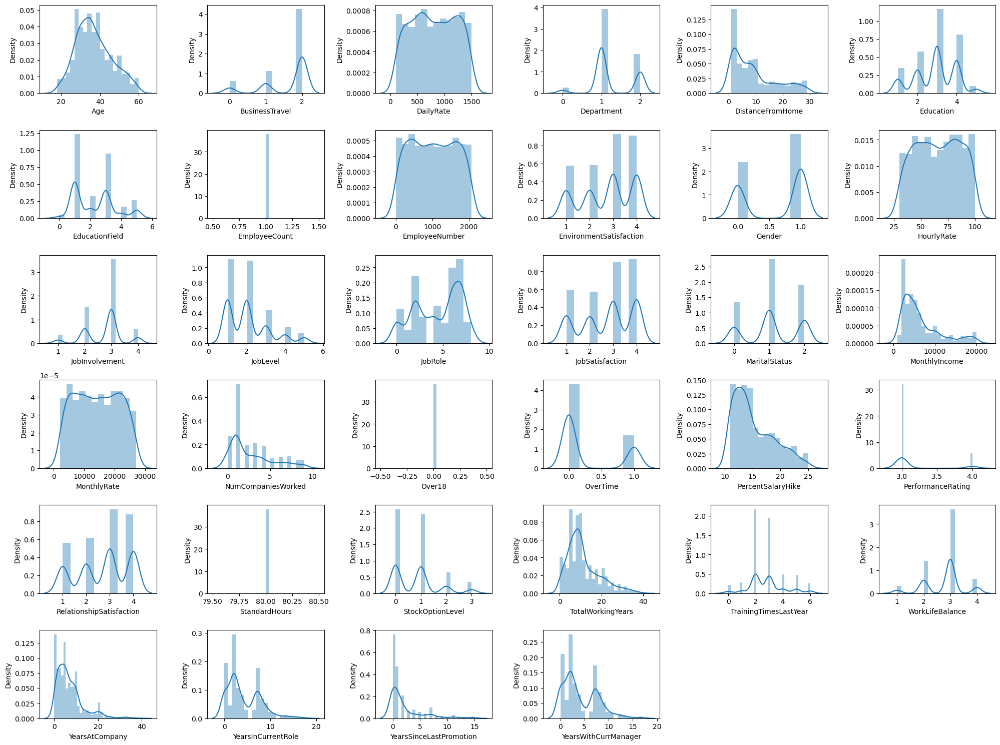

In [132]:
plt.figure(figsize=(20, 15))
plotnumber = 1

for column in x.columns:
    if plotnumber <= 35:
        ax = plt.subplot(6, 6, plotnumber)
        sns.distplot(df[column])
        plt.xlabel(column)
    plotnumber += 1   

plt.tight_layout()
plt.show()


In [133]:
df.skew()

Age                         0.413286
Attrition                   1.844366
BusinessTravel             -1.439006
DailyRate                  -0.003519
Department                  0.172231
DistanceFromHome            0.958118
Education                  -0.289681
EducationField              0.550371
EmployeeCount               0.000000
EmployeeNumber              0.016574
EnvironmentSatisfaction    -0.321654
Gender                     -0.408665
HourlyRate                 -0.032311
JobInvolvement             -0.498419
JobLevel                    1.025401
JobRole                    -0.357270
JobSatisfaction            -0.329672
MaritalStatus              -0.152175
MonthlyIncome               1.369817
MonthlyRate                 0.018578
NumCompaniesWorked          1.026471
Over18                      0.000000
OverTime                    0.964489
PercentSalaryHike           0.821128
PerformanceRating           1.921883
RelationshipSatisfaction   -0.302828
StandardHours               0.000000
S

Upon cross-checking, it has been confirmed that skewness exists in columns such as 
- Attrition: 1.844366
- BusinessTravel: -1.439006
- DistanceFromHome: 0.958118
- EducationField: 0.550371
- JobLevel: 1.025401
- MonthlyIncome: 1.369817
- NumCompaniesWorked: 1.026471
- YearsAtCompany: 1.764529
- YearsSinceLastPromotion: 1.984290

These columns exhibit significant skewness beyond the specified threshold. Consider applying transformation techniques to make their distributions more symmetrical, if necessary, for your analysis or modeling purposes.

# Using the Power Transformer method, we aim to eliminate skewness from the dataset.

In [11]:
from sklearn.preprocessing import PowerTransformer
skewed_columns = ['BusinessTravel', 'DistanceFromHome', 'EducationField', 
                  'JobLevel', 'MonthlyIncome', 'NumCompaniesWorked', 'YearsAtCompany', 
                  'YearsSinceLastPromotion']
x = PowerTransformer(method='yeo-johnson')
df[skewed_columns] = x.fit_transform(df[skewed_columns].values)


In [12]:
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,0.635468,1102,2,-1.494085,2,-0.960488,1,1,...,1,80,0,8,0,1,0.139692,4,-1.094862,5
1,49,0,-1.392865,279,1,0.243416,1,-0.960488,1,2,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,1,0.635468,1373,1,-1.031215,2,1.247620,1,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,0,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0,0.635468,591,1,-1.031215,1,0.697390,1,7,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,0,-1.392865,884,1,1.407126,2,0.697390,1,2061,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1466,39,0,0.635468,613,1,-0.050827,1,0.697390,1,2062,...,1,80,1,9,5,3,0.320677,7,0.096854,7
1467,27,0,0.635468,155,1,-0.442291,3,-0.960488,1,2064,...,2,80,1,6,0,3,0.139692,2,-1.094862,3
1468,49,0,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


In [13]:
x = df.drop(columns='Attrition', axis=1)

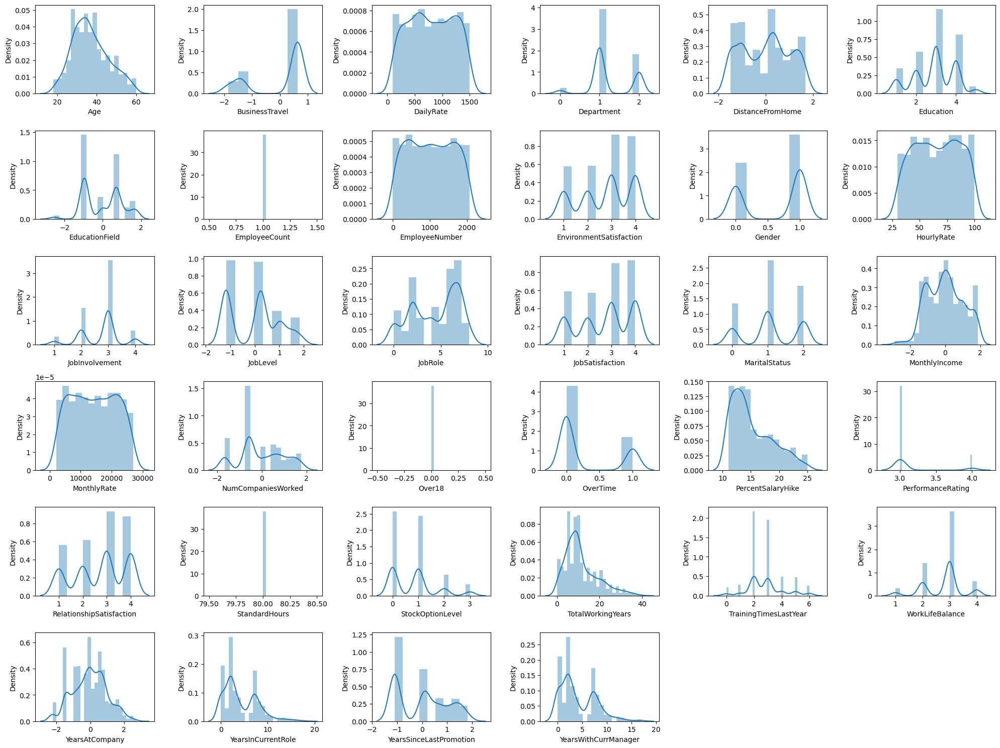

In [139]:
plt.figure(figsize=(20, 15))
plotnumber = 1

for column in x.columns:
    if plotnumber <= 35:
        ax = plt.subplot(6, 6, plotnumber)
        sns.distplot(df[column])
        plt.xlabel(column)
    plotnumber += 1   

plt.tight_layout()
plt.show()


In [140]:
df.skew()

Age                         0.413286
Attrition                   1.844366
BusinessTravel             -0.970506
DailyRate                  -0.003519
Department                  0.172231
DistanceFromHome           -0.007468
Education                  -0.289681
EducationField             -0.008386
EmployeeCount               0.000000
EmployeeNumber              0.016574
EnvironmentSatisfaction    -0.321654
Gender                     -0.408665
HourlyRate                 -0.032311
JobInvolvement             -0.498419
JobLevel                    0.103624
JobRole                    -0.357270
JobSatisfaction            -0.329672
MaritalStatus              -0.152175
MonthlyIncome               0.032831
MonthlyRate                 0.018578
NumCompaniesWorked          0.014814
Over18                      0.000000
OverTime                    0.964489
PercentSalaryHike           0.821128
PerformanceRating           1.921883
RelationshipSatisfaction   -0.302828
StandardHours               0.000000
S

We can conclude that skewness has been successfully eliminated from the dataset.

# Outliers

In [30]:
df2=df

In [31]:
df2

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,0.635468,1102,2,-1.494085,2,-0.960488,1,1,...,1,80,0,8,0,1,0.139692,4,-1.094862,5
1,49,0,-1.392865,279,1,0.243416,1,-0.960488,1,2,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,1,0.635468,1373,1,-1.031215,2,1.247620,1,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,0,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0,0.635468,591,1,-1.031215,1,0.697390,1,7,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,0,-1.392865,884,1,1.407126,2,0.697390,1,2061,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1466,39,0,0.635468,613,1,-0.050827,1,0.697390,1,2062,...,1,80,1,9,5,3,0.320677,7,0.096854,7
1467,27,0,0.635468,155,1,-0.442291,3,-0.960488,1,2064,...,2,80,1,6,0,3,0.139692,2,-1.094862,3
1468,49,0,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


In [141]:
df.dtypes

Age                           int64
Attrition                   float64
BusinessTravel              float64
DailyRate                     int64
Department                    int32
DistanceFromHome            float64
Education                     int64
EducationField              float64
EmployeeCount                 int64
EmployeeNumber                int64
EnvironmentSatisfaction       int64
Gender                        int32
HourlyRate                    int64
JobInvolvement                int64
JobLevel                    float64
JobRole                       int32
JobSatisfaction               int64
MaritalStatus                 int32
MonthlyIncome               float64
MonthlyRate                   int64
NumCompaniesWorked          float64
Over18                        int32
OverTime                      int32
PercentSalaryHike             int64
PerformanceRating             int64
RelationshipSatisfaction      int64
StandardHours                 int64
StockOptionLevel            

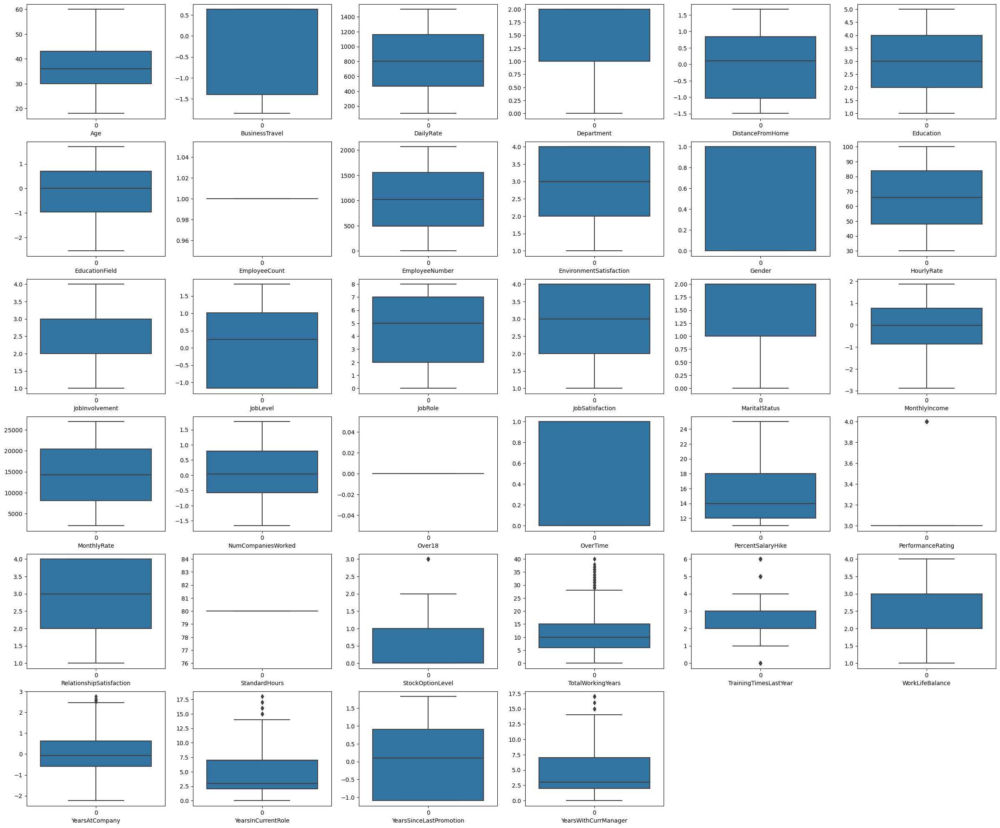

In [142]:
plt.figure(figsize=(30,25))
plotnumber=1


for column in x.columns:
    if plotnumber<=35:
        ax=plt.subplot(6,6,plotnumber)
        sns.boxplot(df[column])
        plt.xlabel(column)
    plotnumber+=1   
plt.show() 

We observe the presence of outliers in the columns: StockOptionLevel, TotalWorkingYears, TrainingTimesLastYear,YearsAtCompany,YearsInCurrentRole,YearsWithCurrManager.

In [143]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

# Removing outliers using the IQR method:

In [273]:
# Exclude non-numeric columns from the DataFrame
numeric_df = df.select_dtypes(include=['float64', 'int64'])

# Calculate quartiles
q1 = numeric_df.quantile(0.25)
q3 = numeric_df.quantile(0.75)

# Calculate interquartile range (IQR)
IQR = q3 - q1

# Calculate upper and lower bounds for outliers
# upper_bound = q3 + (1.5 * IQR)
# lower_bound = q1 - (1.5 * IQR)

In [274]:
# StockOptionLevel

In [275]:
high_StockOptionLevel=(q3['StockOptionLevel']+(1.5*IQR['StockOptionLevel']))


index=np.where(df['StockOptionLevel']> high_StockOptionLevel)

df=df.drop(df.index[index])

In [276]:
# TotalWorkingYears

In [277]:
high_TotalWorkingYears=(q3['TotalWorkingYears']+(1.5*IQR['TotalWorkingYears']))


index=np.where(df['TotalWorkingYears']> high_TotalWorkingYears)

df=df.drop(df.index[index])

In [278]:
# TrainingTimesLastYear

In [279]:
high_TrainingTimesLastYear=(q3['TrainingTimesLastYear']+(1.5*IQR['TrainingTimesLastYear']))


index=np.where(df['TrainingTimesLastYear']> high_TrainingTimesLastYear)

df=df.drop(df.index[index])

In [280]:

TrainingTimesLastYear_low = q1['TrainingTimesLastYear'] - (1.5 * IQR['TrainingTimesLastYear'])

index = np.where(df['TrainingTimesLastYear'] < TrainingTimesLastYear_low)


df = df.drop(df.index[index])


In [281]:
# YearsAtCompany

In [282]:
high_YearsAtCompany=(q3['YearsAtCompany']+(1.5*IQR['YearsAtCompany']))


index=np.where(df['YearsAtCompany']> high_YearsAtCompany)

df=df.drop(df.index[index])

In [283]:
# YearsInCurrentRole

In [284]:
high_YearsInCurrentRole=(q3['YearsInCurrentRole']+(1.5*IQR['YearsInCurrentRole']))


index=np.where(df['YearsInCurrentRole']> high_YearsInCurrentRole)

df=df.drop(df.index[index])

In [285]:
# YearsWithCurrManager

In [286]:
high_YearsWithCurrManager=(q3['YearsWithCurrManager']+(1.5*IQR['YearsWithCurrManager']))


index=np.where(df['YearsWithCurrManager']> high_YearsWithCurrManager)

df=df.drop(df.index[index])

In [287]:
df.reset_index()

,index,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,1,49,0,-1.392865,279,1,0.243416,1,-0.960488,1,...,4,80,1,10,3,3,0.762660,7,0.096854,7
1,2,37,1,0.635468,1373,1,-1.031215,2,1.247620,1,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
2,3,33,0,-1.392865,1392,1,-0.700347,4,-0.960488,1,...,3,80,0,8,3,3,0.482432,7,0.905592,0
3,4,27,0,0.635468,591,1,-1.031215,1,0.697390,1,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
4,5,32,0,-1.392865,1005,1,-1.031215,2,-0.960488,1,...,3,80,0,8,2,2,0.320677,7,0.905592,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1081,1463,31,0,-1.846466,325,1,-0.230523,3,0.697390,1,...,2,80,0,10,2,3,0.628829,4,0.096854,7
1082,1464,26,0,0.635468,1167,2,-0.230523,3,1.247620,1,...,4,80,0,5,2,3,-0.305280,2,-1.094862,0
1083,1465,36,0,-1.392865,884,1,1.407126,2,0.697390,1,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1084,1468,49,0,-1.392865,1023,2,-1.031215,3,0.697390,1,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


# Data Loss-

In [341]:
(1470-1086)/1470*100

26.122448979591837

Although the data loss is higher than the acceptable range, standing at 27%, we'll still proceed to build one model using this data.

In [288]:
x = df.drop(columns='Attrition', axis=1)

In [289]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

In [290]:
x.columns

Index(['Age', 'BusinessTravel', 'DailyRate', 'Department', 'DistanceFromHome',
       'Education', 'EducationField', 'EmployeeCount', 'EmployeeNumber',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'Over18',
       'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

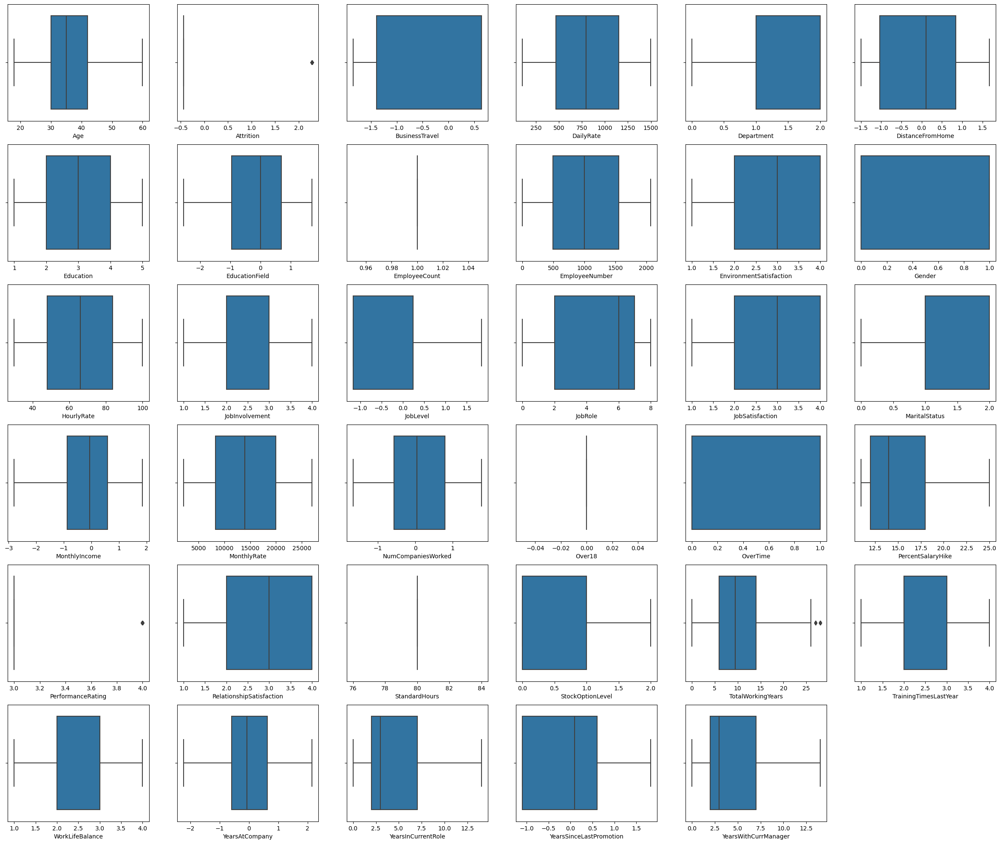

In [168]:
plt.figure(figsize=(30, 25))
plotnumber = 1

for column in df.columns:
    if plotnumber <= 35:
        ax = plt.subplot(6, 6, plotnumber)
        sns.boxplot(x=df[column])
        plt.xlabel(column)
    plotnumber += 1   

plt.show()


# Outliers removed using the Z-score method.

In [44]:
df1=df2

In [45]:
df1

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,0.635468,1102,2,-1.494085,2,-0.960488,1,1,...,1,80,0,8,0,1,0.139692,4,-1.094862,5
1,49,0,-1.392865,279,1,0.243416,1,-0.960488,1,2,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,1,0.635468,1373,1,-1.031215,2,1.247620,1,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,0,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0,0.635468,591,1,-1.031215,1,0.697390,1,7,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,0,-1.392865,884,1,1.407126,2,0.697390,1,2061,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1466,39,0,0.635468,613,1,-0.050827,1,0.697390,1,2062,...,1,80,1,9,5,3,0.320677,7,0.096854,7
1467,27,0,0.635468,155,1,-0.442291,3,-0.960488,1,2064,...,2,80,1,6,0,3,0.139692,2,-1.094862,3
1468,49,0,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


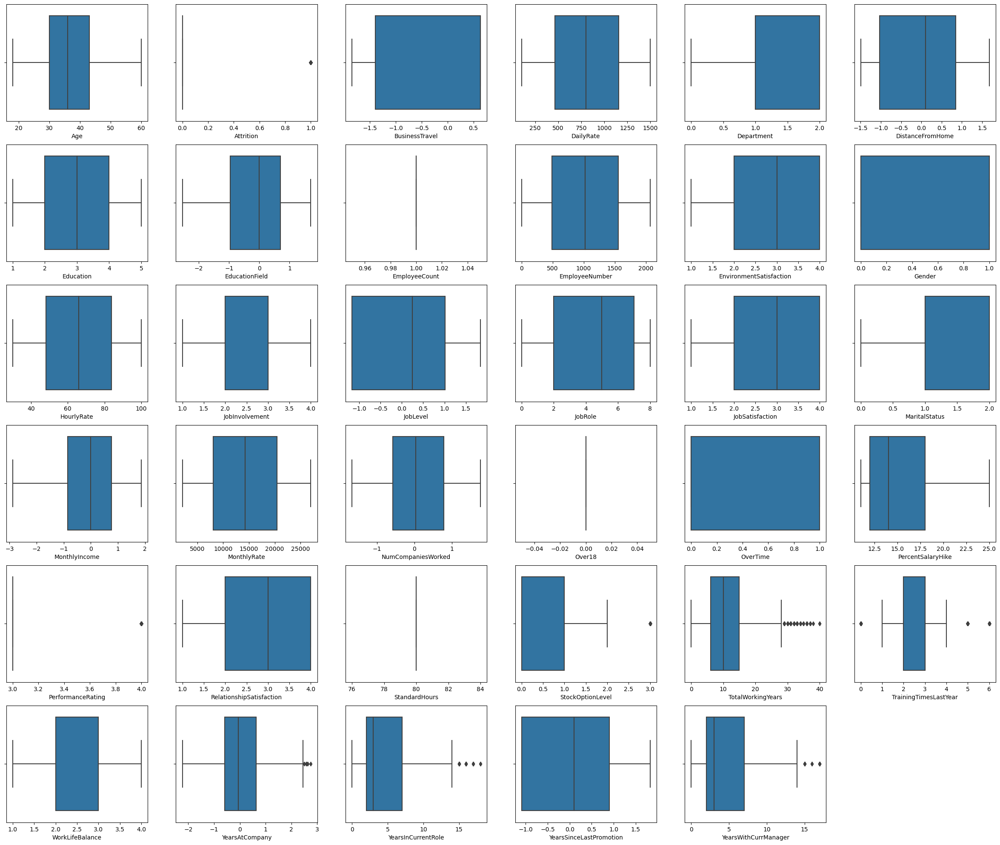

In [49]:
plt.figure(figsize=(30, 25))
plotnumber = 1

for column in df1.columns:
    if plotnumber <= 35:
        ax = plt.subplot(6, 6, plotnumber)
        sns.boxplot(x=df[column])
        plt.xlabel(column)
    plotnumber += 1   

plt.show()

In [50]:
from scipy.stats import zscore
out_features=df[['StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear','YearsAtCompany','YearsInCurrentRole','YearsWithCurrManager']]
z=np.abs(zscore(out_features))  
z

,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsInCurrentRole,YearsWithCurrManager
0,0.932014,0.421642,2.171982,0.139692,0.063296,0.245834
1,0.241988,0.164511,0.155707,0.762660,0.764998,0.806541
2,0.932014,0.550208,0.155707,2.229592,1.167687,1.155935
3,0.932014,0.421642,0.155707,0.482432,0.764998,1.155935
4,0.241988,0.678774,0.155707,0.951540,0.615492,0.595227
...,...,...,...,...,...,...
1465,0.241988,0.735447,0.155707,0.066114,0.615492,0.314873
1466,0.241988,0.293077,1.707500,0.320677,0.764998,0.806541
1467,0.241988,0.678774,2.171982,0.139692,0.615492,0.314873
1468,0.932014,0.735447,0.155707,0.628829,0.488900,1.086895


In [51]:
#threshold=3
np.where(z>3)

(array([  28,   63,   85,   98,  123,  123,  126,  153,  187,  187,  190,
         231,  231,  270,  281,  386,  401,  445,  466,  561,  595,  616,
         624,  635,  686,  716,  746,  875,  894,  926,  956,  976, 1024,
        1043, 1078, 1116, 1184, 1301, 1327, 1348, 1351, 1401, 1430],
       dtype=int64),
 array([5, 4, 1, 1, 4, 5, 1, 5, 1, 5, 4, 4, 5, 1, 4, 5, 1, 1, 4, 5, 1, 5,
        1, 5, 5, 4, 4, 5, 1, 5, 1, 4, 4, 1, 5, 1, 1, 1, 4, 5, 4, 1, 4],
       dtype=int64))

In [52]:
df1=df1[(z<3).all(axis=1)]  
df1.shape

(1430, 35)

In [54]:
(1470-1430)/1470*100

2.7210884353741496

In [291]:
df['Attrition'].value_counts()

Attrition
0    903
1    183
Name: count, dtype: int64

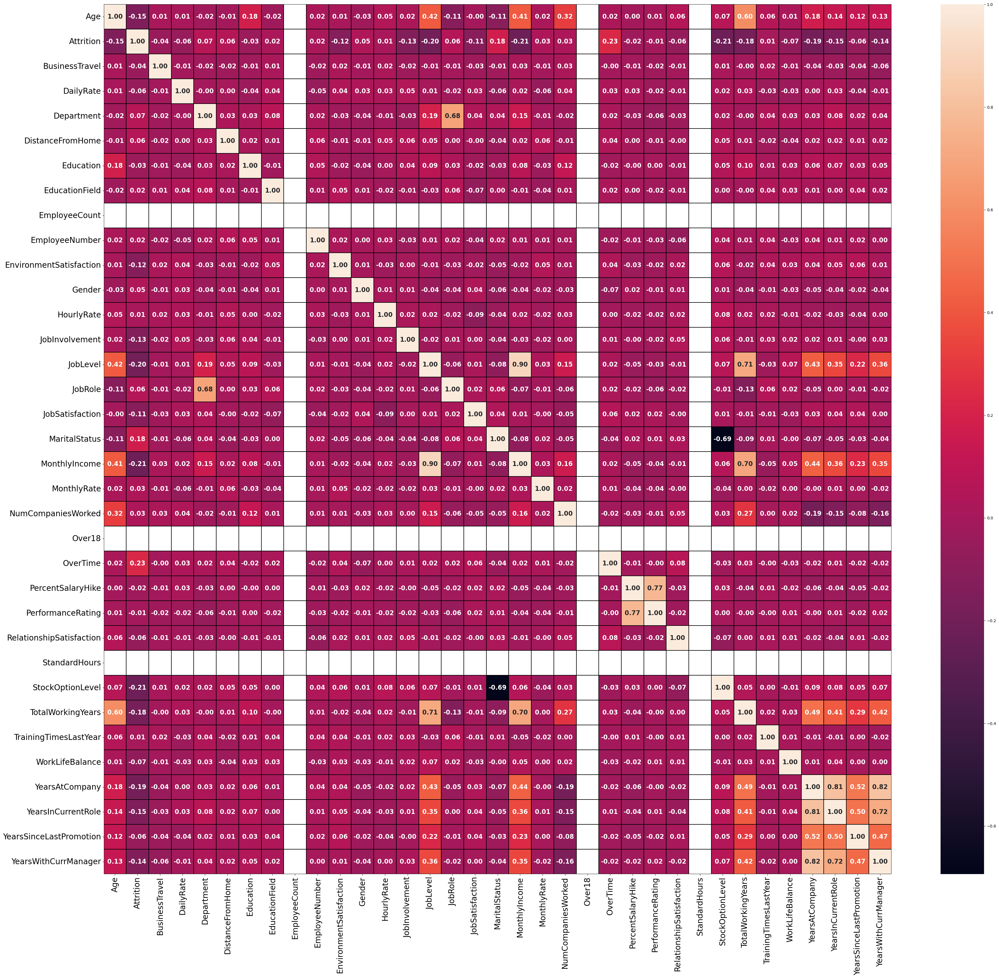

In [177]:
plt.figure(figsize=(45,40))
sns.heatmap(df.corr(),annot=True,fmt='.2f',linecolor='black',linewidth=0.2,annot_kws={'fontsize': 16,'fontweight': 'bold'})
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show() 

# Correlation between features and the target variable:

In [172]:
df.corr()['Attrition'].sort_values(ascending=False).to_frame()

,Attrition
Attrition,1.000000
OverTime,0.229097
MaritalStatus,0.175029
Department,0.070295
DistanceFromHome,0.064825
JobRole,0.055385
Gender,0.045148
MonthlyRate,0.031183
NumCompaniesWorked,0.031071
EducationField,0.021941


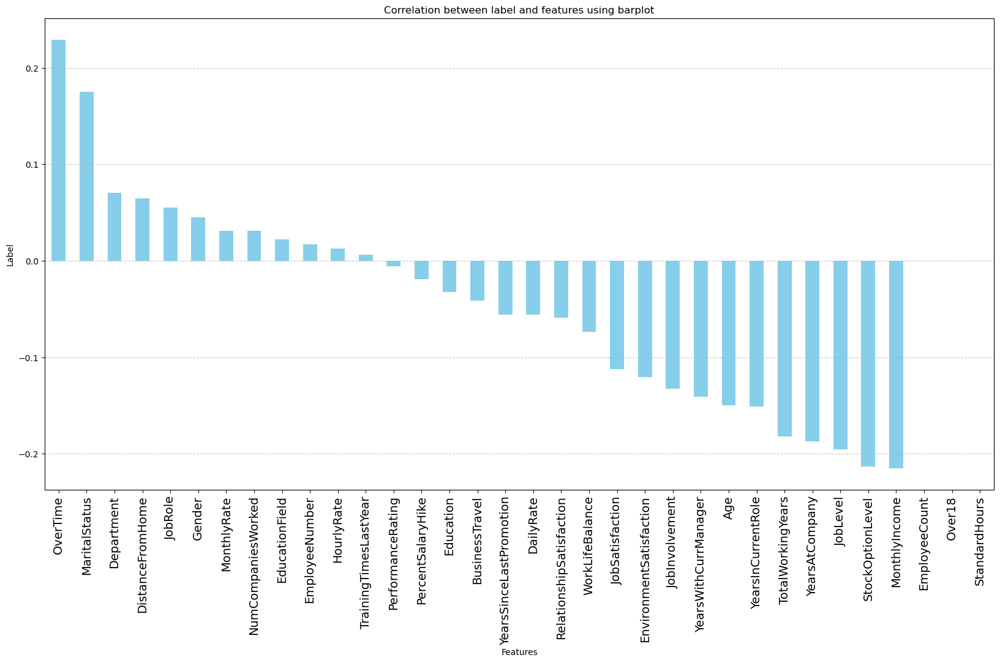

In [173]:
plt.figure(figsize=(20,10))
df.corr()['Attrition'].sort_values(ascending=False).drop(['Attrition']).plot(kind='bar', color='skyblue')
plt.xlabel('Features')
plt.ylabel('Label')
plt.xticks(fontsize=14)
plt.title('Correlation between label and features using barplot')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Model-I: Outliers removed using the IQR method.

In [292]:
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1,49,0,-1.392865,279,1,0.243416,1,-0.960488,1,2,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,1,0.635468,1373,1,-1.031215,2,1.247620,1,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,0,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0,0.635468,591,1,-1.031215,1,0.697390,1,7,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
5,32,0,-1.392865,1005,1,-1.031215,2,-0.960488,1,8,...,3,80,0,8,2,2,0.320677,7,0.905592,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,31,0,-1.846466,325,1,-0.230523,3,0.697390,1,2057,...,2,80,0,10,2,3,0.628829,4,0.096854,7
1464,26,0,0.635468,1167,2,-0.230523,3,1.247620,1,2060,...,4,80,0,5,2,3,-0.305280,2,-1.094862,0
1465,36,0,-1.392865,884,1,1.407126,2,0.697390,1,2061,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1468,49,0,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


# Preparing Data for Machine Learning

# Splitting

Choose the dependent(label)and independent variables.

In [293]:
X = df.drop('Attrition', axis=1)
Y = df['Attrition']

I've split the dataset into features and labels, with X representing all the feature columns and Y representing the target label column.

In [294]:
X

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1,49,-1.392865,279,1,0.243416,1,-0.960488,1,2,3,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,0.635468,1373,1,-1.031215,2,1.247620,1,4,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,4,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0.635468,591,1,-1.031215,1,0.697390,1,7,1,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
5,32,-1.392865,1005,1,-1.031215,2,-0.960488,1,8,4,...,3,80,0,8,2,2,0.320677,7,0.905592,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,31,-1.846466,325,1,-0.230523,3,0.697390,1,2057,2,...,2,80,0,10,2,3,0.628829,4,0.096854,7
1464,26,0.635468,1167,2,-0.230523,3,1.247620,1,2060,4,...,4,80,0,5,2,3,-0.305280,2,-1.094862,0
1465,36,-1.392865,884,1,1.407126,2,0.697390,1,2061,3,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1468,49,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,4,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


In [295]:
Y

1       0
2       1
3       0
4       0
5       0
       ..
1463    0
1464    0
1465    0
1468    0
1469    0
Name: Attrition, Length: 1086, dtype: int32

# Feature Scaling

In [307]:
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)
X 

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,1.600831,-1.450936,-1.303664,-0.611658,0.178002,-2.005200,-1.026219,-1.866801,0.360251,0.802208,...,2.673996,1.313876,0.748697,0.119540,0.633504,0.423833,1.046027,1.136952,0.177620,1.093668
1,0.224747,0.691715,1.576436,-0.611658,-1.153258,-0.939953,1.283836,-1.863208,1.292486,0.802208,...,-0.390080,-0.582566,-0.813903,-0.364820,0.633504,0.423833,-2.146445,-1.128013,-1.080074,-1.092392
2,-0.233948,-1.450936,1.626456,-0.611658,-0.807690,1.190541,-1.026219,-1.861412,1.292486,-1.350206,...,-0.390080,0.365655,-0.813903,-0.203367,0.633504,0.423833,0.747049,1.136952,1.031133,-1.092392
3,-0.921990,0.691715,-0.482283,-0.611658,-1.153258,-2.005200,0.708203,-1.857818,-1.504217,0.802208,...,-0.390080,1.313876,0.748697,-0.526274,0.633504,0.423833,-0.782875,-0.480880,0.716498,-0.467804
4,-0.348622,-1.450936,0.607627,-0.611658,-1.153258,-0.939953,-1.026219,-1.856022,1.292486,0.802208,...,-0.390080,0.365655,-0.813903,-0.203367,-0.775531,-0.943731,0.574470,1.136952,1.031133,0.781373
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1801,-0.334009,0.691715,1.251868,-0.611658,-1.129993,1.190541,-1.026219,1.164907,1.292486,0.802208,...,-0.390080,-1.515683,-0.813903,-1.297537,-0.753087,0.380266,-1.281134,-1.107397,-1.060040,-1.092392
1802,1.964011,0.691715,0.734140,1.303495,-0.022689,0.303266,-1.026219,0.694105,-0.727732,0.802208,...,-0.390080,0.207234,-0.813903,0.254412,-0.775531,-0.943731,0.491442,0.866659,1.461017,0.832790
1803,1.433918,-1.450936,-0.164507,1.263838,0.026503,-0.939953,0.708203,1.136272,1.273182,-1.350206,...,-0.390080,0.326386,2.278940,1.535848,0.604328,0.423833,0.900007,1.136952,1.580688,1.093668
1804,-0.046232,0.691715,0.205331,-0.089572,0.842739,0.415689,1.126913,-0.177271,-1.250082,0.802208,...,-0.390080,-0.324073,0.322719,-0.041913,0.249389,-1.316540,-1.057677,-1.039807,-0.737216,-0.922124


In [297]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['VIF Values']=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif['Features']=X.columns
vif

,VIF Values,Features
0,1.727749,Age
1,1.016769,BusinessTravel
2,1.041393,DailyRate
3,2.190749,Department
4,1.027995,DistanceFromHome
5,1.062996,Education
6,1.032986,EducationField
7,NaN,EmployeeCount
8,1.033363,EmployeeNumber
9,1.033210,EnvironmentSatisfaction


In [298]:
df['EmployeeCount'].value_counts()

EmployeeCount
1    1086
Name: count, dtype: int64

In [299]:
df.shape

(1086, 35)

In [300]:
X

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,1.470915,-1.390678,-1.300624,-0.504251,0.229520,-1.875075,-0.946821,0.0,-1.695335,0.240904,...,1.207850,0.0,0.491795,-0.055533,0.616155,0.342995,0.878216,0.914757,0.132299,0.930906
1,0.082363,0.640578,1.437754,-0.504251,-1.039508,-0.890389,1.240588,0.0,-1.692014,1.162107,...,-0.640952,0.0,-0.979526,-0.525467,0.616155,0.342995,-2.312658,-1.198916,-1.084635,-1.178408
2,-0.380488,-1.390678,1.485313,-0.504251,-0.710094,1.078984,-0.946821,0.0,-1.690353,1.162107,...,0.283449,0.0,-0.979526,-0.368822,0.616155,0.342995,0.579388,0.914757,0.958150,-1.178408
3,-1.074764,0.640578,-0.519660,-0.504251,-1.039508,-1.875075,0.695517,0.0,-1.687032,-1.601503,...,1.207850,0.0,0.491795,-0.682112,0.616155,0.342995,-0.949771,-0.595009,0.653713,-0.575747
4,-0.496201,-1.390678,0.516618,-0.504251,-1.039508,-0.890389,-0.946821,0.0,-1.685372,1.162107,...,0.283449,0.0,-0.979526,-0.368822,-0.711513,-1.041735,0.406895,0.914757,0.958150,0.629576
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1081,-0.611913,-1.844933,-1.185482,-0.504251,-0.242336,0.094298,0.695517,0.0,1.716998,-0.680299,...,-0.640952,0.0,-0.979526,-0.055533,-0.711513,0.342995,0.735502,0.008897,0.132299,0.930906
1082,-1.190477,0.640578,0.922118,1.384082,-0.242336,0.094298,1.240588,0.0,1.721979,1.162107,...,1.207850,0.0,-0.979526,-0.838757,-0.711513,0.342995,-0.260612,-0.595009,-1.084635,-1.178408
1083,-0.033350,-1.390678,0.213744,-0.504251,1.388115,-0.890389,0.695517,0.0,1.723640,0.240904,...,0.283449,0.0,0.491795,1.040982,0.616155,0.342995,-0.005571,-0.595009,-1.084635,-0.274416
1084,1.470915,-1.390678,0.561673,1.384082,-1.039508,0.094298,0.695517,0.0,1.730282,1.162107,...,1.207850,0.0,-0.979526,1.040982,0.616155,-1.041735,0.735502,0.612804,-1.084635,1.232237


In [301]:
X=X.drop(columns=['EmployeeCount','Over18','StandardHours'],axis=1)
X

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,1.470915,-1.390678,-1.300624,-0.504251,0.229520,-1.875075,-0.946821,-1.695335,0.240904,0.795665,...,2.362587,1.207850,0.491795,-0.055533,0.616155,0.342995,0.878216,0.914757,0.132299,0.930906
1,0.082363,0.640578,1.437754,-0.504251,-1.039508,-0.890389,1.240588,-1.692014,1.162107,0.795665,...,-0.423265,-0.640952,-0.979526,-0.525467,0.616155,0.342995,-2.312658,-1.198916,-1.084635,-1.178408
2,-0.380488,-1.390678,1.485313,-0.504251,-0.710094,1.078984,-0.946821,-1.690353,1.162107,-1.256810,...,-0.423265,0.283449,-0.979526,-0.368822,0.616155,0.342995,0.579388,0.914757,0.958150,-1.178408
3,-1.074764,0.640578,-0.519660,-0.504251,-1.039508,-1.875075,0.695517,-1.687032,-1.601503,0.795665,...,-0.423265,1.207850,0.491795,-0.682112,0.616155,0.342995,-0.949771,-0.595009,0.653713,-0.575747
4,-0.496201,-1.390678,0.516618,-0.504251,-1.039508,-0.890389,-0.946821,-1.685372,1.162107,0.795665,...,-0.423265,0.283449,-0.979526,-0.368822,-0.711513,-1.041735,0.406895,0.914757,0.958150,0.629576
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1081,-0.611913,-1.844933,-1.185482,-0.504251,-0.242336,0.094298,0.695517,1.716998,-0.680299,0.795665,...,-0.423265,-0.640952,-0.979526,-0.055533,-0.711513,0.342995,0.735502,0.008897,0.132299,0.930906
1082,-1.190477,0.640578,0.922118,1.384082,-0.242336,0.094298,1.240588,1.721979,1.162107,-1.256810,...,-0.423265,1.207850,-0.979526,-0.838757,-0.711513,0.342995,-0.260612,-0.595009,-1.084635,-1.178408
1083,-0.033350,-1.390678,0.213744,-0.504251,1.388115,-0.890389,0.695517,1.723640,0.240904,0.795665,...,-0.423265,0.283449,0.491795,1.040982,0.616155,0.342995,-0.005571,-0.595009,-1.084635,-0.274416
1084,1.470915,-1.390678,0.561673,1.384082,-1.039508,0.094298,0.695517,1.730282,1.162107,0.795665,...,-0.423265,1.207850,-0.979526,1.040982,0.616155,-1.041735,0.735502,0.612804,-1.084635,1.232237


Since VIF value NaN indicates perfect collinearity, implying that the variable is perfectly linearly dependent on one or more other variables, it's redundant for analysis. As it carries no useful information, dropping such columns is a reasonable choice to mitigate multicollinearity effects in regression analysis.

In [302]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['VIF Values']=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif['Features']=X.columns
vif

,VIF Values,Features
0,1.727749,Age
1,1.016769,BusinessTravel
2,1.041393,DailyRate
3,2.190749,Department
4,1.027995,DistanceFromHome
5,1.062996,Education
6,1.032986,EducationField
7,1.033363,EmployeeNumber
8,1.033210,EnvironmentSatisfaction
9,1.026851,Gender


In [303]:
Y.value_counts()

Attrition
0    903
1    183
Name: count, dtype: int64

We notice that the data is unbalanced, hence we will balance it using the oversampling method.

In [304]:
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
X, Y = oversample.fit_resample(X, Y)

In [308]:
Y.value_counts()

Attrition
0    903
1    903
Name: count, dtype: int64

In [314]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

maxacc=0
maxrs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=i) 
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)   
    if acc>maxacc:
        maxacc=acc
        maxrs=i
print('Best accuracy is', maxacc,'at random state',maxrs) 

Best accuracy is 0.4615489076439633 at random state 49


# Creating the training and testing data sets

In [315]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=maxrs)

20% of the dataset will be used for testing, and the remaining 80% for training our machine learning models.

In [316]:
X_train.shape

(1444, 31)

In [317]:
Y_train.shape

(1444,)

In [318]:
X_test.shape

(362, 31)

In [319]:
Y_test.shape

(362,)

# Machine Learning Model for Classification and Evaluation Metrics

In [320]:
# Classification Model Function
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
def classify(model, X, Y):
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=maxrs)
    
    # Training the model
    model.fit(X_train, Y_train)
    
    # Predicting Y_test
    pred = model.predict(X_test)
    
    # Accuracy Score
    acc_score = (accuracy_score(Y_test, pred))*100
    print("Accuracy Score:", acc_score)
    
    # Classification Report
    class_report = classification_report(Y_test, pred)
    print("\nClassification Report:\n", class_report)
    
    #Confusion Matrix
    confusion_matx=confusion_matrix(Y_test, pred)
    print("\nConfusion Matrix:\n",confusion_matx)
    
    # Cross Validation Score
    cv_score = (cross_val_score(model, X, Y, cv=5).mean())*100
    print("\nCross Validation Score:", cv_score)
    
    # Result of accuracy minus cv scores
    result = acc_score - cv_score
    print("\nAccuracy Score - Cross Validation Score is", result)

I've created a class to handle train-test splitting, model training, label prediction, accuracy score calculation, classification report generation, cross-validation scoring,Confusion Matrix, and comparison of accuracy and cross-validation scores for any machine learning model that utilizes this function.

In [321]:
# Logistic Regression

model=LogisticRegression()
classify(model, X, Y)

Accuracy Score: 83.42541436464089

Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.81      0.84       188
           1       0.81      0.86      0.83       174

    accuracy                           0.83       362
   macro avg       0.84      0.84      0.83       362
weighted avg       0.84      0.83      0.83       362


Confusion Matrix:
 [[152  36]
 [ 24 150]]

Cross Validation Score: 76.41526759614943

Accuracy Score - Cross Validation Score is 7.0101467684914525


In [322]:
# Random Forest Classifier

model=RandomForestClassifier(max_depth=15, random_state=111)
classify(model, X, Y)

Accuracy Score: 95.58011049723757

Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.97      0.96       188
           1       0.96      0.94      0.95       174

    accuracy                           0.96       362
   macro avg       0.96      0.96      0.96       362
weighted avg       0.96      0.96      0.96       362


Confusion Matrix:
 [[182   6]
 [ 10 164]]

Cross Validation Score: 89.37359391499979

Accuracy Score - Cross Validation Score is 6.206516582237782


In [323]:
# Extra Trees Classifier

model=ExtraTreesClassifier()
classify(model, X, Y)

Accuracy Score: 98.06629834254143

Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.98      0.98       188
           1       0.98      0.98      0.98       174

    accuracy                           0.98       362
   macro avg       0.98      0.98      0.98       362
weighted avg       0.98      0.98      0.98       362


Confusion Matrix:
 [[185   3]
 [  4 170]]

Cross Validation Score: 96.29222081082321

Accuracy Score - Cross Validation Score is 1.7740775317182198


In [324]:
# K Neighbors Classifier

model=KNeighborsClassifier(n_neighbors=15)
classify(model, X, Y)

Accuracy Score: 72.37569060773481

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.51      0.66       188
           1       0.64      0.96      0.77       174

    accuracy                           0.72       362
   macro avg       0.79      0.73      0.71       362
weighted avg       0.79      0.72      0.71       362


Confusion Matrix:
 [[ 95  93]
 [  7 167]]

Cross Validation Score: 69.38201129459298

Accuracy Score - Cross Validation Score is 2.9936793131418256


In [325]:
# Support Vector Classifier

model=SVC(C=1.0, kernel='rbf', gamma='auto', random_state=42)
classify(model, X, Y)

Accuracy Score: 93.37016574585635

Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.90      0.93       188
           1       0.90      0.97      0.93       174

    accuracy                           0.93       362
   macro avg       0.94      0.94      0.93       362
weighted avg       0.94      0.93      0.93       362


Confusion Matrix:
 [[169  19]
 [  5 169]]

Cross Validation Score: 89.64708223014647

Accuracy Score - Cross Validation Score is 3.723083515709888


In [326]:
# Decision Tree Classifier

model=DecisionTreeClassifier(random_state=21, max_depth=15)
classify(model, X, Y)

Accuracy Score: 85.35911602209944

Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.84      0.86       188
           1       0.83      0.87      0.85       174

    accuracy                           0.85       362
   macro avg       0.85      0.85      0.85       362
weighted avg       0.85      0.85      0.85       362


Confusion Matrix:
 [[157  31]
 [ 22 152]]

Cross Validation Score: 76.19121225570468

Accuracy Score - Cross Validation Score is 9.167903766394758


In [327]:
# XGB Classifier

model=xgb.XGBClassifier(verbosity=0)
classify(model, X, Y)

Accuracy Score: 94.7513812154696

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.96      0.95       188
           1       0.95      0.94      0.94       174

    accuracy                           0.95       362
   macro avg       0.95      0.95      0.95       362
weighted avg       0.95      0.95      0.95       362


Confusion Matrix:
 [[180   8]
 [ 11 163]]

Cross Validation Score: 75.25397529881698

Accuracy Score - Cross Validation Score is 19.497405916652625


# ETRA TREES CLASSIFIER IS OUR BEST MODEL BECAUSE IT HAS Diffrence between Accuracy score and cross validation score is LEAST

# Hyper parameter tuning on the best ML Model

In [329]:
# ExtraTrees Classifier
from sklearn.model_selection import GridSearchCV

param_grid ={'criterion':['gini','entropy'],
           'random_state':[10,50,1000],
           'max_depth':[0,10,20],
           'n_jobs':[-2,-1,1],
           'n_estimators':[50,100,200,300]}

In [330]:
ETC=ExtraTreesClassifier()

In [331]:
grid_search= GridSearchCV(estimator=ETC, param_grid=param_grid, cv=5)

In [332]:
grid_search.fit(X_train, Y_train)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [0, 10, 20],
                         'n_estimators': [50, 100, 200, 300],
                         'n_jobs': [-2, -1, 1],
                         'random_state': [10, 50, 1000]})

In [333]:
grid_search.best_params_

{'criterion': 'gini',
 'max_depth': 20,
 'n_estimators': 200,
 'n_jobs': -2,
 'random_state': 1000}

In [335]:
final_model_2=ExtraTreesClassifier(criterion='gini',max_depth=20,n_estimators=300,n_jobs=-2,random_state=1000)

In [336]:
final_model_2.fit(X_train,Y_train)
pred=final_model_2.predict(X_test)
acc=accuracy_score(Y_test,pred)
print(acc*100)

98.06629834254143


# Saving the model

In [337]:
import joblib

filename = "FinalModel_7.pkl"
joblib.dump(final_model_2, filename)

['FinalModel_7.pkl']

In [338]:
model=joblib.load("FinalModel_7.pkl")

prediction=model.predict(X_test)
prediction

array([1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0,
       0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1,
       0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1,
       0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1,
       1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1,
       0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1,
       0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0,
       0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0,
       1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0,

In [339]:
a=np.array(Y_test)
df=pd.DataFrame()
df['Predicted']=prediction
df['Original']=a
df.head()

,Predicted,Original
0,1,1
1,0,0
2,1,1
3,0,0
4,1,1


In [340]:
df.tail()

,Predicted,Original
357,1,1
358,0,0
359,0,0
360,1,1
361,1,1


# Model-II: Outliers removed using the Z-score method.

In [55]:
df1

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,0.635468,1102,2,-1.494085,2,-0.960488,1,1,...,1,80,0,8,0,1,0.139692,4,-1.094862,5
1,49,0,-1.392865,279,1,0.243416,1,-0.960488,1,2,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,1,0.635468,1373,1,-1.031215,2,1.247620,1,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,0,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0,0.635468,591,1,-1.031215,1,0.697390,1,7,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,0,-1.392865,884,1,1.407126,2,0.697390,1,2061,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1466,39,0,0.635468,613,1,-0.050827,1,0.697390,1,2062,...,1,80,1,9,5,3,0.320677,7,0.096854,7
1467,27,0,0.635468,155,1,-0.442291,3,-0.960488,1,2064,...,2,80,1,6,0,3,0.139692,2,-1.094862,3
1468,49,0,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


# Preparing Data for Machine Learning

# Splitting

Choose the dependent(label)and independent variables.

In [56]:
X = df1.drop('Attrition', axis=1)
Y = df1['Attrition']

In [57]:
X

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,0.635468,1102,2,-1.494085,2,-0.960488,1,1,2,...,1,80,0,8,0,1,0.139692,4,-1.094862,5
1,49,-1.392865,279,1,0.243416,1,-0.960488,1,2,3,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,0.635468,1373,1,-1.031215,2,1.247620,1,4,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,4,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0.635468,591,1,-1.031215,1,0.697390,1,7,1,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,-1.392865,884,1,1.407126,2,0.697390,1,2061,3,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1466,39,0.635468,613,1,-0.050827,1,0.697390,1,2062,4,...,1,80,1,9,5,3,0.320677,7,0.096854,7
1467,27,0.635468,155,1,-0.442291,3,-0.960488,1,2064,2,...,2,80,1,6,0,3,0.139692,2,-1.094862,3
1468,49,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,4,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


In [58]:
Y

0       1
1       0
2       1
3       0
4       0
       ..
1465    0
1466    0
1467    0
1468    0
1469    0
Name: Attrition, Length: 1430, dtype: int32

# Feature Scaling

In [59]:
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)
X 

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,0.494137,0.642584,0.732944,1.403776,-1.490951,-0.878799,-0.963678,0.0,-1.707204,-0.662823,...,-1.587944,0.0,-0.931589,-0.387377,-2.180249,-2.485905,0.188580,-0.011328,-1.080636,0.318971
1,1.388445,-1.376534,-1.311124,-0.493577,0.248001,-1.856002,-0.963678,0.0,-1.705540,0.255624,...,1.191444,0.0,0.236983,-0.109290,0.151074,0.341009,0.829468,0.872253,0.125434,0.916780
2,0.046982,0.642584,1.406021,-0.493577,-1.027695,-0.878799,1.241949,0.0,-1.702213,1.174070,...,-0.661481,0.0,-0.931589,-0.526420,0.151074,0.341009,-2.248859,-1.189436,-1.080636,-1.175552
3,-0.400172,-1.376534,1.453211,-0.493577,-0.696550,1.075606,-0.963678,0.0,-1.700550,1.174070,...,0.264981,0.0,-0.931589,-0.387377,0.151074,0.341009,0.541179,0.872253,0.943914,-1.175552
4,-1.070903,0.642584,-0.536216,-0.493577,-1.027695,-1.856002,0.692338,0.0,-1.697223,-1.581270,...,1.191444,0.0,0.236983,-0.665464,0.151074,0.341009,-0.934043,-0.600382,0.642194,-0.577743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1425,-0.064806,-1.376534,0.191502,-0.493577,1.412684,-0.878799,0.692338,0.0,1.719640,0.255624,...,0.264981,0.0,0.236983,0.864014,0.151074,0.341009,-0.023147,-0.600382,-1.080636,-0.278838
1426,0.270560,0.642584,-0.481575,-0.493577,-0.046488,-1.856002,0.692338,0.0,1.721303,1.174070,...,-1.587944,0.0,0.236983,-0.248333,1.705290,0.341009,0.374771,0.872253,0.125434,0.916780
1427,-1.070903,0.642584,-1.619100,-0.493577,-0.438279,0.098404,-0.963678,0.0,1.724630,-0.662823,...,-0.661481,0.0,0.236983,-0.665464,-2.180249,0.341009,0.188580,-0.600382,-1.080636,-0.278838
1428,1.388445,-1.376534,0.536733,1.403776,-1.027695,0.098404,0.692338,0.0,1.726294,1.174070,...,1.191444,0.0,-0.931589,0.864014,0.151074,-1.072448,0.691787,0.577726,-1.080636,1.215685


In [60]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['VIF Values']=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif['Features']=X.columns
vif

,VIF Values,Features
0,1.920979,Age
1,1.016393,BusinessTravel
2,1.027284,DailyRate
3,2.104940,Department
4,1.019081,DistanceFromHome
5,1.061800,Education
6,1.024309,EducationField
7,NaN,EmployeeCount
8,1.025026,EmployeeNumber
9,1.020714,EnvironmentSatisfaction


In [61]:
X=X.drop(columns=['EmployeeCount','Over18','StandardHours'],axis=1)
X

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,0.494137,0.642584,0.732944,1.403776,-1.490951,-0.878799,-0.963678,-1.707204,-0.662823,-1.226531,...,-0.424108,-1.587944,-0.931589,-0.387377,-2.180249,-2.485905,0.188580,-0.011328,-1.080636,0.318971
1,1.388445,-1.376534,-1.311124,-0.493577,0.248001,-1.856002,-0.963678,-1.705540,0.255624,0.815308,...,2.357887,1.191444,0.236983,-0.109290,0.151074,0.341009,0.829468,0.872253,0.125434,0.916780
2,0.046982,0.642584,1.406021,-0.493577,-1.027695,-0.878799,1.241949,-1.702213,1.174070,0.815308,...,-0.424108,-0.661481,-0.931589,-0.526420,0.151074,0.341009,-2.248859,-1.189436,-1.080636,-1.175552
3,-0.400172,-1.376534,1.453211,-0.493577,-0.696550,1.075606,-0.963678,-1.700550,1.174070,-1.226531,...,-0.424108,0.264981,-0.931589,-0.387377,0.151074,0.341009,0.541179,0.872253,0.943914,-1.175552
4,-1.070903,0.642584,-0.536216,-0.493577,-1.027695,-1.856002,0.692338,-1.697223,-1.581270,0.815308,...,-0.424108,1.191444,0.236983,-0.665464,0.151074,0.341009,-0.934043,-0.600382,0.642194,-0.577743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1425,-0.064806,-1.376534,0.191502,-0.493577,1.412684,-0.878799,0.692338,1.719640,0.255624,0.815308,...,-0.424108,0.264981,0.236983,0.864014,0.151074,0.341009,-0.023147,-0.600382,-1.080636,-0.278838
1426,0.270560,0.642584,-0.481575,-0.493577,-0.046488,-1.856002,0.692338,1.721303,1.174070,0.815308,...,-0.424108,-1.587944,0.236983,-0.248333,1.705290,0.341009,0.374771,0.872253,0.125434,0.916780
1427,-1.070903,0.642584,-1.619100,-0.493577,-0.438279,0.098404,-0.963678,1.724630,-0.662823,0.815308,...,2.357887,-0.661481,0.236983,-0.665464,-2.180249,0.341009,0.188580,-0.600382,-1.080636,-0.278838
1428,1.388445,-1.376534,0.536733,1.403776,-1.027695,0.098404,0.692338,1.726294,1.174070,0.815308,...,-0.424108,1.191444,-0.931589,0.864014,0.151074,-1.072448,0.691787,0.577726,-1.080636,1.215685


In [62]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['VIF Values']=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif['Features']=X.columns
vif

,VIF Values,Features
0,1.920979,Age
1,1.016393,BusinessTravel
2,1.027284,DailyRate
3,2.104940,Department
4,1.019081,DistanceFromHome
5,1.061800,Education
6,1.024309,EducationField
7,1.025026,EmployeeNumber
8,1.020714,EnvironmentSatisfaction
9,1.023356,Gender


In [63]:
Y.value_counts()

Attrition
0    1195
1     235
Name: count, dtype: int64

In [64]:
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
X, Y = oversample.fit_resample(X, Y)

In [65]:
Y.value_counts()

Attrition
1    1195
0    1195
Name: count, dtype: int64

In [66]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

maxacc=0
maxrs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=i) 
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)   
    if acc>maxacc:
        maxacc=acc
        maxrs=i
print('Best accuracy is', maxacc,'at random state',maxrs) 

Best accuracy is 0.42887860386771715 at random state 125


# Creating the training and testing data sets

In [67]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=maxrs)

20% of the dataset will be used for testing, and the remaining 80% for training our machine learning models.

In [68]:
X_train.shape

(1912, 31)

In [69]:
Y_train.shape

(1912,)

# Machine Learning Model for Classification and Evaluation Metrics.

In [70]:
# Classification Model Function
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
def classify(model, X, Y):
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=maxrs)
    
    # Training the model
    model.fit(X_train, Y_train)
    
    # Predicting Y_test
    pred = model.predict(X_test)
    
    # Accuracy Score
    acc_score = (accuracy_score(Y_test, pred))*100
    print("Accuracy Score:", acc_score)
    
    # Classification Report
    class_report = classification_report(Y_test, pred)
    print("\nClassification Report:\n", class_report)
    
    #Confusion Matrix
    confusion_matx=confusion_matrix(Y_test, pred)
    print("\nConfusion Matrix:\n",confusion_matx)
    
    # Cross Validation Score
    cv_score = (cross_val_score(model, X, Y, cv=5).mean())*100
    print("\nCross Validation Score:", cv_score)
    
    # Result of accuracy minus cv scores
    result = acc_score - cv_score
    print("\nAccuracy Score - Cross Validation Score is", result)

In [71]:
# Logistic Regression

model=LogisticRegression()
classify(model, X, Y)

Accuracy Score: 80.1255230125523

Classification Report:
               precision    recall  f1-score   support

           0       0.81      0.80      0.80       245
           1       0.79      0.81      0.80       233

    accuracy                           0.80       478
   macro avg       0.80      0.80      0.80       478
weighted avg       0.80      0.80      0.80       478


Confusion Matrix:
 [[195  50]
 [ 45 188]]

Cross Validation Score: 74.89539748953975

Accuracy Score - Cross Validation Score is 5.2301255230125605


In [72]:
# Random Forest Classifier

model=RandomForestClassifier(max_depth=15, random_state=111)
classify(model, X, Y)

Accuracy Score: 93.51464435146444

Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.97      0.94       245
           1       0.96      0.90      0.93       233

    accuracy                           0.94       478
   macro avg       0.94      0.93      0.93       478
weighted avg       0.94      0.94      0.94       478


Confusion Matrix:
 [[237   8]
 [ 23 210]]

Cross Validation Score: 85.85774058577404

Accuracy Score - Cross Validation Score is 7.6569037656904015


In [73]:
# Extra Trees Classifier

model=ExtraTreesClassifier()
classify(model, X, Y)

Accuracy Score: 96.44351464435147

Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.97      0.97       245
           1       0.97      0.96      0.96       233

    accuracy                           0.96       478
   macro avg       0.96      0.96      0.96       478
weighted avg       0.96      0.96      0.96       478


Confusion Matrix:
 [[238   7]
 [ 10 223]]

Cross Validation Score: 95.98326359832636

Accuracy Score - Cross Validation Score is 0.4602510460251068


In [74]:
# K Neighbors Classifier

model=KNeighborsClassifier(n_neighbors=15)
classify(model, X, Y)

Accuracy Score: 73.22175732217573

Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.53      0.67       245
           1       0.66      0.95      0.78       233

    accuracy                           0.73       478
   macro avg       0.79      0.74      0.72       478
weighted avg       0.79      0.73      0.72       478


Confusion Matrix:
 [[129 116]
 [ 12 221]]

Cross Validation Score: 71.0878661087866

Accuracy Score - Cross Validation Score is 2.133891213389134


In [75]:
# Support Vector Classifier

model=SVC(C=1.0, kernel='rbf', gamma='auto', random_state=42)
classify(model, X, Y)

Accuracy Score: 89.3305439330544

Classification Report:
               precision    recall  f1-score   support

           0       0.90      0.89      0.89       245
           1       0.88      0.90      0.89       233

    accuracy                           0.89       478
   macro avg       0.89      0.89      0.89       478
weighted avg       0.89      0.89      0.89       478


Confusion Matrix:
 [[217  28]
 [ 23 210]]

Cross Validation Score: 88.41004184100419

Accuracy Score - Cross Validation Score is 0.9205020920502136


In [76]:
# Decision Tree Classifier

model=DecisionTreeClassifier(random_state=21, max_depth=15)
classify(model, X, Y)

Accuracy Score: 85.35564853556485

Classification Report:
               precision    recall  f1-score   support

           0       0.87      0.84      0.85       245
           1       0.84      0.87      0.85       233

    accuracy                           0.85       478
   macro avg       0.85      0.85      0.85       478
weighted avg       0.85      0.85      0.85       478


Confusion Matrix:
 [[206  39]
 [ 31 202]]

Cross Validation Score: 73.05439330543933

Accuracy Score - Cross Validation Score is 12.30125523012552


In [77]:
# XGB Classifier

model=xgb.XGBClassifier(verbosity=0)
classify(model, X, Y)

Accuracy Score: 92.67782426778243

Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.98      0.93       245
           1       0.97      0.88      0.92       233

    accuracy                           0.93       478
   macro avg       0.93      0.93      0.93       478
weighted avg       0.93      0.93      0.93       478


Confusion Matrix:
 [[239   6]
 [ 29 204]]

Cross Validation Score: 71.2133891213389

Accuracy Score - Cross Validation Score is 21.46443514644352


# ETRA TREES CLASSIFIER IS OUR BEST MODEL BECAUSE IT HAS Diffrence between Accuracy score and cross validation score is LEAST

# Hyper parameter tuning on the best ML Model

In [81]:
# ExtraTrees Classifier
from sklearn.model_selection import GridSearchCV

param_grid ={'criterion':['gini','entropy'],
           'random_state':[10,50,1000],
           'max_depth':[0,10,20],
           'n_jobs':[-2,-1,1],
           'n_estimators':[50,100,200,300]}

In [82]:
ETC=ExtraTreesClassifier()

In [84]:
grid_search= GridSearchCV(estimator=ETC, param_grid=param_grid, cv=5)

In [85]:
grid_search.fit(X_train, Y_train)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [0, 10, 20],
                         'n_estimators': [50, 100, 200, 300],
                         'n_jobs': [-2, -1, 1],
                         'random_state': [10, 50, 1000]})

In [86]:
grid_search.best_params_

{'criterion': 'entropy',
 'max_depth': 20,
 'n_estimators': 100,
 'n_jobs': -2,
 'random_state': 50}

In [87]:
final_model_2=ExtraTreesClassifier(criterion='entropy',max_depth=20,n_estimators=100,n_jobs=-2,random_state=50)

In [88]:
final_model_2.fit(X_train,Y_train)
pred=final_model_2.predict(X_test)
acc=accuracy_score(Y_test,pred)
print(acc*100)

96.86192468619247


# Saving the model

In [89]:
import joblib

filename = "FinalModel_8.pkl"
joblib.dump(final_model_2, filename)

['FinalModel_8.pkl']

In [90]:
model=joblib.load("FinalModel_8.pkl")

prediction=model.predict(X_test)
prediction

array([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1,
       0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0,
       1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1,
       0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0,
       0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1,
       1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1,
       0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0,
       0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0,
       1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0,
       1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0,
       1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1,
       0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1,
       0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1,

In [91]:
a=np.array(Y_test)
df=pd.DataFrame()
df['Predicted']=prediction
df['Original']=a
df.head()

,Predicted,Original
0,1,1
1,0,0
2,1,1
3,0,0
4,1,1


# Model-III (Feature selection using Principal Component Analysis)

In [92]:
df1

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,0.635468,1102,2,-1.494085,2,-0.960488,1,1,...,1,80,0,8,0,1,0.139692,4,-1.094862,5
1,49,0,-1.392865,279,1,0.243416,1,-0.960488,1,2,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,1,0.635468,1373,1,-1.031215,2,1.247620,1,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,0,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0,0.635468,591,1,-1.031215,1,0.697390,1,7,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,0,-1.392865,884,1,1.407126,2,0.697390,1,2061,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1466,39,0,0.635468,613,1,-0.050827,1,0.697390,1,2062,...,1,80,1,9,5,3,0.320677,7,0.096854,7
1467,27,0,0.635468,155,1,-0.442291,3,-0.960488,1,2064,...,2,80,1,6,0,3,0.139692,2,-1.094862,3
1468,49,0,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


# Preparing Data for Machine Learning

# Splitting

Choose the dependent(label)and independent variables.

In [93]:
X = df1.drop('Attrition', axis=1)
Y = df1['Attrition']

In [94]:
X

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,0.635468,1102,2,-1.494085,2,-0.960488,1,1,2,...,1,80,0,8,0,1,0.139692,4,-1.094862,5
1,49,-1.392865,279,1,0.243416,1,-0.960488,1,2,3,...,4,80,1,10,3,3,0.762660,7,0.096854,7
2,37,0.635468,1373,1,-1.031215,2,1.247620,1,4,4,...,2,80,0,7,3,3,-2.229592,0,-1.094862,0
3,33,-1.392865,1392,1,-0.700347,4,-0.960488,1,5,4,...,3,80,0,8,3,3,0.482432,7,0.905592,0
4,27,0.635468,591,1,-1.031215,1,0.697390,1,7,1,...,4,80,1,6,3,3,-0.951540,2,0.607464,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,-1.392865,884,1,1.407126,2,0.697390,1,2061,3,...,3,80,1,17,3,3,-0.066114,2,-1.094862,3
1466,39,0.635468,613,1,-0.050827,1,0.697390,1,2062,4,...,1,80,1,9,5,3,0.320677,7,0.096854,7
1467,27,0.635468,155,1,-0.442291,3,-0.960488,1,2064,2,...,2,80,1,6,0,3,0.139692,2,-1.094862,3
1468,49,-1.392865,1023,2,-1.031215,3,0.697390,1,2065,4,...,4,80,0,17,3,2,0.628829,6,-1.094862,8


In [95]:
Y

0       1
1       0
2       1
3       0
4       0
       ..
1465    0
1466    0
1467    0
1468    0
1469    0
Name: Attrition, Length: 1430, dtype: int32

# Feature Scaling

In [96]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)
X 

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,0.494137,0.642584,0.732944,1.403776,-1.490951,-0.878799,-0.963678,0.0,-1.707204,-0.662823,...,-1.587944,0.0,-0.931589,-0.387377,-2.180249,-2.485905,0.188580,-0.011328,-1.080636,0.318971
1,1.388445,-1.376534,-1.311124,-0.493577,0.248001,-1.856002,-0.963678,0.0,-1.705540,0.255624,...,1.191444,0.0,0.236983,-0.109290,0.151074,0.341009,0.829468,0.872253,0.125434,0.916780
2,0.046982,0.642584,1.406021,-0.493577,-1.027695,-0.878799,1.241949,0.0,-1.702213,1.174070,...,-0.661481,0.0,-0.931589,-0.526420,0.151074,0.341009,-2.248859,-1.189436,-1.080636,-1.175552
3,-0.400172,-1.376534,1.453211,-0.493577,-0.696550,1.075606,-0.963678,0.0,-1.700550,1.174070,...,0.264981,0.0,-0.931589,-0.387377,0.151074,0.341009,0.541179,0.872253,0.943914,-1.175552
4,-1.070903,0.642584,-0.536216,-0.493577,-1.027695,-1.856002,0.692338,0.0,-1.697223,-1.581270,...,1.191444,0.0,0.236983,-0.665464,0.151074,0.341009,-0.934043,-0.600382,0.642194,-0.577743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1425,-0.064806,-1.376534,0.191502,-0.493577,1.412684,-0.878799,0.692338,0.0,1.719640,0.255624,...,0.264981,0.0,0.236983,0.864014,0.151074,0.341009,-0.023147,-0.600382,-1.080636,-0.278838
1426,0.270560,0.642584,-0.481575,-0.493577,-0.046488,-1.856002,0.692338,0.0,1.721303,1.174070,...,-1.587944,0.0,0.236983,-0.248333,1.705290,0.341009,0.374771,0.872253,0.125434,0.916780
1427,-1.070903,0.642584,-1.619100,-0.493577,-0.438279,0.098404,-0.963678,0.0,1.724630,-0.662823,...,-0.661481,0.0,0.236983,-0.665464,-2.180249,0.341009,0.188580,-0.600382,-1.080636,-0.278838
1428,1.388445,-1.376534,0.536733,1.403776,-1.027695,0.098404,0.692338,0.0,1.726294,1.174070,...,1.191444,0.0,-0.931589,0.864014,0.151074,-1.072448,0.691787,0.577726,-1.080636,1.215685


In [97]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['VIF Values']=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif['Features']=X.columns
vif

,VIF Values,Features
0,1.920979,Age
1,1.016393,BusinessTravel
2,1.027284,DailyRate
3,2.104940,Department
4,1.019081,DistanceFromHome
5,1.061800,Education
6,1.024309,EducationField
7,NaN,EmployeeCount
8,1.025026,EmployeeNumber
9,1.020714,EnvironmentSatisfaction


In [103]:
X=X.drop(columns=['EmployeeCount','Over18','StandardHours'],axis=1)


In [102]:
X

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,0.494137,0.642584,0.732944,1.403776,-1.490951,-0.878799,-0.963678,-1.707204,-0.662823,-1.226531,...,-0.424108,-1.587944,-0.931589,-0.387377,-2.180249,-2.485905,0.188580,-0.011328,-1.080636,0.318971
1,1.388445,-1.376534,-1.311124,-0.493577,0.248001,-1.856002,-0.963678,-1.705540,0.255624,0.815308,...,2.357887,1.191444,0.236983,-0.109290,0.151074,0.341009,0.829468,0.872253,0.125434,0.916780
2,0.046982,0.642584,1.406021,-0.493577,-1.027695,-0.878799,1.241949,-1.702213,1.174070,0.815308,...,-0.424108,-0.661481,-0.931589,-0.526420,0.151074,0.341009,-2.248859,-1.189436,-1.080636,-1.175552
3,-0.400172,-1.376534,1.453211,-0.493577,-0.696550,1.075606,-0.963678,-1.700550,1.174070,-1.226531,...,-0.424108,0.264981,-0.931589,-0.387377,0.151074,0.341009,0.541179,0.872253,0.943914,-1.175552
4,-1.070903,0.642584,-0.536216,-0.493577,-1.027695,-1.856002,0.692338,-1.697223,-1.581270,0.815308,...,-0.424108,1.191444,0.236983,-0.665464,0.151074,0.341009,-0.934043,-0.600382,0.642194,-0.577743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1425,-0.064806,-1.376534,0.191502,-0.493577,1.412684,-0.878799,0.692338,1.719640,0.255624,0.815308,...,-0.424108,0.264981,0.236983,0.864014,0.151074,0.341009,-0.023147,-0.600382,-1.080636,-0.278838
1426,0.270560,0.642584,-0.481575,-0.493577,-0.046488,-1.856002,0.692338,1.721303,1.174070,0.815308,...,-0.424108,-1.587944,0.236983,-0.248333,1.705290,0.341009,0.374771,0.872253,0.125434,0.916780
1427,-1.070903,0.642584,-1.619100,-0.493577,-0.438279,0.098404,-0.963678,1.724630,-0.662823,0.815308,...,2.357887,-0.661481,0.236983,-0.665464,-2.180249,0.341009,0.188580,-0.600382,-1.080636,-0.278838
1428,1.388445,-1.376534,0.536733,1.403776,-1.027695,0.098404,0.692338,1.726294,1.174070,0.815308,...,-0.424108,1.191444,-0.931589,0.864014,0.151074,-1.072448,0.691787,0.577726,-1.080636,1.215685


In [104]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['VIF Values']=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif['Features']=X.columns
vif

,VIF Values,Features
0,1.920979,Age
1,1.016393,BusinessTravel
2,1.027284,DailyRate
3,2.104940,Department
4,1.019081,DistanceFromHome
5,1.061800,Education
6,1.024309,EducationField
7,1.025026,EmployeeNumber
8,1.020714,EnvironmentSatisfaction
9,1.023356,Gender


In [105]:
Y.value_counts()

Attrition
0    1195
1     235
Name: count, dtype: int64

In [106]:
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
X, Y = oversample.fit_resample(X, Y)

In [107]:
Y.value_counts()

Attrition
1    1195
0    1195
Name: count, dtype: int64

# Implementing Principal Component Analysis for feature selection.

In [108]:
from sklearn.decomposition import PCA 

In [109]:
pca=PCA()
pca.fit_transform(X)

array([[ 0.4469681 , -0.8848252 , -1.88398331, ..., -0.80873867,
         0.20122911,  0.12998871],
       [ 1.61959839, -0.49722505,  2.71363408, ..., -0.95377233,
        -0.17462084,  0.16217944],
       [-3.02120966,  0.83523038, -0.11593963, ...,  0.31594019,
        -0.65429355,  0.1561054 ],
       ...,
       [-3.32178667, -1.35653027,  2.68922234, ...,  0.06898734,
        -0.20137137,  0.34649478],
       [-1.93930264, -1.01663666,  2.48485177, ..., -0.37317546,
        -0.13692128,  0.16359653],
       [ 0.06639795,  3.20399427,  0.31410745, ..., -0.16657848,
         0.20764841,  0.0931027 ]])

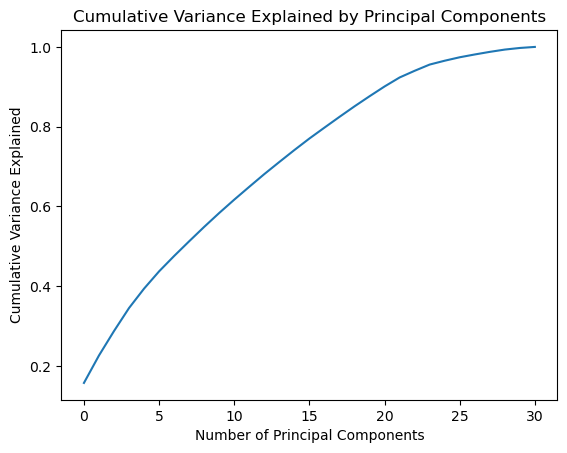

In [110]:
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))   
plt.xlabel('Number of Principal Components') 
plt.ylabel('Cumulative Variance Explained')   
plt.title('Cumulative Variance Explained by Principal Components')
plt.show()

Based on the plot above, it's evident that 25 features are adequate to capture the majority of the variance. Therefore, we will extract 25 principal components for model construction.

In [111]:
pca=PCA(n_components=25)
new_components=pca.fit_transform(X)

In [112]:
princi_comp = pd.DataFrame(new_components, columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8','PC9','PC10','PC11','PC12','PC13','PC14','PC15','PC16','PC17','PC18','PC19','PC20','PC21','PC22','PC23','PC24','PC25'])
princi_comp


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25
0,0.446968,-0.884825,-1.883983,0.670910,1.887754,1.385529,0.205536,-0.404998,-0.494094,0.457233,...,2.550805,0.917297,0.711569,-0.214454,-0.896491,-1.070655,0.822594,-0.079874,1.351490,0.421428
1,1.619598,-0.497225,2.713634,1.708542,-0.464262,0.240498,1.281814,2.000345,-0.216264,-0.330176,...,1.595145,0.860223,0.178225,-1.172476,-0.188205,-0.248437,0.572286,1.559184,0.037257,0.384318
2,-3.021210,0.835230,-0.115940,0.038976,1.971797,0.874726,-2.957330,0.526448,-1.738296,0.074539,...,0.343220,-0.475727,0.795592,-0.112775,0.754295,-0.585180,0.973559,0.027493,0.179807,0.354037
3,-0.291536,-0.971353,-0.098646,-1.304426,0.188803,1.584155,0.661191,-0.729702,-1.838713,-1.508379,...,0.220416,1.238514,-0.820415,-0.462162,1.366080,0.927670,0.749691,0.308784,-0.693301,-0.917732
4,-1.356401,1.334824,-0.411886,-0.953356,0.530733,-0.359644,-0.358701,2.195920,-0.677692,-1.345457,...,-0.271718,0.951071,-0.073310,-0.793699,-1.904592,0.585581,0.966754,-0.850131,-0.208020,0.303490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2385,-3.312164,-1.521756,-0.343070,-0.054372,0.219050,-0.031647,-0.627518,-1.613633,-1.091459,1.619096,...,0.411162,0.276265,-0.477024,0.289178,1.057231,-0.192728,-0.082202,-0.385646,0.219212,0.020932
2386,-1.781630,-1.152047,0.659269,-0.580381,0.245879,-2.062957,1.360738,-0.284478,-0.142692,0.602387,...,-0.724695,2.143235,0.500046,0.179348,-0.164697,-0.448288,-0.379203,0.284516,-0.681566,0.210564
2387,-3.321787,-1.356530,2.689222,2.608607,-0.671095,-1.026630,0.138035,-1.254411,-1.219656,-0.313941,...,0.158840,-0.190033,-0.156836,1.185810,0.145394,-0.648073,-0.167669,-0.434939,-0.036342,-0.214405
2388,-1.939303,-1.016637,2.484852,2.027015,0.054623,0.544466,-0.137769,-1.026540,-0.112445,0.404269,...,-0.251494,-0.351107,-0.801811,-0.194186,-0.434756,-0.298870,0.305553,0.392370,-0.622954,0.092899


In [113]:
princi_comp.shape

(2390, 25)

In [114]:
X=princi_comp

In [115]:
Y.shape

(2390,)

In [116]:
maxacc=0
maxrs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=i) 
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)   
    if acc>maxacc:
        maxacc=acc
        maxrs=i
print('Best accuracy is', maxacc,'at random state',maxrs) 

Best accuracy is 0.38599430661470413 at random state 174


In [117]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=maxrs)

20% of the dataset will be used for testing, and the remaining 80% for training our machine learning models

# Machine Learning Model for Classification and Evaluation Metrics

In [119]:
# Classification Model Function
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
def classify(model, X, Y):
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=maxrs)
    
    # Training the model
    model.fit(X_train, Y_train)
    
    # Predicting Y_test
    pred = model.predict(X_test)
    
    # Accuracy Score
    acc_score = (accuracy_score(Y_test, pred))*100
    print("Accuracy Score:", acc_score)
    
    # Classification Report
    class_report = classification_report(Y_test, pred)
    print("\nClassification Report:\n", class_report)
    
    #Confusion Matrix
    confusion_matx=confusion_matrix(Y_test, pred)
    print("\nConfusion Matrix:\n",confusion_matx)
    
    # Cross Validation Score
    cv_score = (cross_val_score(model, X, Y, cv=5).mean())*100
    print("\nCross Validation Score:", cv_score)
    
    # Result of accuracy minus cv scores
    result = acc_score - cv_score
    print("\nAccuracy Score - Cross Validation Score is", result)

I've created a class to handle train-test splitting, model training, label prediction, accuracy score calculation, classification report generation, cross-validation scoring,Confusion Matrix, and comparison of accuracy and cross-validation scores for any machine learning model that utilizes this function.

In [120]:
# Logistic Regression

model=LogisticRegression()
classify(model, X, Y)

Accuracy Score: 81.17154811715481

Classification Report:
               precision    recall  f1-score   support

           0       0.84      0.80      0.82       253
           1       0.79      0.82      0.80       225

    accuracy                           0.81       478
   macro avg       0.81      0.81      0.81       478
weighted avg       0.81      0.81      0.81       478


Confusion Matrix:
 [[203  50]
 [ 40 185]]

Cross Validation Score: 74.43514644351464

Accuracy Score - Cross Validation Score is 6.736401673640174


In [121]:
# Random Forest Classifier

model=RandomForestClassifier(max_depth=15, random_state=111)
classify(model, X, Y)

Accuracy Score: 93.09623430962343

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.95      0.94       253
           1       0.94      0.91      0.93       225

    accuracy                           0.93       478
   macro avg       0.93      0.93      0.93       478
weighted avg       0.93      0.93      0.93       478


Confusion Matrix:
 [[240  13]
 [ 20 205]]

Cross Validation Score: 90.79497907949792

Accuracy Score - Cross Validation Score is 2.3012552301255056


In [122]:
# Extra Trees Classifier

model=ExtraTreesClassifier()
classify(model, X, Y)

Accuracy Score: 95.60669456066945

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.98      0.96       253
           1       0.98      0.93      0.95       225

    accuracy                           0.96       478
   macro avg       0.96      0.95      0.96       478
weighted avg       0.96      0.96      0.96       478


Confusion Matrix:
 [[248   5]
 [ 16 209]]

Cross Validation Score: 95.48117154811715

Accuracy Score - Cross Validation Score is 0.12552301255230702


In [123]:
# K Neighbors Classifier

model=KNeighborsClassifier(n_neighbors=15)
classify(model, X, Y)

Accuracy Score: 75.10460251046025

Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.59      0.71       253
           1       0.67      0.93      0.78       225

    accuracy                           0.75       478
   macro avg       0.79      0.76      0.75       478
weighted avg       0.80      0.75      0.75       478


Confusion Matrix:
 [[149 104]
 [ 15 210]]

Cross Validation Score: 72.42677824267781

Accuracy Score - Cross Validation Score is 2.677824267782441


In [124]:
# Support Vector Classifier

model=SVC(C=1.0, kernel='rbf', gamma='auto', random_state=42)
classify(model, X, Y)

Accuracy Score: 93.72384937238493

Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.93      0.94       253
           1       0.93      0.94      0.93       225

    accuracy                           0.94       478
   macro avg       0.94      0.94      0.94       478
weighted avg       0.94      0.94      0.94       478


Confusion Matrix:
 [[236  17]
 [ 13 212]]

Cross Validation Score: 90.2510460251046

Accuracy Score - Cross Validation Score is 3.4728033472803332


In [125]:
# Decision Tree Classifier

model=DecisionTreeClassifier(random_state=21, max_depth=15)
classify(model, X, Y)

Accuracy Score: 79.07949790794979

Classification Report:
               precision    recall  f1-score   support

           0       0.83      0.76      0.79       253
           1       0.75      0.83      0.79       225

    accuracy                           0.79       478
   macro avg       0.79      0.79      0.79       478
weighted avg       0.79      0.79      0.79       478


Confusion Matrix:
 [[192  61]
 [ 39 186]]

Cross Validation Score: 78.24267782426777

Accuracy Score - Cross Validation Score is 0.8368200836820137


In [126]:
# XGB Classifier

model=xgb.XGBClassifier(verbosity=0)
classify(model, X, Y)

Accuracy Score: 93.51464435146444

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.93      0.94       253
           1       0.93      0.94      0.93       225

    accuracy                           0.94       478
   macro avg       0.93      0.94      0.93       478
weighted avg       0.94      0.94      0.94       478


Confusion Matrix:
 [[236  17]
 [ 14 211]]

Cross Validation Score: 91.12970711297072

Accuracy Score - Cross Validation Score is 2.3849372384937197


# AGAIN ETRA TREES CLASSIFIER IS OUR BEST MODEL BECAUSE IT HAS Diffrence between Accuracy score and cross validation score is LEAST

# Hyper parameter tuning on the best ML Model

In [127]:
# ExtraTrees Classifier
from sklearn.model_selection import GridSearchCV

param_grid ={'criterion':['gini','entropy'],
           'random_state':[10,50,1000],
           'max_depth':[0,10,20],
           'n_jobs':[-2,-1,1],
           'n_estimators':[50,100,200,300]}

In [128]:
ETC=ExtraTreesClassifier()

In [129]:
grid_search= GridSearchCV(estimator=ETC, param_grid=param_grid, cv=5)

In [130]:
grid_search.fit(X_train, Y_train)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [0, 10, 20],
                         'n_estimators': [50, 100, 200, 300],
                         'n_jobs': [-2, -1, 1],
                         'random_state': [10, 50, 1000]})

In [131]:
grid_search.best_params_

{'criterion': 'gini',
 'max_depth': 20,
 'n_estimators': 300,
 'n_jobs': -2,
 'random_state': 1000}

In [133]:
final_model_2=ExtraTreesClassifier(criterion='gini',max_depth=20,n_estimators=300,n_jobs=-2,random_state=1000)

In [134]:
final_model_2.fit(X_train,Y_train)
pred=final_model_2.predict(X_test)
acc=accuracy_score(Y_test,pred)
print(acc*100)

96.23430962343096


# Saving the model

In [135]:
import joblib

filename = "FinalModel_8.pkl"
joblib.dump(final_model_2, filename)

['FinalModel_8.pkl']

In [136]:
model=joblib.load("FinalModel_8.pkl")

prediction=model.predict(X_test)
prediction

array([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0,
       0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0,
       0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1,
       0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1,
       0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0,
       1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0,
       1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0,
       1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1,

In [137]:
a=np.array(Y_test)
df=pd.DataFrame()
df['Predicted']=prediction
df['Original']=a
df.head()

,Predicted,Original
0,0,0
1,1,1
2,0,0
3,0,0
4,0,0


In [138]:
df.tail()

,Predicted,Original
473,0,0
474,1,1
475,1,1
476,0,0
477,1,1


# Conclusion:
I have saved four models for predicting the Attrition in this dataset.

Model-I achieves an accuracy of 98% with ExtraTrees Classifier(IQR).

Model-II achieves an accuracy of 96% with ExtraTrees Classifier(Z-Score).

Model-III achieves an accuracy of 96% with ExtraTrees Classifier(PCA).
